# License Plate Detection and Modification

by Shiva Tej Soma, Xinyi Yao, Xiule Fan

## Project Introduction

As the prevalence of the video content grows, with the spread of car videos across the internet or television broadcasts, there are increasing concerns about the privacy violation toward drivers since their car license plate information can be clearly seen through these videos. There is a high need to address the above problem since protecting the vehicle license plate information and protecting the privacy and security of drivers are important. 

To address the above problem, our project aims to develop a system that can detect and modify the license plates of cars in videos so that the license plate information will not be leaked. We study this task with two milestones:

- Detect license plates from videos and blur them
- Try to replace the detected license plate with a fake one

Note that within these two milestones, the first one is our main focus. The second milestone is more like a challenge that we just want to explore for a bit. Hence, we spent more time training models for the first milestone than for the second one.

To achieve the first milestone, we first try to detect license plates from images by training YOLOv3 and YOLOv5. After training and testing these models on images, we apply them to previously unseen videos. YOLOv3 is found to predict better results on videos than YOLOv5 does. Hence, we choose YOLOv3 for further improvement by incorporating a post processing step called Seq-NMS to improve license plate detections in videos. Our final model YOLOv3 with Seq-NMS can make high-quality license plate predictions on videos. We paint the detected license plates with a solid color to hide drivers' private information. We use painting instead of blurring in this specific case because it is easier to demonstrate the results compared to blurring the detected plates. For the second milestone, we provide the solution of replacing the original license plates with the fake ones (i.e. Inpainting, diffusion) by adopting various models like GAN and diffusion models. 

The complete overview of our project is demonstrated in the diagram shown below.

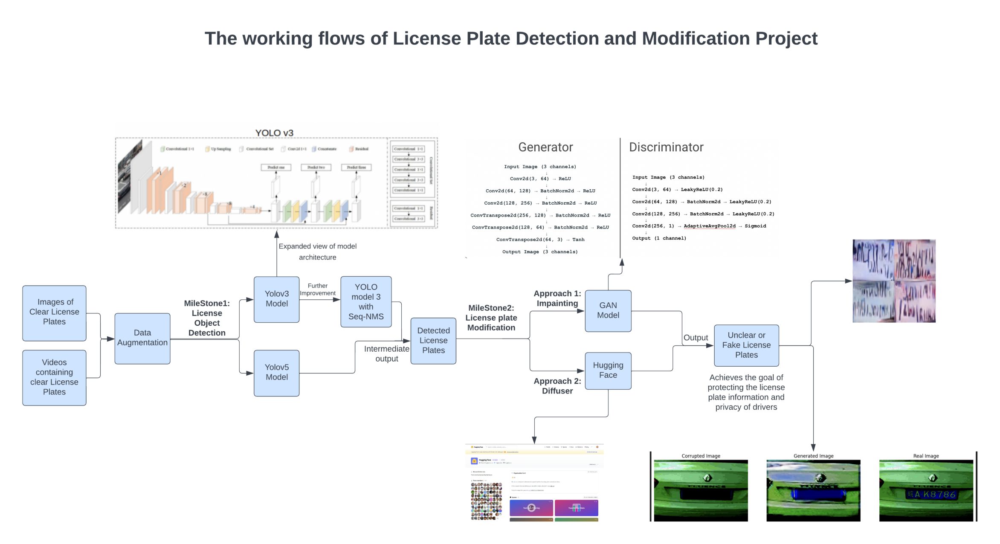

In [ ]:
import matplotlib.pyplot as plt
import cv2

train_arch = cv2.imread("./MIE1517 Diagram.png")
train_arch = cv2.cvtColor(train_arch, cv2.COLOR_BGR2RGB)

plt.figure(1, figsize=(30, 40))
plt.imshow(train_arch)
plt.axis("off")
plt.show()

### Summary of Results

Below is a summary of our findings. More detailed discussions are given in the following sections.

- Both YOLOv3 and YOLOv5 are able to accurately detect license plates given an image
- When applying YOLOv3 and YOLOv5 to videos, YOLOv5 tends to skip more predictions than YOLOv3 does
- When applying our models to vidoes, the models may predict false postive results or miss predictions from time to time
- After combining YOLOv3 with the post processing step Seq-NMS, the pipeline can make more consistent predictions across different frames in videos
- Something we noticed is that when trained on ResNet32, the generated images are more color accurate.
- Diffusion models can generate fake license plates that somehow look realistic. However, digits on these fake license plates are very hard to read

All the resulting videos can be found in the following link: [Google Drive](https://drive.google.com/drive/folders/1Fm4Rnj7Gu8G5PPf-NkJbl7OfZiacBRKR?usp=sharing)

### Summary on Related Work

License plate detection falls under the topic of object detection, which is a widely studied topic in computer vision. Some notable models include:

- RCNN ([Girshick et al., "Rich feature hierarchies for accurate object detection and semantic segmentation," CVPR, 2014](https://www.cv-foundation.org/openaccess/content_cvpr_2014/papers/Girshick_Rich_Feature_Hierarchies_2014_CVPR_paper.pdf))
- YOLO ([J. Redmon el al., "You Only Look Once: Unified, Real-Time Object Detection, " CVPR, 2016](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Redmon_You_Only_Look_CVPR_2016_paper.pdf))
- YOLOv3 ([J. Redmon and A. Farhadi, "YOLOv3: An Incremental Improvement, " arXiv, 2018](https://arxiv.org/pdf/1804.02767.pdf))
- [YOLOv5](https://github.com/ultralytics/yolov5)

We focus on YOLOv3 and YOLOv5 in this project.

For image inpainting and diffusion, we study the following references:

- Inpainting [Inpainting with AI — get back your images!](https://towardsdatascience.com/inpainting-with-ai-get-back-your-images-pytorch-a68f689128e5)
- Research Paper [Context Encoders](https://openaccess.thecvf.com/content_cvpr_2016/papers/Pathak_Context_Encoders_Feature_CVPR_2016_paper.pdf)
- Huggingface [Diffusers](https://huggingface.co/docs/diffusers/main/en/index)

### Quick Links to Datasets, Results, and Observations in the Notebook

- [Kaggle Dataset Explored](#kaggle_dataset)
- [Kaggle YOLOv5 Observations](#kaggle_dataset_observations)
- [CCPD2019 Datset Explored](#ccpd_dataset)
- [CCPD2019 YOLOv5 Observations](#ccpd_dataset_observations)
- [Inpainting using GAN](#gan)
- [Inpainting using Diffusion](#diffusion)


## YOLOv3

In this work, we first focus on using YOLOv3 to detect license plate. This model is used on two different types of data: images and videos. YOLOv3 is an object detection model. In this work, we first train it and evaluate it on a dataset with car images and ground truth bounding boxes for license plates. Then, we apply the trained YOLOv3 and a post processing step called Seq-NMS to detect plates from videos. 

The overview of this approach is given below.

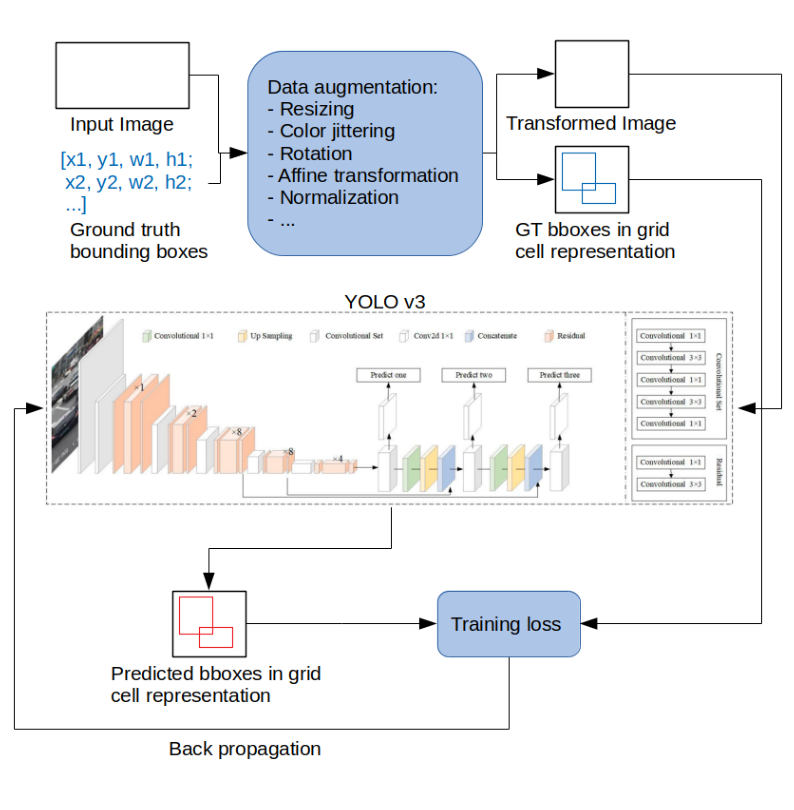

In [ ]:
import matplotlib.pyplot as plt
import cv2

train_arch = cv2.imread("../train_arch.png")
train_arch = cv2.cvtColor(train_arch, cv2.COLOR_BGR2RGB)

plt.figure(1, figsize=(10, 20))
plt.imshow(train_arch)
plt.axis("off")
plt.show()

Above is the overview of the training process. An input image and the ground truth bounding box information are first processed by data augmentation to obtain an image and bounding boxes after certain transformations. Then, the image is sent into YOLOv3 to predict bounding boxes. Both the predicted and ground truth bounding boxes are used to construct a training loss, from which back propagation is performed to train the model.

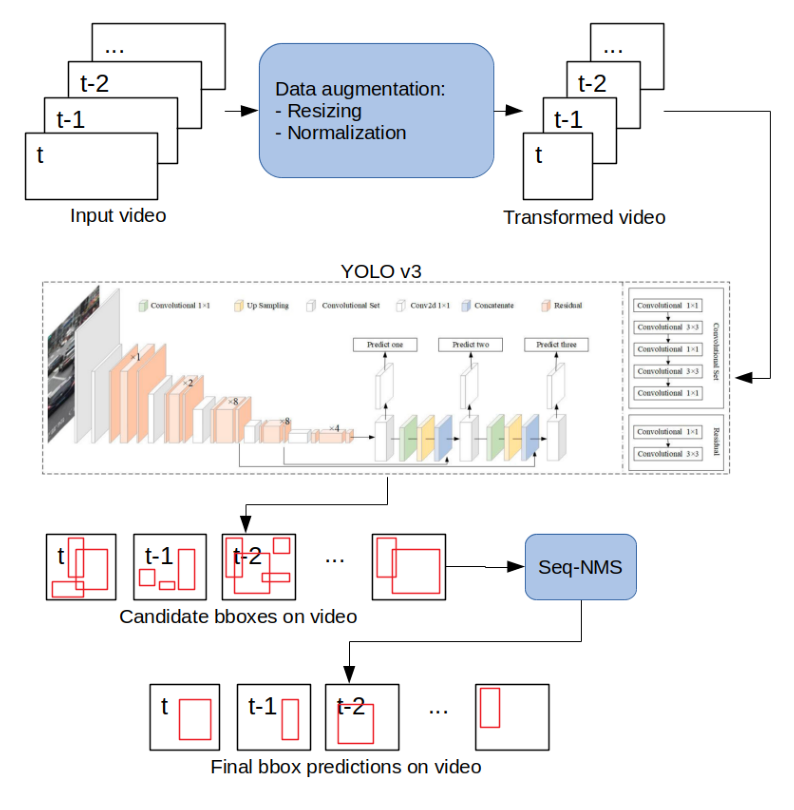

In [ ]:
video_arch = cv2.imread("../video_arch.png")
video_arch = cv2.cvtColor(video_arch, cv2.COLOR_BGR2RGB)

plt.figure(1, figsize=(10, 20))
plt.imshow(video_arch)
plt.axis("off")
plt.show()

After training YOLOv3 on images, we apply the model to videos according to the architecture shown above. More specifically, each frame from a video is transformed such that its format is consistent with YOLOv3. Then YOLOv3 makes bounding boxes predictions for different frames. All these bounding boxes are sent into a post processing module, Seq-NMS, to obtain the final bounding box prediction at different time steps.

In the following notebook, we will introduce how YOLOv3 is trained and evaluated on images and how it is then tested on videos.

### YOLOv3 for License Plate Detection on Images

YOLOv3 was originally proposed in [this paper](https://arxiv.org/abs/1804.02767).

This implementation is heavily based on [this repository](https://github.com/aladdinpersson/Machine-Learning-Collection/tree/master/ML/Pytorch/object_detection/YOLOv3). This code was transferred from Python scripts to Jupyter Notebook. The Python scripts are hosted on this [GitHub repository](https://github.com/fanxiule/YOLO3_plate_recognition.git)

**Global variables**

Some important variables that control different settings for the model.

In the original Python scripts used for training, the model was trained for 400 epochs. We set the training epoch to 3 in this notebook just to demonstrate that the code works. Later in the sections where we perform evaluation and testing, we will load the model trained for 400 epochs with Python scripts.

In [ ]:
# path settings
DATA_PATH = "./dataset"  # where training, validaiton, and test samples are stored
LOG_PATH = "./log"  # directory to save checkpoints and tensorboard events
MODEL_NAME = "yolov3_plate_detection"  # name of the model
# model settings
IMG_SZ = 416  # image size
SEED = 0  # random seed
CONF_THRES = 0.4  # threshold for the predicted confidence score
AP_IOU_THRES = 0.5  # IOU threshold when computing average precision
NMS_IOU_THRES = 0.4  # IOU threshold for non-maximum suppresion
LABEL_IOU_THRES = 0.5  # IOU threshold for loading the labels
# optimization settings
DEVICE = "cuda"  # training/evaluation device
NUM_WORKERS = 1  # number of processes for data loading
BATCH_SZ = 16  # batch size
LR = 1e-4  # learning rate
SCHEDULER_STEP = 200  # frequency in epochs for scheduler update
SCHEDULER_RATE = 0.1  # factor to update the learning rate
WEIGHT_DECAY = 5e-4  # regularization term 
NUM_EPOCHS = 3  # number of training epochs, should be 400, to save time, we set it to 3 here
# loss settings
LAMBDA_BOX = 10  # weight for bounding box loss
LAMBDA_OBJ = 6  # weight for object loss
LAMBDA_NOOBJ = 10  # weight for no object loss
# logging settings
LOG_FREQ = 1000  # frequency in epochs for logging the tensorboard events
SAVE_FREQ = 100  # frequency in epochs for saving a checkpoint, set it to 100/200 if number of epochs is 400

**Helper functions**
- Calculate IOU: compute intersection over union given two bounding boxes (bounding box may be abbreviated as `bbox` in this notebook)
- Convert grid cells to bounding box representations: YOLOv3 predicts grid cells in the form of \[N, 3, S, S, 5\], where N is the batch size, 3 is the number of candidate anchor boxes, S is the spatial size of the grid cell. The last number 5 indicates that each grid cell contains 5 pieces of information: a score indicating whether the bounding box at the current grid cell contains an object, x and y coordinates of the bounding box, and width and height information of the bounding box.
- Non maximum suppression (an important step in YOLOv3) for removing redundant bounding box predictions: this algorithm keeps the bounding boxes with the highest confidence score and remove candidate bounding boxes with higher IOU (i.e., overlaps) with the former boxes.
- Obtain predictions from YOLOv3 by using specified data
- Calculate average precision: average precision is a commonly used evaluation metric in object detection. It is essentially the area under the precision-recall curve

In [ ]:
import time
import torch

from collections import Counter


def iou_width_height(boxes1, boxes2):
    """
    Parameters:
        boxes1 (tensor): width and height of the first bounding boxes
        boxes2 (tensor): width and height of the second bounding boxes
    Returns:
        tensor: Intersection over union of the corresponding boxes
    """
    intersection = torch.min(boxes1[..., 0], boxes2[..., 0]) * torch.min(
        boxes1[..., 1], boxes2[..., 1]
    )
    union = (
            boxes1[..., 0] * boxes1[..., 1] + boxes2[..., 0] * boxes2[..., 1] - intersection
    )
    return intersection / union


def intersection_over_union(boxes_preds, boxes_labels, box_format="midpoint"):
    """
    Video explanation of this function:
    https://youtu.be/XXYG5ZWtjj0

    This function calculates intersection over union (iou) given pred boxes
    and target boxes.

    Parameters:
        boxes_preds (tensor): Predictions of Bounding Boxes (BATCH_SIZE, 4)
        boxes_labels (tensor): Correct labels of Bounding Boxes (BATCH_SIZE, 4)
        box_format (str): midpoint/corners, if boxes (x,y,w,h) or (x1,y1,x2,y2)

    Returns:
        tensor: Intersection over union for all examples
    """

    if box_format == "midpoint":
        box1_x1 = boxes_preds[..., 0:1] - boxes_preds[..., 2:3] / 2
        box1_y1 = boxes_preds[..., 1:2] - boxes_preds[..., 3:4] / 2
        box1_x2 = boxes_preds[..., 0:1] + boxes_preds[..., 2:3] / 2
        box1_y2 = boxes_preds[..., 1:2] + boxes_preds[..., 3:4] / 2
        box2_x1 = boxes_labels[..., 0:1] - boxes_labels[..., 2:3] / 2
        box2_y1 = boxes_labels[..., 1:2] - boxes_labels[..., 3:4] / 2
        box2_x2 = boxes_labels[..., 0:1] + boxes_labels[..., 2:3] / 2
        box2_y2 = boxes_labels[..., 1:2] + boxes_labels[..., 3:4] / 2

    elif box_format == "corners":
        box1_x1 = boxes_preds[..., 0:1]
        box1_y1 = boxes_preds[..., 1:2]
        box1_x2 = boxes_preds[..., 2:3]
        box1_y2 = boxes_preds[..., 3:4]
        box2_x1 = boxes_labels[..., 0:1]
        box2_y1 = boxes_labels[..., 1:2]
        box2_x2 = boxes_labels[..., 2:3]
        box2_y2 = boxes_labels[..., 3:4]

    else:
        print("Invalid box format")
        raise RuntimeError

    x1 = torch.max(box1_x1, box2_x1)
    y1 = torch.max(box1_y1, box2_y1)
    x2 = torch.min(box1_x2, box2_x2)
    y2 = torch.min(box1_y2, box2_y2)

    intersection = (x2 - x1).clamp(0) * (y2 - y1).clamp(0)
    box1_area = abs((box1_x2 - box1_x1) * (box1_y2 - box1_y1))
    box2_area = abs((box2_x2 - box2_x1) * (box2_y2 - box2_y1))

    return intersection / (box1_area + box2_area - intersection + 1e-6)


def cells_to_bboxes(predictions, anchors, S, is_preds=True):
    """
    convert the predicted grid cells from the model to bounding box format
    INPUT:
    predictions: tensor of size (N, 3, S, S, 5), N-batch size, S-feature size
    anchors: anchor box sizes
    S: the number of cells the image is divided in on the width (and height)
    is_preds: whether the input is predictions or the true grid cells, 
              different processing steps are needed for each case
    OUTPUT:
    converted_bboxes: the converted boxes of sizes (N, num_anchors * S * S, 5) with class index,
                      object score, bounding box coordinates
    """
    BATCH_SIZE = predictions.shape[0]
    num_anchors = len(anchors)
    box_predictions = predictions[..., 1:5]
    if is_preds:
        # if the grid cells are predictions from the model
        anchors = anchors.reshape(1, len(anchors), 1, 1, 2)
        # the following conversion is only needed for predicted grid cells
        box_predictions[..., 0:2] = torch.sigmoid(box_predictions[..., 0:2])  # for box coordinate
        # this box coordinate is relative to the closest cell index, e.g., if the predicted bounding box
        # is locatedat (5.2, 6.3), the coordinate predictions from the model (after sigmoid) should be 
        # (0.2, 0.3)
        box_predictions[..., 2:] = torch.exp(box_predictions[..., 2:]) * anchors  # for box size
        scores = torch.sigmoid(predictions[..., 0:1])  # confidence score
    else:
        scores = predictions[..., 0:1]
    
    cell_indices = (torch.arange(S).repeat(predictions.shape[0], 3, S, 1).unsqueeze(-1).to(predictions.device))
    # convert the box coordinate (relative to the closest cell index) to the absolute coordinate
    # then divide it by the size of the grid cells so that the coordinate is [0, 1]
    x = 1 / S * (box_predictions[..., 0:1] + cell_indices)
    y = 1 / S * (box_predictions[..., 1:2] + cell_indices.permute(0, 1, 3, 2, 4))
    # convert width and height to be relative to the size of the grid cells
    w_h = 1 / S * box_predictions[..., 2:4]
    converted_bboxes = torch.cat((scores, x, y, w_h), dim=-1).reshape(BATCH_SIZE, num_anchors * S * S, 5)
    return converted_bboxes.tolist()


def non_max_suppression(bboxes, iou_threshold, threshold, box_format="corners"):
    """
    Video explanation of this function:
    https://youtu.be/YDkjWEN8jNA

    Does Non Max Suppression given bboxes

    Parameters:
        bboxes (list): list of lists containing all bboxes with each bboxes
        specified as either [prob_score, x1, y1, x2, y2] or [prob_score, x, y, w, h]
        iou_threshold (float): if two bounding boxes have an IOU higher than this threshold,
        the box with lower confidence is removed
        threshold (float): confidence score threshold, if a candidate bounding box has a confidence score
        lower than this threshold, remove this threshold from the final predicitons
        box_format (str): "midpoint" or "corners" used to specify bboxes format

    Returns:
        list: bboxes after performing NMS given a specific IoU threshold
    """

    assert type(bboxes) == list
    
    # only keep bounding boxes with a confidence score higher than the confidence threshold
    bboxes = [box for box in bboxes if box[0] > threshold]
    # sort bboxes according to the confidence
    bboxes = sorted(bboxes, key=lambda x: x[0], reverse=True)
    bboxes_after_nms = []

    while bboxes:
        # start from the bounding box with the highest confidence score
        chosen_box = bboxes.pop(0)
        # from the rest of bounding boxes, only keep the ones whose IOU with the current box of interest
        # (chosen_box) is lower than the threshold
        bboxes = [box for box in bboxes if intersection_over_union(torch.tensor(chosen_box[1:]), torch.tensor(box[1:]),
                                                                   box_format=box_format) < iou_threshold]
        
        bboxes_after_nms.append(chosen_box)

    return bboxes_after_nms


def get_eval_pred(loader, model, conf_thres, nms_iou_thres, norm_anchors, box_format="midpoint", device="cuda"):
    """
    evaluate a model and get results relevant to this evaluation
    
    loader: dataloader for the evaluation data
    model: YOLOv3 model
    conf_thres: confidence threshold for NMS
    nms_iou_thres: IOU threshold for NMS
    norm_anchors: anchor box sizes normalized by the input image size
    box_format: "midpoint" or "corners" used to specify bboxes format
    device: evaluation device, "cuda" or "cpu"
    """
    model.eval()
    total_time = 0
    sample_idx = 0
    all_pred_boxes = []
    all_true_boxes = []
    tot_noobj, correct_noobj = 0, 0
    tot_obj, correct_obj = 0, 0

    for batch_idx, (imgs, labels) in enumerate(loader):
        imgs = imgs.to(device)
        with torch.no_grad():
            start_time = time.time()
            predictions = model(imgs)

        for i in range(3):
            labels[i] = labels[i].to(device)
            # identify which ground truth grid cells contain an object and which don't
            obj = labels[i][..., 0] == 1
            noobj = labels[i][..., 0] == 0

            obj_preds = torch.sigmoid(predictions[i][..., 0]) > conf_thres
            # grid cells that have been correctly classified to have an object
            correct_obj += torch.sum(obj_preds[obj] == labels[i][..., 0][obj])
            tot_obj += torch.sum(obj)
            # grid cells that have been correctly classified to not have an object
            correct_noobj += torch.sum(obj_preds[noobj] == labels[i][..., 0][noobj])
            tot_noobj += torch.sum(noobj)

        batch_size = imgs.shape[0]
        bboxes = [[] for _ in range(batch_size)]
        for i in range(3):
            S = predictions[i].shape[2]
            anchor = torch.tensor([*norm_anchors[i]]).to(device) * S
            # convert the predicted grid cells to bounding box format
            boxes_scale_i = cells_to_bboxes(predictions[i], anchor, S=S, is_preds=True)
            for idx, (box) in enumerate(boxes_scale_i):
                bboxes[idx] += box
        
        # convert the ground truth grid cells to bounding box format
        # we just want one bbox for each label, not one for each scale
        true_bboxes = cells_to_bboxes(labels[2], anchor, S=S, is_preds=False)
        
        # perform non maximum suppression
        for idx in range(batch_size):
            nms_boxes = non_max_suppression(
                bboxes[idx],
                iou_threshold=nms_iou_thres,
                threshold=conf_thres,
                box_format=box_format,
            )
            
            # append the sample id with each bounding boxes
            for nms_box in nms_boxes:
                all_pred_boxes.append([sample_idx] + nms_box)

            for box in true_bboxes[idx]:
                if box[0] > conf_thres:
                    all_true_boxes.append([sample_idx] + box)
            sample_idx += 1
        total_time = total_time + (time.time() - start_time)
    
    # return all predicted bounding boxes, all ground truth bounding boxes, total number of predicted 
    # grid cells with no objects, total number of ground truth grid cells with no objects, total number
    # of predicted grid cells with an object, total number of ground truth grid cells with an object,
    # and the total evaluation time
    return all_pred_boxes, all_true_boxes, tot_noobj, correct_noobj, tot_obj, correct_obj, total_time


def average_precision(pred_boxes, true_boxes, iou_threshold=0.5, box_format="midpoint"):
    """
    Video explanation of this function:
    https://youtu.be/FppOzcDvaDI

    This function calculates average precision (AP), which is essentially the AUC of the precision-recall curve

    Parameters:
        pred_boxes (list): list containing all bboxes with each bboxes
        specified as [sample_id, prob_score, x1, y1, x2, y2] or [sample_id, prob_score, x, y, w, h]
        true_boxes (list): Similar as pred_boxes except all the ground truth ones
        iou_threshold (float): if the IOU between a predicted bbox and a ground truth bbox exceeds this
        threshold, we consider the predicted bbox to be correct
        box_format (str): "midpoint" or "corners" used to specify bboxes

    Returns:
        float: AP value given a specific IoU threshold
    """

    # used for numerical stability later on
    epsilon = 1e-6
    
    detections = pred_boxes
    ground_truths = true_boxes
    gt_box = len(true_boxes)

    # find the number of ground truth bboxes for each image sample
    # Counter here finds how many ground truth bboxes we get
    # for each training example, so let's say img 0 has 3,
    # img 1 has 5 then we will obtain a dictionary with:
    # amount_bboxes = {0:3, 1:5}
    amount_bboxes = Counter([gt[0] for gt in ground_truths])

    # We then go through each key, val in this dictionary
    # and convert the value to the following:
    # ammount_bboxes = {0:torch.tensor[0,0,0], 1:torch.tensor[0,0,0,0,0]}
    for key, val in amount_bboxes.items():
        amount_bboxes[key] = torch.zeros(val)

    # sort predicted bbox by box probabilities which is at index 1
    detections.sort(key=lambda x: x[1], reverse=True)
    # for storing if a predicted bbox is true positive or false positive
    TP = torch.zeros((len(detections)))
    FP = torch.zeros((len(detections)))
    total_true_bboxes = len(ground_truths)

    for detection_idx, detection in enumerate(detections):
        # Only take out the ground_truths that have the same
        # sample id as detection
        ground_truth_img = [
            bbox for bbox in ground_truths if bbox[0] == detection[0]
        ]
        best_iou = 0

        for idx, gt in enumerate(ground_truth_img):
            # calculate IOU between predicted bbox and ground truth bbox
            iou = intersection_over_union(
                torch.tensor(detection[2:]),
                torch.tensor(gt[2:]),
                box_format=box_format,
            )
            # compare if the computed IOU is better than the best IOU on record
            if iou > best_iou:
                best_iou = iou
                best_gt_idx = idx
        
        if best_iou > iou_threshold:
            # if no predicted bbox has been assigned to the gt bbox of interest yet
            if amount_bboxes[detection[0]][best_gt_idx] == 0:
                # the predicted bbox is true positive
                TP[detection_idx] = 1
                # indicate the gt bbox of interest has a corresponding prediction
                amount_bboxes[detection[0]][best_gt_idx] = 1
            else:
                # if the gt bbox of interest already has a corresponding prediction
                # the predicted bbox is false positive
                FP[detection_idx] = 1

        # if IOU is lower than the thrshold then the detection is a false positive
        else:
            FP[detection_idx] = 1
    
    # since we sorted the predicted bbox according to their confidence score previously,
    # the cumsum of TP and FP will give us the TP and FP information at different confidence 
    # levels
    TP_cumsum = torch.cumsum(TP, dim=0)
    FP_cumsum = torch.cumsum(FP, dim=0)
    # total number of tp and fp boxes
    tp_box = torch.sum(TP)
    fp_box = torch.sum(FP)
    # recall and precision at different confidence levels
    recalls = TP_cumsum / (total_true_bboxes + epsilon)
    precisions = TP_cumsum / (TP_cumsum + FP_cumsum + epsilon)
    # include [0, 1] which is at the end of the precision-recall curve
    precisions = torch.cat((torch.tensor([1]), precisions))
    recalls = torch.cat((torch.tensor([0]), recalls))
    # torch.trapz for numerical integration of the precision-recall curve
    average_precision = torch.trapz(precisions, recalls)
    
    # return AP, total number of GT, TP, and FP bbox
    return average_precision, gt_box, tp_box, fp_box

**Dataset class**

The dataset can be downloaded from [here](https://drive.google.com/file/d/1Qw21wZUm64NyU8qQvwiA1Y6jVTR1yjRz/view?usp=share_link). There are 678 training images, 70 validation images, and 35 test images in total. This datset is obtained from [kaggle](https://www.kaggle.com/datasets/andrewmvd/car-plate-detection) and [roboflow](https://public.roboflow.com/object-detection/license-plates-us-eu). The files and dataset should be organized in the following way:
```
./
|-- this notebook
|-- dataset/
|   |-- archive/
|   |-- License Plates.v3-original-license-plates.voc/
|   |-- test.txt
|   |-- train.txt
|   |-- train_val.txt
|   |-- val.txt
```

The dataset class can load data from the training set, validation set, test set and preprocess data accordingly. You can also let this class return only a few samples for sanity check. Since the size of our training dataset is quite small, we employ lots of data augmentation techniques during training, including random cropping, color jittering, random rotation, affine transformation, etc. These techniques can help us get more training images from the limited training set. During evaluation, we only change the size of the input image so that it is consistent with the model's settings.

In [ ]:
import os
import cv2
import numpy as np
import albumentations as A
import xml.etree.ElementTree as ET

from PIL import Image
from torch.utils.data import Dataset
from albumentations.pytorch import ToTensorV2


class LicensePlateDataset(Dataset):
    def __init__(self, data_path, dataset_status, norm_anchors, img_size, down_sz, ignore_iou_thres, sanity=False):
        """
        Dataset class

        Parameters:
            data_path: path to the dataset
            dataset_status: idicates which dataset split to load, 0->train.txt, 1->val.txt, 2->text.txt, 3->train_val.txt
            norm_anchors: normalized size for anchor boxes
            img_size: size of the output image
            down_sz: downampling factor at each stage of the model
            ignore_iou_thres: iou threshold to ignore overlapping bounding boxes
            sanity: if set to True, the dataset class only returns four images to perform sanity check
        """
        super(LicensePlateDataset, self).__init__()
        self.data_path = data_path
        self.ignore_iou_thres = ignore_iou_thres
        # YOLOv3 predicts grid cells at three stages (1/32, 1/16, 1/8 of the original image resolution)
        # self.feat_sz shoul be a list of [img_sz / 32, img_sz / 16, img_sz / 8]
        self.feat_sz = [img_size // down_sz[0], img_size // down_sz[1], img_size // down_sz[2]]
        self.norm_anchors = torch.tensor(norm_anchors[0] + norm_anchors[1] + norm_anchors[2])
        self.num_anchors = self.norm_anchors.shape[0]
        self.num_anchors_per_scale = self.num_anchors // len(norm_anchors)

        if dataset_status == 0 or dataset_status == 3:
            # 0 -> training, 1 -> validation, 2 -> testing, 3 -> training + validation
            if dataset_status == 0:
                with open(os.path.join(data_path, "train.txt")) as f:
                    self.data_list = f.readlines()
            else:
                with open(os.path.join(data_path, "train_val.txt")) as f:
                    self.data_list = f.readlines()
            if sanity:
                # only perform basic preprocessing when we do sanity check
                self.transforms = A.Compose(
                    [A.LongestMaxSize(max_size=img_size),
                     A.PadIfNeeded(min_height=img_size, min_width=img_size, border_mode=cv2.BORDER_CONSTANT),
                     A.Normalize(),
                     ToTensorV2()],
                    bbox_params=A.BboxParams(format='yolo', min_visibility=0.4, label_fields=[])
                )
            else:
                scale = 1.1
                # data augmentation when traning only the full traning set or train+val set
                self.transforms = A.Compose(
                    [A.LongestMaxSize(max_size=int(img_size * scale)),
                     A.PadIfNeeded(min_height=int(img_size * scale), min_width=int(img_size * scale),
                                   border_mode=cv2.BORDER_CONSTANT),
                     A.RandomCrop(width=img_size, height=img_size),
                     A.ColorJitter(brightness=0.6, contrast=0.6, saturation=0.6, hue=0.6, p=0.4),
                     A.OneOf([A.ShiftScaleRotate(rotate_limit=20, p=0.5, border_mode=cv2.BORDER_CONSTANT),
                              A.Affine(shear=15, p=0.5, mode=cv2.BORDER_CONSTANT), ], p=1.0),
                     A.Blur(p=0.1),
                     A.CLAHE(p=0.1),
                     A.Posterize(p=0.1),
                     A.ToGray(p=0.1),
                     A.ChannelShuffle(p=0.05),
                     A.Normalize(), ToTensorV2()],
                    bbox_params=A.BboxParams(format='yolo', min_visibility=0.4, label_fields=[])
                )
        elif dataset_status == 1:
            with open(os.path.join(data_path, "val.txt")) as f:
                self.data_list = f.readlines()
            # basic preprocessing for validation
            self.transforms = A.Compose(
                [A.LongestMaxSize(max_size=img_size),
                 A.PadIfNeeded(min_height=img_size, min_width=img_size, border_mode=cv2.BORDER_CONSTANT),
                 A.Normalize(), ToTensorV2()],
                bbox_params=A.BboxParams(format='yolo', min_visibility=0.4, label_fields=[])
            )
        else:
            with open(os.path.join(data_path, "test.txt")) as f:
                self.data_list = f.readlines()
            # basic preprocessing for testing
            self.transforms = A.Compose(
                [A.LongestMaxSize(max_size=img_size),
                 A.PadIfNeeded(min_height=img_size, min_width=img_size, border_mode=cv2.BORDER_CONSTANT),
                 A.Normalize(), ToTensorV2()],
                bbox_params=A.BboxParams(format='yolo', min_visibility=0.4, label_fields=[])
            )

        self.data_list = [data.strip("\n") for data in self.data_list]
        self.data_list.sort()
        # only keep the first four images for sanity check
        if sanity:
            self.data_list = self.data_list[0:4]

    def __len__(self):
        return len(self.data_list)

    def __getitem__(self, item):
        entry = self.data_list[item]
        img_file, annotation_file = entry.split(", ")
        
        # read the image
        image = np.array(Image.open(img_file).convert("RGB"))
        img_h, img_w, _ = np.shape(image)
        # process the xml file to get ground truth bbox information
        annotation = ET.parse(annotation_file)
        annotation_root = annotation.getroot()
        objs = annotation_root.findall("object")
        bboxes = []
        for obj in objs:
            obj_name = obj.find("name")
            if obj_name.text == "licence" or obj_name.text == "license-plate":
                # find bounding box information
                bndbox = obj.find("bndbox")
                # in xml, the x and y coordinates of two corners of the bounding box are given
                # transform these to the x y coordinates of the box center and height and width
                xmin = np.maximum(int(bndbox.find("xmin").text) - 1, 0)
                ymin = np.maximum(int(bndbox.find("ymin").text) - 1, 0)
                xmax = int(bndbox.find("xmax").text) - 1
                ymax = int(bndbox.find("ymax").text) - 1
                x_center = (xmax + xmin) / 2
                y_center = (ymax + ymin) / 2
                width = xmax - xmin
                height = ymax - ymin
                # normalize x, y, h, w by the image size
                bbox = np.array(([x_center / img_w, y_center / img_h, width / img_w, height / img_h]))
                bboxes.append(bbox)

        if len(bboxes) == 0:
            # if an image does not have bounding boxes, raise error
            print("No bounding boxes found for %s" % img_file)
            raise RuntimeError
        
        # pre-processing/data augmentation
        augmentations = self.transforms(image=image, bboxes=bboxes)
        image = augmentations["image"]
        bboxes = augmentations["bboxes"]

        # Below assumes that YOLOv3 makes predictions at 3 scaless (as per paper) and same num of anchors per scale
        # targets store the bounding box information at different scale with respect to different anchor boxes
        targets = [torch.zeros((self.num_anchors // self.num_anchors_per_scale, sz, sz, 5)) for sz in self.feat_sz]
        for box in bboxes:
            # calculate iou between the bouding box and each pre-defined anchor boxes
            # there are three anchor boxes for each scale and three scales in total
            iou_anchors = iou_width_height(torch.tensor(box[2:4]), self.norm_anchors)
            # sort the anchors according to the IOU between them and the bbox of interest
            anchor_indices = iou_anchors.argsort(descending=True, dim=0)
            x, y, width, height = box
            has_anchor = [False] * 3  # each scale should have one anchor corresponding to the bbox of interest
            # organize the ground truth information into the format of grid cells
            for anchor_idx in anchor_indices:
                scale_idx = torch.div(anchor_idx, self.num_anchors_per_scale, rounding_mode="floor")
                anchor_on_scale = anchor_idx % self.num_anchors_per_scale
                sz = self.feat_sz[scale_idx]
                i, j = int(sz * y), int(sz * x)  # identify which cell should contain the bbox
                # identify if a grid cell has been taken
                anchor_taken = targets[scale_idx][anchor_on_scale, i, j, 0]
                if not anchor_taken and not has_anchor[scale_idx]:
                    # set the grid cell to be taken
                    targets[scale_idx][anchor_on_scale, i, j, 0] = 1
                    # x, y coordinates are with respect to the grid cell id
                    x_cell, y_cell = sz * x - j, sz * y - i  # both between [0,1]
                    width_cell, height_cell = (width * sz, height * sz,)
                    box_coordinates = torch.tensor([x_cell, y_cell, width_cell, height_cell])
                    targets[scale_idx][anchor_on_scale, i, j, 1:5] = box_coordinates
                    # indicate that the ground truth label bbox been assigned to one of the scales
                    has_anchor[scale_idx] = True
                elif not anchor_taken and iou_anchors[anchor_idx] > self.ignore_iou_thres:
                    # if the anchor of interest and bbox of interest has high IOU and the current scale already
                    # has a ground truth anchor, ignore prediction with respect to this anchor
                    targets[scale_idx][anchor_on_scale, i, j, 0] = -1 
        return image, tuple(targets)

**Show some a sample image from the dataset**

In [ ]:
norm_anchors = []
anchors = [[(116, 90), (156, 198), (373, 326)],
            [(30, 61), (62, 45), (59, 119)],
            [(10, 13), (16, 30), (33, 23)]]
# normalize the anchor box size by the image size
for scale in range(len(anchors)):
    norm_anchors_at_scale = []
    for anchor in range(len(anchors[scale])):
        norm_anchor = [anchors[scale][anchor][0] / IMG_SZ,
                       anchors[scale][anchor][1] / IMG_SZ]
        norm_anchors_at_scale.append(norm_anchor)
    norm_anchors.append(norm_anchors_at_scale)
            
dummy_dataset = LicensePlateDataset(DATA_PATH, 1, norm_anchors, IMG_SZ, [32, 16, 8], LABEL_IOU_THRES)
print("Total number of validation images: ", len(dummy_dataset))

Total number of validation images:  70


In [ ]:
dummy_img, dummy_gridcell = dummy_dataset.__getitem__(7)
dummy_S = dummy_gridcell[2].size()[2]
dummy_anchor = torch.tensor([*norm_anchors[2]]) * dummy_S
dummy_bboxes = cells_to_bboxes(torch.unsqueeze(dummy_gridcell[2], dim=0), dummy_anchor, S=dummy_S, is_preds=False)
dummy_bboxes = dummy_bboxes[0]
dummy_bbox = [bbox for bbox in dummy_bboxes if bbox[0] == 1]

In [ ]:
import torchvision.transforms as transforms

# to undo imagenet normalization of the image
inv_normalize = transforms.Normalize(
             mean=[-0.485 / 0.229, -0.456 / 0.224, -0.406 / 0.225],
             std=[1 / 0.229, 1 / 0.224, 1 / 0.225])
dummy_img = inv_normalize(torch.unsqueeze(dummy_img, dim=0))
dummy_img = dummy_img.squeeze().numpy()
dummy_img = 255 * np.transpose(dummy_img, (1, 2, 0))
dummy_img = dummy_img.astype(np.uint8)
for i in range(len(dummy_bbox)):
    x1 = (dummy_bbox[i][1] - dummy_bbox[i][3] / 2) * IMG_SZ
    y1 = (dummy_bbox[i][2] - dummy_bbox[i][4] / 2) * IMG_SZ    
    x2 = (dummy_bbox[i][1] + dummy_bbox[i][3] / 2) * IMG_SZ    
    y2 = (dummy_bbox[i][2] + dummy_bbox[i][4] / 2) * IMG_SZ    
    cv2.rectangle(dummy_img, (int(x1), int(y1)), (int(x2), int(y2)), (255, 0, 255), 2)

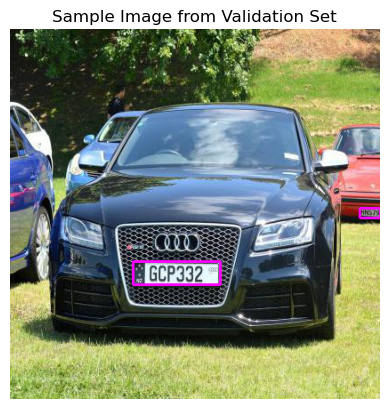

In [ ]:
import matplotlib.pyplot as plt

plt.figure(1)
plt.imshow(dummy_img)
plt.axis("off")
plt.title("Sample Image from Validation Set")
plt.show()

**YOLO model**

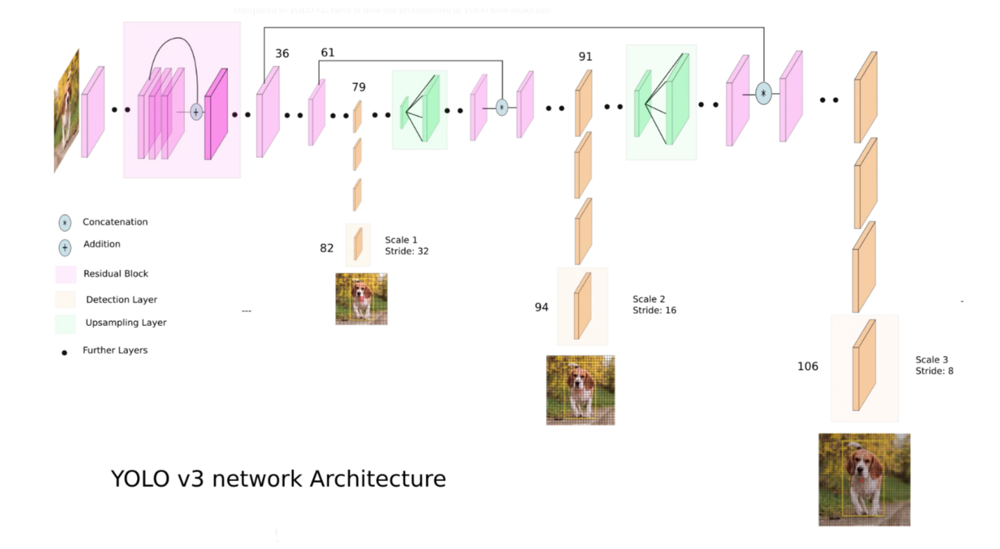

In [ ]:
import matplotlib.pyplot as plt
import cv2

yolov3_arch = cv2.imread("../yolov3.png")
yolov3_arch = cv2.cvtColor(yolov3_arch, cv2.COLOR_BGR2RGB)

plt.figure(1, figsize=(20, 10))
plt.imshow(yolov3_arch)
plt.axis("off")
plt.show()

The structure of YOLOv3 is shown above. The model receives an RGB image as an input. It then processes his image with multiple 2D conv layers and residual blocks. Then the image features are gradually upsampled. From these upsampled features, the candidate bounding boxes are predicted. In total, predictions are obtained at three different scales.

In [ ]:
import torch.nn as nn


""" 
Information about architecture config:
Tuple is structured by (filters, kernel_size, stride) to represent convolution 
List is structured by "B" indicating a residual block followed by the number of repeats
"S" is for scale prediction block and computing the yolo loss
"U" is for upsampling the feature map and concatenating with a previous layer
"""
config = [
    (32, 3, 1),
    (64, 3, 2),
    ["B", 1],
    (128, 3, 2),
    ["B", 2],
    (256, 3, 2),
    ["B", 8],
    (512, 3, 2),
    ["B", 8],
    (1024, 3, 2),
    ["B", 4],  # To this point is Darknet-53
    (512, 1, 1),
    (1024, 3, 1),
    "S",
    (256, 1, 1),
    "U",
    (256, 1, 1),
    (512, 3, 1),
    "S",
    (128, 1, 1),
    "U",
    (128, 1, 1),
    (256, 3, 1),
    "S",
]


# building blocks for building the model
# conv + batch norm + leaky relu
class CNNBlock(nn.Module):
    def __init__(self, in_channels, out_channels, bn_act=True, **kwargs):
        super().__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, bias=not bn_act, **kwargs)
        self.bn = nn.BatchNorm2d(out_channels)
        self.leaky = nn.LeakyReLU(0.1)
        self.use_bn_act = bn_act

    def forward(self, x):
        if self.use_bn_act:
            return self.leaky(self.bn(self.conv(x)))
        else:
            return self.conv(x)


# residual block
class ResidualBlock(nn.Module):
    def __init__(self, channels, use_residual=True, num_repeats=1):
        super().__init__()
        self.layers = nn.ModuleList()
        for repeat in range(num_repeats):
            self.layers += [
                nn.Sequential(
                    CNNBlock(channels, channels // 2, kernel_size=1),
                    CNNBlock(channels // 2, channels, kernel_size=3, padding=1),
                )
            ]

        self.use_residual = use_residual
        self.num_repeats = num_repeats

    def forward(self, x):
        for layer in self.layers:
            if self.use_residual:
                x = x + layer(x)
            else:
                x = layer(x)

        return x


# layers for making predictions
class ScalePrediction(nn.Module):
    def __init__(self, in_channels):
        super().__init__()
        self.pred = nn.Sequential(
            CNNBlock(in_channels, 2 * in_channels, kernel_size=3, padding=1),
            CNNBlock(
                2 * in_channels, 5 * 3, bn_act=False, kernel_size=1
            ),
        )

    def forward(self, x):
        return (
            self.pred(x)
                .reshape(x.shape[0], 3, 5, x.shape[2], x.shape[3])
                .permute(0, 1, 3, 4, 2)
        )


class YOLOv3(nn.Module):
    def __init__(self, in_channels=3):
        super().__init__()
        self.in_channels = in_channels
        self.layers = self._create_conv_layers()

    def forward(self, x):
        outputs = []  # for each scale
        route_connections = []
        for layer in self.layers:
            if isinstance(layer, ScalePrediction):
                outputs.append(layer(x))
                continue

            x = layer(x)

            if isinstance(layer, ResidualBlock) and layer.num_repeats == 8:
                route_connections.append(x)

            elif isinstance(layer, nn.Upsample):
                x = torch.cat([x, route_connections[-1]], dim=1)
                route_connections.pop()

        return outputs

    def _create_conv_layers(self):
        layers = nn.ModuleList()
        in_channels = self.in_channels
        
        # use config to build a model
        for module in config:
            if isinstance(module, tuple):
                out_channels, kernel_size, stride = module
                layers.append(
                    CNNBlock(
                        in_channels,
                        out_channels,
                        kernel_size=kernel_size,
                        stride=stride,
                        padding=1 if kernel_size == 3 else 0,
                    )
                )
                in_channels = out_channels

            elif isinstance(module, list):
                num_repeats = module[1]
                layers.append(ResidualBlock(in_channels, num_repeats=num_repeats, ))

            elif isinstance(module, str):
                if module == "S":
                    layers += [
                        ResidualBlock(in_channels, use_residual=False, num_repeats=1),
                        CNNBlock(in_channels, in_channels // 2, kernel_size=1),
                        ScalePrediction(in_channels // 2),
                    ]
                    in_channels = in_channels // 2

                elif module == "U":
                    layers.append(nn.Upsample(scale_factor=2), )
                    in_channels = in_channels * 3

        return layers

    @staticmethod
    def _weight_init(m):
        """
        Initialize a layer's weight according to normal distribution and its bias terms with zeros
        :param m: a layer in tensor form
        :return: None
        """
        if isinstance(m, nn.Conv2d):
            torch.nn.init.normal_(m.weight, 0, 0.01)
            if m.bias is not None:
                torch.nn.init.zeros_(m.bias)

    def init_model(self):
        self.layers.apply(self._weight_init)
        print("Model weights have been initialized randomly")

Verify the model is working with a dummy input

In [ ]:
dummy_model = YOLOv3(3)
dummy_img = torch.randn((1, 3, IMG_SZ, IMG_SZ))
dummy_output = dummy_model(dummy_img)

In [ ]:
print("Size of image input: ", dummy_img.shape)
print("Size of grid cell outputs (3 different scales): ")
print(dummy_output[0].shape)
print(dummy_output[1].shape)
print(dummy_output[2].shape)

Size of image input:  torch.Size([1, 3, 416, 416])
Size of grid cell outputs (3 different scales): 
torch.Size([1, 3, 13, 13, 5])
torch.Size([1, 3, 26, 26, 5])
torch.Size([1, 3, 52, 52, 5])


The input image size follows batch x 3 RGB channels x height x width.

There are grid cell outputs at 3 different scales. The follow the following format: batch x number of anchor boxes at each scale (3) x height of the grid cells x width of the grid cells x dimension of each cell (5). The last dimension is 5, which means each grid cell contains 5 different numbers: confidence score that a bbox is present, coordinates for the possible bbox at this cell, and the height and width of the bbox.

**Training Loss**

The YOLO training loss has multiple components. Here, we only use three components. The fourth one (cross entrypy loss for multi-class classification) is discarded since we only have one class and the the multiclass loss is unnecessary here. The components we consider are
- Object loss to help the model predict an object
- No object loss to help the model suppress detections at area with no objects
- Boudning box loss to help the model predict the correct bounding box geometry

In [ ]:
class YoloLoss(nn.Module):
    def __init__(self, lambda_box=10, lambda_obj=1, lambda_noobj=10):
        super(YoloLoss, self).__init__()
        self.mse = nn.MSELoss()  # for object and bounding box losses
        self.bce = nn.BCEWithLogitsLoss()  # for no object loss
        self.sigmoid = nn.Sigmoid()  # for converting the predictions

        # Constants signifying how much to pay for each respective part of the loss
        self.lambda_noobj = lambda_noobj  # weight for the no object loss
        self.lambda_obj = lambda_obj  # weight for the object loss
        self.lambda_box = lambda_box  # weight for the bounding box loss

    def forward(self, predictions, target, anchors):
        # Check which grid cells have objects and no object (we ignore obj loss and no obj loss if target == -1)
        obj = target[..., 0] == 1  # apply object loss to these celss
        noobj = target[..., 0] == 0  # apply no object loss to these cells

        # ======================= #
        #   FOR NO OBJECT LOSS    #
        # ======================= #

        no_object_loss = self.bce(
            (predictions[..., 0:1][noobj]), (target[..., 0:1][noobj]),
        )

        # ==================== #
        #   FOR OBJECT LOSS    #
        # ==================== #

        anchors = anchors.reshape(1, 3, 1, 1, 2)
        # predictions[..., 1:3] bounding box location, predictions[..., 3:5] bounding box size
        box_preds = torch.cat([self.sigmoid(predictions[..., 1:3]), torch.exp(predictions[..., 3:5]) * anchors], dim=-1)
        ious = intersection_over_union(box_preds[obj], target[..., 1:5][obj]).detach()
        # predicions[..., 0:1] and target[..., 0:1] are the confidence score for an object
        object_loss = self.mse(self.sigmoid(predictions[..., 0:1][obj]), ious * target[..., 0:1][obj])

        # ======================== #
        #   FOR BOX COORDINATES    #
        # ======================== #
        
        predictions[..., 1:3] = self.sigmoid(predictions[..., 1:3])  # x,y coordinates
        target[..., 3:5] = torch.log((1e-16 + target[..., 3:5] / anchors))  # width, height coordinates
        box_loss = self.mse(predictions[..., 1:5][obj], target[..., 1:5][obj])

        return (
                self.lambda_box * box_loss
                + self.lambda_obj * object_loss
                + self.lambda_noobj * no_object_loss
        )

**A trainer class to train the model**

In [ ]:
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from tensorboardX import SummaryWriter  # intermediate results are saved in a tensorboard event


class YOLOv3Trainer:
    def __init__(self):
        torch.manual_seed(SEED)
        self.scales = [32, 16, 8]  # downsampling factors at each scale
        self.norm_anchors = []
        # predefined anchor box size
        # according to the original code
        anchors = [
            [(116, 90), (156, 198), (373, 326)],
            [(30, 61), (62, 45), (59, 119)],
            [(10, 13), (16, 30), (33, 23)]
        ]
        # normalize the anchor box size by the image size
        for scale in range(len(anchors)):
            norm_anchors_at_scale = []
            for anchor in range(len(anchors[scale])):
                norm_anchor = [anchors[scale][anchor][0] / IMG_SZ,
                               anchors[scale][anchor][1] / IMG_SZ]
                norm_anchors_at_scale.append(norm_anchor)
            self.norm_anchors.append(norm_anchors_at_scale)
        # anchor box size in each scale
        self.scaled_anchors = (torch.tensor(self.norm_anchors) * torch.tensor(
            [IMG_SZ // self.scales[0], IMG_SZ // self.scales[1],
             IMG_SZ // self.scales[2]]).unsqueeze(1).unsqueeze(1).repeat(1, 3, 2)).to(DEVICE)
        
        # define model, optimizer, scheduler, and training loss
        self.model = YOLOv3()
        self.model = self.model.to(DEVICE)
        self.model.init_model()
        self.optimizer = optim.Adam(self.model.parameters(), lr=LR, weight_decay=WEIGHT_DECAY)
        self.scheduler = optim.lr_scheduler.StepLR(self.optimizer, SCHEDULER_STEP, SCHEDULER_RATE)
        self.loss = YoloLoss(LAMBDA_BOX, LAMBDA_OBJ, LAMBDA_NOOBJ)
        
        # define dataset
        sanity = False
        self.train_dataset = LicensePlateDataset(DATA_PATH, 0, self.norm_anchors, IMG_SZ, self.scales, 
                                                 LABEL_IOU_THRES, sanity=sanity)
        self.val_dataset = LicensePlateDataset(DATA_PATH, 1, self.norm_anchors, IMG_SZ, self.scales, 
                                               LABEL_IOU_THRES, sanity=sanity)
        self.train_loader = DataLoader(self.train_dataset, batch_size=BATCH_SZ, num_workers=NUM_WORKERS, 
                                       pin_memory=True, shuffle=True, drop_last=False)
        self.val_loader = DataLoader(self.val_dataset, batch_size=BATCH_SZ, num_workers=NUM_WORKERS,
                                     pin_memory=True, shuffle=False, drop_last=False)
        self.val_iter = iter(self.val_loader)
        
        # path for logging the model checkpoints and tensorboard events
        self.log_path = os.path.join(LOG_PATH, MODEL_NAME)
        # writer for logging the tensorboard events
        self.train_writer = SummaryWriter(os.path.join(self.log_path, "train"))
        self.val_writer = SummaryWriter(os.path.join(self.log_path, "val"))
        
        # revert the image normalizaiton by ImageNet stat for better plotting
        self.inv_normalize = transforms.Normalize(
            mean=[-0.485 / 0.229, -0.456 / 0.224, -0.406 / 0.225],
            std=[1 / 0.229, 1 / 0.224, 1 / 0.225])
        
        self.current_epoch = 0
        self.current_step = 0

        print("Begin training %s" % MODEL_NAME)
        print("-------------Logging Info-------------")
        print("Checkpoints and log saved in: %s" % LOG_PATH)
        print("Checkpoint save frequency: %d" % SAVE_FREQ)
        print("Mini-batch is evaluated at frequency: %d" % LOG_FREQ)
        print("-------------Model Info-------------")
        print("Image size: %d" % IMG_SZ)
        print("Confidence threshold: %.2f" % CONF_THRES)
        print("IOU threshold for generating labels: %.2f" % LABEL_IOU_THRES)
        print("IOU threshold for NMS: %.2f" % NMS_IOU_THRES)
        print("IOU threshold for AP: %.2f" % AP_IOU_THRES)
        print("-------------Optimization Info-------------")
        print("Training device: %s" % DEVICE)
        print("Training set identification: %d" % 0)
        print("Number of training images: %d" % len(self.train_dataset))
        print("Number of validation images: %d" % len(self.val_dataset))
        print("Batch size: %d" % BATCH_SZ)
        print("Number of epochs: %d" % NUM_EPOCHS)
        print("Initial learning rate: %.5f" % LR)
        print("Scheduler step: %d" % SCHEDULER_STEP)
        print("Scheduler rate: %.2f" % SCHEDULER_RATE)
        print("-------------Loss Info-------------")
        print("Lambda box: %.2f" % LAMBDA_BOX)
        print("Lambda obj: %.2f" % LAMBDA_OBJ)
        print("Lambda noobj: %.2f" % LAMBDA_NOOBJ)
    
    def train(self):
        print("---------------Start training---------------")
        for self.current_epoch in range(NUM_EPOCHS):
            print("Training epoch %d" % (self.current_epoch + 1))
            self.train_epoch()  # train each epoch
            self.scheduler.step()
            # save the checkpoint and evaluate on the full val set every SAVE_FREQ
            if (self.current_epoch + 1) % SAVE_FREQ == 0:
                self.val()  # validaiton
                save_folder = os.path.join(self.log_path, "%d" % (self.current_epoch + 1))
                if not os.path.exists(save_folder):
                    os.makedirs(save_folder)
                checkpt_file = os.path.join(save_folder, "model.pth")
                optim_file = os.path.join(save_folder, "adam.pth")
                torch.save(self.model.state_dict(), checkpt_file)
                torch.save(self.optimizer.state_dict(), optim_file)
    
    def train_epoch(self):
        self.model.train()
        # iterate the whole training set for one epoch
        for batch_idx, (imgs, targets) in enumerate(self.train_loader):
            self.current_step += 1
            imgs = imgs.to(DEVICE)
            imgs = imgs
            target0, target1, target2 = (targets[0].to(DEVICE), targets[1].to(DEVICE), targets[2].to(DEVICE))
            predictions = self.model(imgs)
            loss = (self.loss(predictions[0], torch.clone(target0), self.scaled_anchors[0])
                    + self.loss(predictions[1], torch.clone(target1), self.scaled_anchors[1])
                    + self.loss(predictions[2], torch.clone(target2), self.scaled_anchors[2]))
            self.optimizer.zero_grad()
            loss.backward()
            self.optimizer.step()
            
            # log the current training process and validation on a mini-batch according every LOG_FREQ
            if self.current_step % LOG_FREQ == 0:
                print("Training Loss: %.4f" % loss)
                bboxes = []  
                for i in range(3):
                    S = predictions[i].shape[2]
                    anchor = torch.tensor([*self.norm_anchors[i]]).to(DEVICE) * S
                    # convert the predictions from the train images from grid cells to bounding boxes
                    # only consider the first sample in the batch
                    boxes_scale_i = cells_to_bboxes(predictions[i][0:1, ...], anchor, S=S, is_preds=True)
                    bboxes += boxes_scale_i[0]
                # non maximum suppression to remove redundant bounding boxes
                pred_bboxes = non_max_suppression(bboxes, NMS_IOU_THRES, CONF_THRES, "midpoint")
                # convert ground truth grid cells to bounding boxes
                gt_bboxes = cells_to_bboxes(target0[0:1], self.scaled_anchors[0], IMG_SZ // self.scales[0],
                                            False)
                # create a predicted image with the original train image and the pred/gt bounding boxes
                img_bbox = self._create_pred_imgs(imgs[0], pred_bboxes, gt_bboxes[0])
                # log training loss and sample prediction in the tensorboard event
                self.train_writer.add_image("Sample_prediction", img_bbox, self.current_step)
                self.train_writer.add_scalar("Loss", loss, self.current_step)
                # validate the model with a mini batch from the val set
                self.val_mini_batch()
        
    def val(self):
        # validate on the entire val set
        all_pred_boxes, all_true_boxes, tot_noobj, correct_noobj, tot_obj, correct_obj, _ = get_eval_pred(
            self.val_loader, self.model, CONF_THRES, NMS_IOU_THRES, self.norm_anchors, "midpoint", DEVICE)
        # calculate accuracy
        self._cal_cls_obj_acc(tot_noobj, correct_noobj, tot_obj, correct_obj)
        # calculate average precision
        ap, _, _, _ = average_precision(all_pred_boxes, all_true_boxes, AP_IOU_THRES, "midpoint")
        print("AP: %.2f" % ap)
        # log the average precision to the tensorboard event
        self.val_writer.add_scalar("AP", ap, self.current_step)

    def _cal_cls_obj_acc(self, tot_noobj, correct_noobj, tot_obj, correct_obj):
        eps = 1e-16
        # accuracy for predicting cells with no objects
        noobj_acc = (correct_noobj / (tot_noobj + eps)) * 100
        # accuracy for predicting cells with objects
        obj_acc = (correct_obj / (tot_obj + eps)) * 100
        print("No obj accuracy: %.2f" % noobj_acc)
        print("Obj accuracy: %.2f" % obj_acc)
        # log these accuracies to the tensorboard event
        self.val_writer.add_scalar("No_Obj_Accuracy", noobj_acc, self.current_step)
        self.val_writer.add_scalar("Obj_Accuracy", obj_acc, self.current_step)

    def val_mini_batch(self):
        # validate the model on one mini batch
        self.model.eval()
        # load a mini batch
        try:
            imgs, targets = self.val_iter.next()
        except StopIteration:
            self.val_iter = iter(self.val_loader)
            imgs, targets = self.val_iter.next()

        imgs = imgs.to(DEVICE)
        target0, target1, target2 = (
            targets[0].to(DEVICE), targets[1].to(DEVICE), targets[2].to(DEVICE))
        with torch.no_grad():
            predictions = self.model(imgs)
            loss = (self.loss(predictions[0], torch.clone(target0), self.scaled_anchors[0])
                    + self.loss(predictions[1], torch.clone(target1), self.scaled_anchors[1])
                    + self.loss(predictions[2], torch.clone(target2), self.scaled_anchors[2]))
        bboxes = []  
        for i in range(3):
            S = predictions[i].shape[2]
            anchor = torch.tensor([*self.norm_anchors[i]]).to(DEVICE) * S
            # convert grid cells to bounding boxes
            # only consider the first sample in the batch
            boxes_scale_i = cells_to_bboxes(predictions[i][0:1, ...], anchor, S=S, is_preds=True)
            bboxes += boxes_scale_i[0]
        # non maximum compression on the predicted bounding boxes
        pred_bboxes = non_max_suppression(bboxes, NMS_IOU_THRES, CONF_THRES, "midpoint")
        # convert ground truth grid cells to bounding boxes
        gt_bboxes = cells_to_bboxes(target0[0:1], self.scaled_anchors[0], IMG_SZ // self.scales[0], False)
        # create a predicted image with the original train image and the pred/gt bounding boxes
        img_bbox = self._create_pred_imgs(imgs[0], pred_bboxes, gt_bboxes[0])
        print("Validation loss: %.4f" % loss)
        # log the results in the tensorboard event
        self.val_writer.add_scalar("Loss", loss, self.current_step)
        self.val_writer.add_image("Sample_prediction", img_bbox, self.current_step)
        self.model.train()

    def _create_pred_imgs(self, img, pred_bbox, gt_bbox):
        # create an image with the original image and the bounding boxes
        img = self.inv_normalize(img)  # revert the ImageNet normalization
        img_bbox = img.squeeze().detach().cpu().numpy()
        img_bbox = 255 * np.transpose(img_bbox, (1, 2, 0))
        img_bbox = (img_bbox.astype(np.uint8)).copy()

        for i in range(len(gt_bbox)):
            # add the ground truth bounding boxes
            if gt_bbox[i][0] == 1:
                x1 = (gt_bbox[i][1] - gt_bbox[i][3] / 2) * IMG_SZ
                y1 = (gt_bbox[i][2] - gt_bbox[i][4] / 2) * IMG_SZ
                x2 = (gt_bbox[i][1] + gt_bbox[i][3] / 2) * IMG_SZ
                y2 = (gt_bbox[i][2] + gt_bbox[i][4] / 2) * IMG_SZ
                cv2.rectangle(img_bbox, (int(x1), int(y1)), (int(x2), int(y2)), (0, 0, 255), 2)
                cv2.putText(img_bbox, "GT", (int(x1), int(y1) - 5), cv2.FONT_HERSHEY_COMPLEX, 0.5, (0, 0, 255), 1)

        for i in range(len(pred_bbox)):
            # add the predicted bounding boxes
            x1 = (pred_bbox[i][1] - pred_bbox[i][3] / 2) * IMG_SZ
            y1 = (pred_bbox[i][2] - pred_bbox[i][4] / 2) * IMG_SZ
            x2 = (pred_bbox[i][1] + pred_bbox[i][3] / 2) * IMG_SZ
            y2 = (pred_bbox[i][2] + pred_bbox[i][4] / 2) * IMG_SZ
            cv2.rectangle(img_bbox, (int(x1), int(y1)), (int(x2), int(y2)), (255, 0, 0), 2)
            cv2.putText(img_bbox, "Pred", (int(x1), int(y1) - 5), cv2.FONT_HERSHEY_COMPLEX, 0.5, (255, 0, 0), 1)

        img_bbox = img_bbox / 255.0
        img_bbox = np.transpose(img_bbox, (2, 0, 1))
        img_bbox = torch.tensor(img_bbox)
        return img_bbox

**Train the model**

In [ ]:
trainer = YOLOv3Trainer()
trainer.train()

Model weights have been initialized randomly
Begin training yolov3_plate_detection
-------------Logging Info-------------
Checkpoints and log saved in: ./log
Checkpoint save frequency: 100
Mini-batch is evaluated at frequency: 1000
-------------Model Info-------------
Image size: 416
Confidence threshold: 0.40
IOU threshold for generating labels: 0.50
IOU threshold for NMS: 0.40
IOU threshold for AP: 0.50
-------------Optimization Info-------------
Training device: cuda
Training set identification: 0
Number of training images: 678
Number of validation images: 70
Batch size: 16
Number of epochs: 3
Initial learning rate: 0.00010
Scheduler step: 200
Scheduler rate: 0.10
-------------Loss Info-------------
Lambda box: 10.00
Lambda obj: 6.00
Lambda noobj: 10.00
---------------Start training---------------
Training epoch 1
Training epoch 2
Training epoch 3


Here, we train the model for 3 epochs just to show that the above code is running properly. In reality, we perform the full training process with 400 epochs in a Python environment instead of in Jupyter Notebook. We will load the model trained with 400 epochs in the following sections to check its performance.

**An evaluator class to evaluate the model on the validation/test set**

We use the test set here. Below are some variables for the evaluator.

In [ ]:
# path to the pretrained model
PRETRAINED_MODEL = "log/yolov3_plate_10_6_10/400"  # directory of the saved checkpoint
NUM_IMG_TO_PLOT = 10  # number of images to plot at the end
EVAL_LOG_FREQ = 1  # logging frequency during evaluation
EVAL_CONF_THRES = 0.7
EVAL_AP_IOU_THRES = 0.5
EVAL_NMS_IOU_THRES = 0.05
EVAL_LABEL_IOU_THRES = 0.5

In [ ]:
class YOLOv3Evaluator:
    def __init__(self):
        self.scales = [32, 16, 8]
        self.norm_anchors = []
        anchors = [
            [(116, 90), (156, 198), (373, 326)],
            [(30, 61), (62, 45), (59, 119)],
            [(10, 13), (16, 30), (33, 23)]
        ]
        for scale in range(len(anchors)):
            norm_anchors_at_scale = []
            for anchor in range(len(anchors[scale])):  # 3 anchors in each scale
                norm_anchor = [anchors[scale][anchor][0] / IMG_SZ,
                               anchors[scale][anchor][1] / IMG_SZ]  # normalize each anchor
                norm_anchors_at_scale.append(norm_anchor)
            self.norm_anchors.append(norm_anchors_at_scale)
        # anchor size in each image scale
        self.scaled_anchors = (torch.tensor(self.norm_anchors) * torch.tensor(
            [IMG_SZ // self.scales[0], IMG_SZ // self.scales[1],
             IMG_SZ // self.scales[2]]).unsqueeze(1).unsqueeze(1).repeat(1, 3, 2)).to(DEVICE)

        self.model = YOLOv3()
        self.model = self.model.to(DEVICE)
        # load pretrained weights
        if PRETRAINED_MODEL is not None and os.path.exists(PRETRAINED_MODEL):
            checkpt_path = os.path.join(PRETRAINED_MODEL, "model.pth")
            assert os.path.exists(checkpt_path), "Invalid checkpoint file"
            print("Loading model %s" % PRETRAINED_MODEL)
            state_dict = torch.load(checkpt_path)
            self.model.load_state_dict(state_dict)
        else:
            print("Invalid pretrained model")
            raise FileNotFoundError

        # setting up dataset
        sanity = False
        # evaluate on the test set
        self.dataset = LicensePlateDataset(DATA_PATH, 2, self.norm_anchors, IMG_SZ, self.scales, 
                                           EVAL_LABEL_IOU_THRES, sanity=sanity)
        self.loader = DataLoader(self.dataset, batch_size=1, num_workers=0, pin_memory=True, shuffle=False,
                                 drop_last=False)
        
        # to log a tensorboard event
        self.log_path = os.path.join(LOG_PATH, MODEL_NAME)
        self.writer = SummaryWriter(self.log_path, "eval")
        
        # to undo ImageNet normalization
        self.inv_normalize = transforms.Normalize(
            mean=[-0.485 / 0.229, -0.456 / 0.224, -0.406 / 0.225],
            std=[1 / 0.229, 1 / 0.224, 1 / 0.225])
        self.current_step = 0
        
        print("Begin evaluating %s" % MODEL_NAME)
        print("-------------Logging Info-------------")
        print("Tensorboard event saved in: %s" % LOG_PATH)
        print("Logging frequency: %d" % EVAL_LOG_FREQ)
        print("-------------Dataset Info-------------")
        print("Image size: %d" % IMG_SZ)
        print("Number of evaluation images: %d" % len(self.dataset))
        print("-------------Model Info-------------")
        print("Evaluation device: %s" % DEVICE)
        print("Confidence threshold: %.2f" % EVAL_CONF_THRES)
        print("IOU threshold for generating labels: %.2f" % EVAL_LABEL_IOU_THRES)
        print("IOU threshold for NMS: %.2f" % EVAL_NMS_IOU_THRES)
        print("IOU threshold for AP: %.2f" % EVAL_AP_IOU_THRES)
        
    def eval(self):
        # obtain all predicted and ground truth bounding boxes from the evaluation set
        all_pred_boxes, all_true_boxes, tot_noobj, correct_noobj, tot_obj, correct_obj, total_time = get_eval_pred(
            self.loader, self.model, EVAL_CONF_THRES, EVAL_NMS_IOU_THRES, self.norm_anchors, "midpoint", DEVICE)
        # calculate average precision, number of true positive bbox, number of false positive bbox
        ap, gt_box, tp_box, fp_box = average_precision(all_pred_boxes, all_true_boxes, EVAL_AP_IOU_THRES, "midpoint")
        # log the results
        img_to_plot = self._log_result(all_pred_boxes, all_true_boxes)

        fps = len(self.dataset) / total_time
        print("AP: %.4f" % ap)
        print("GT Box for classes: ", gt_box)
        print("TP Box for classes: ", tp_box)
        print("FP Box for classes: ", fp_box)
        print("FPS: %.2f" % fps)
        return img_to_plot
    
    def _log_result(self, all_pred_boxes, all_true_boxes):
        # log images with predicted bbox to the tensorboard events
        img_id = 0
        img_to_plot = []
        all_pred_boxes_tensor = torch.FloatTensor(all_pred_boxes)
        all_true_boxes_tensor = torch.FloatTensor(all_true_boxes)
        while img_id < len(self.dataset):
            if img_id % EVAL_LOG_FREQ == 0:
                # find bbox corresponding to the current image id
                valid_pred_box = all_pred_boxes_tensor[:, 0] == img_id
                valid_true_box = all_true_boxes_tensor[:, 0] == img_id
                valid_pred_box = all_pred_boxes_tensor[valid_pred_box]
                valid_true_box = all_true_boxes_tensor[valid_true_box]
                # get the original image
                img, _ = self.dataset.__getitem__(img_id)
                # create an image with both the original image and the bounding boxes
                img_bbox_torch, img_bbox = self._create_pred_imgs(img, valid_pred_box[:, 1:], valid_true_box[:, 1:])
                # save images for plotting
                if len(img_to_plot) <= NUM_IMG_TO_PLOT:
                    img_to_plot.append(img_bbox)
                # log the image with bounding boxes
                self.writer.add_image("Sample_prediction", img_bbox_torch, img_id)
            img_id += 1
        return img_to_plot
    
    def _create_pred_imgs(self, img, pred_bbox, gt_bbox):
        # create an image with the original image and the bounding boxes
        img = self.inv_normalize(img)  # revert ImageNet normalization
        img_bbox = img.squeeze().detach().cpu().numpy()
        img_bbox = 255 * np.transpose(img_bbox, (1, 2, 0))
        img_bbox = (img_bbox.astype(np.uint8)).copy()

        for i in range(gt_bbox.size()[0]):
            # for adding the ground truth box
            if gt_bbox[i, 0] == 1:
                x1 = (gt_bbox[i, 1] - gt_bbox[i, 3] / 2) * IMG_SZ
                y1 = (gt_bbox[i, 2] - gt_bbox[i, 4] / 2) * IMG_SZ
                x2 = (gt_bbox[i, 1] + gt_bbox[i, 3] / 2) * IMG_SZ
                y2 = (gt_bbox[i, 2] + gt_bbox[i, 4] / 2) * IMG_SZ
                cv2.rectangle(img_bbox, (int(x1), int(y1)), (int(x2), int(y2)), (0, 0, 255), 2)
                cv2.putText(img_bbox, "GT", (int(x1), int(y1) - 5), cv2.FONT_HERSHEY_COMPLEX, 0.5, (0, 0, 255), 1)

        for i in range(pred_bbox.size()[0]):
            # for adding the predicted bounding boxes
            x1 = (pred_bbox[i, 1] - pred_bbox[i, 3] / 2) * IMG_SZ
            y1 = (pred_bbox[i, 2] - pred_bbox[i, 4] / 2) * IMG_SZ
            x2 = (pred_bbox[i, 1] + pred_bbox[i, 3] / 2) * IMG_SZ
            y2 = (pred_bbox[i, 2] + pred_bbox[i, 4] / 2) * IMG_SZ
            cv2.rectangle(img_bbox, (int(x1), int(y1)), (int(x2), int(y2)), (255, 0, 0), 2)
            cv2.putText(img_bbox, "Pred", (int(x1), int(y1) - 5), cv2.FONT_HERSHEY_COMPLEX, 0.5, (255, 0, 0), 1)

        img_bbox = img_bbox / 255.0
        img_bbox_torch = np.transpose(img_bbox, (2, 0, 1))
        img_bbox_torch = torch.tensor(img_bbox_torch)
        return img_bbox_torch, img_bbox

**Evaluate the model on the test set**

In [ ]:
evaluator = YOLOv3Evaluator()
img_to_plot = evaluator.eval()

Loading model log/yolov3_plate_10_6_10/400
Begin evaluating yolov3_plate_detection
-------------Logging Info-------------
Tensorboard event saved in: ./log
Logging frequency: 1
-------------Dataset Info-------------
Image size: 416
Number of evaluation images: 35
-------------Model Info-------------
Evaluation device: cuda
Confidence threshold: 0.70
IOU threshold for generating labels: 0.50
IOU threshold for NMS: 0.05
IOU threshold for AP: 0.50
AP: 0.7525
GT Box for classes:  45
TP Box for classes:  tensor(35.)
FP Box for classes:  tensor(9.)
FPS: 34.78


From the above results, we can see that the model obtained 0.7525 as average precision on the test set. If predicted 35 true positive bounding boxes and 9 false postive bounding boxes. The model was able to process images in real-time on an NVIDIA 3060 GPU at 34.78 FPS.

**Plot some predictions based on the test set**

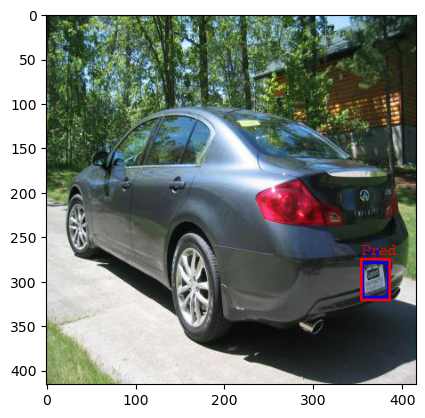

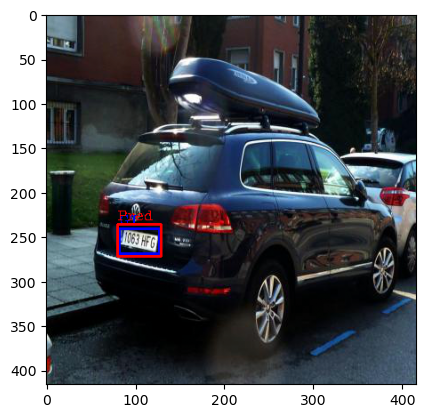

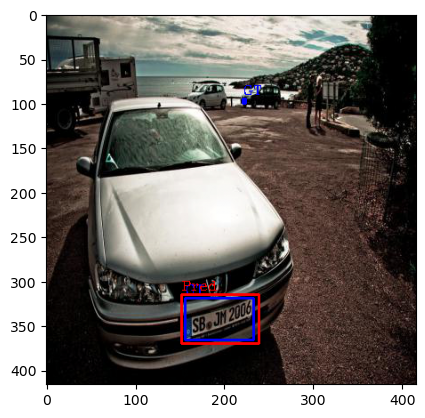

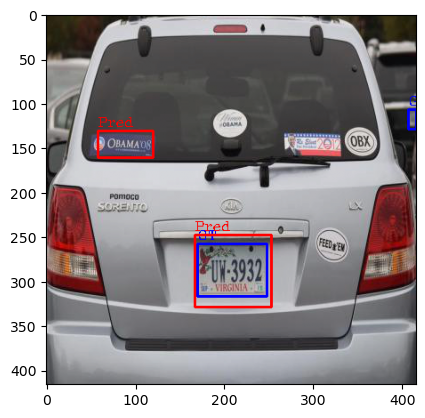

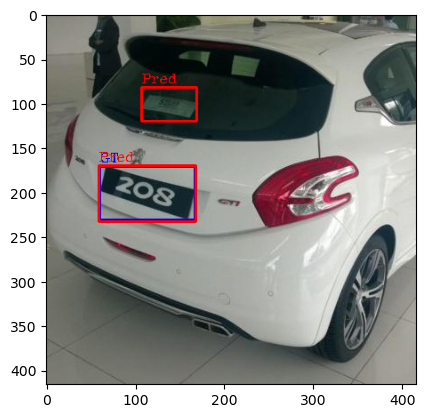

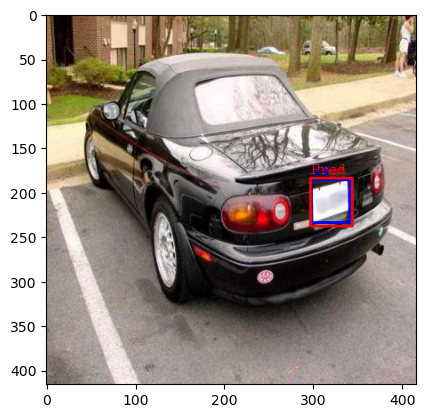

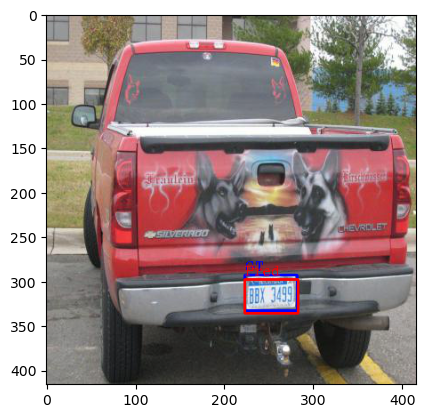

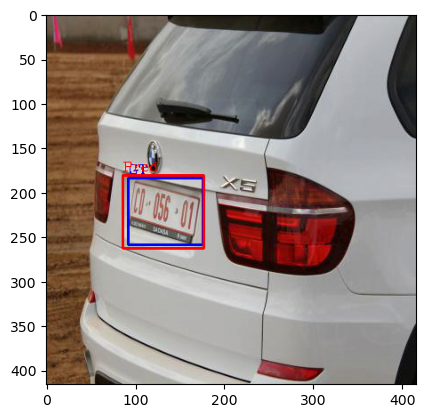

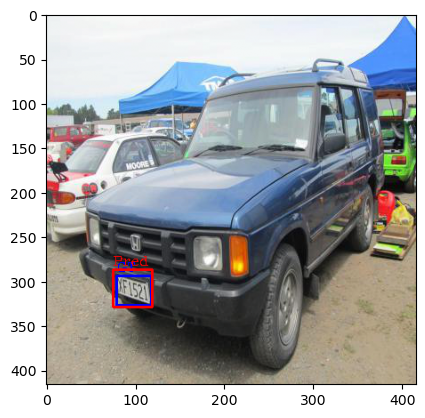

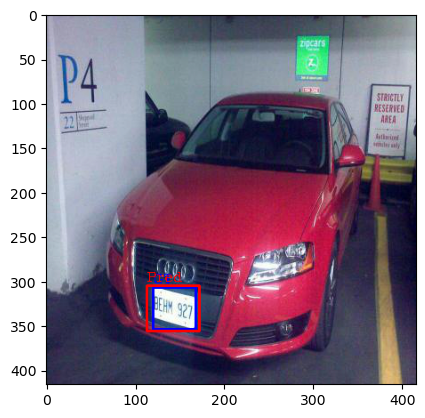

In [ ]:
import matplotlib.pyplot as plt

for i in range(NUM_IMG_TO_PLOT):
    plt.figure(i+1)
    plt.imshow(img_to_plot[i])
    plt.show()

From the qualitative results shown above, the model can predicts license plates from an image (Note that red box indicates a prediction, and blue box indicates a ground truth). However, false positive predictions do exist.

### YOLOv3 for License Plate Detection on Videos

To solve problems orginated from applying the vanilla YOLOv3 to a video (more on these problems later), we define a class to perform Seq-NMS. Seq-NMS is proposed in [this paper](https://arxiv.org/abs/1602.08465). The main idea behind Seq-NMS is to find associated bounding boxes across frames at different time steps in a video to form a bounding box sequence. Then re-calculate the confidence score of these bounding boxes by aggregating confidence scores in the whole bounding box sequence. This procedure can improve bounding box prediction at the current time frame based on past bounding box predictions, which leads to more consistent results throughout the video.

First we define a helper function to properly perform NMS with sequence information.

In [ ]:
def non_max_suppression_for_seq(bboxes, iou_threshold, threshold, box_format="corners"):
    """
    NMS for bboxes with sequence information (used in Seq-NMS)

    Parameters:
        bboxes (list): list of lists containing all bboxes with each bboxes
        specified as [prob_score, x1, y1, x2, y2, seq_length, seq_score]
        iou_threshold (float): if two bounding boxes have an IOU higher than this threshold,
        the box with lower confidence is removed
        threshold (float): confidence threshold to remove predicted bboxes if 
        their confidence is lower than this threshold
        box_format (str): "midpoint" or "corners" used to specify bboxes

    Returns:
        list: bboxes after performing NMS given a specific IoU threshold
    """

    assert type(bboxes) == list

    bboxes = [box for box in bboxes if box[0] > threshold]
    bboxes = sorted(bboxes, key=lambda x: x[0], reverse=True)
    bboxes_after_nms = []

    while bboxes:
        chosen_box = bboxes.pop(0)

        bboxes = [box for box in bboxes if intersection_over_union(torch.tensor(chosen_box[1:5]), torch.tensor(box[1:5]),
                                                                   box_format=box_format) < iou_threshold]

        bboxes_after_nms.append(chosen_box)

    return bboxes_after_nms

**Class for Seq-NMS**

The below class implements the Seq-NMS.

In [ ]:
class SeqNMS:
    def __init__(self, link_conf_thres, link_iou_thres, nms_conf_thres, nms_iou_thres, rescore):
        """
        link_conf_thres: bboxes with confidence lower than this threshold are not considered in Seq-NMS
        link_iou_thres: if bboxes from different frames have IOU higher than this threshold, these bboxes
        are aggregated as a sequence
        nms_conf_thres: confidence threshold to perform NMS
        nms_iou_thres: IOU threshold to perform NMS
        resocre: either 'avg' or 'max'. Given a sequence, re-calculate the confidence score for the 
        latest bbox in the sequence by either the average confidence score or maximum confidence score throughout
        the whole sequence
        """
        self.link_conf_thres = link_conf_thres
        self.link_iou_thres = link_iou_thres
        self.nms_conf_thres = nms_conf_thres
        self.nms_iou_thres = nms_iou_thres
        assert rescore == 'avg' or rescore == 'max', "Use valid rescoring methdo"
        self.rescore = rescore
        
        self.prev_bboxes = None  # bboxes at the previous frame
        self.prev_score = None  # confidence score for bboxes at the previous frame
        self.prev_seq_length = None  # sequence length for bboxes at the previous frame

    def _rm_low_conf(self, bboxes):
        """
        remove bboxes with low confidence

        :param bboxes: input bboxes without being filtered
        :return: bboxes with higher confidence
        """
        conf_bboxes = []
        for bbox in bboxes:
            if bbox[0] > self.link_conf_thres:
                conf_bboxes.append(bbox)
        return conf_bboxes

    def _cal_bbox_iou(self, bbox):
        # calculate IOU between the given bbox and all bboxes from the previous frame
        ious = np.zeros(len(self.prev_bboxes))
        for i in range(len(self.prev_bboxes)):
            ious[i] = intersection_over_union(torch.tensor(bbox[1:]), torch.tensor(self.prev_bboxes[i][1:]),
                                              'midpoint').item()
        return ious

    def process(self, bboxes):
        """
        process new bboxes by Seq-NMS

        :param bboxes: The input bboxes are in a list [number of boxes, 5], the second dimension contains conf score,
        x center, y center, width and height of each bbox
        """
        prev_bboxes = []
        prev_score = []
        prev_seq_length = []
        
        # remove bboxes with very low confidence
        bboxes = self._rm_low_conf(bboxes)
        
        if len(bboxes) == 0:
            # in case all bbox proposals have low confidence score
            self.prev_bboxes = None
            self.prev_score = None
            self.prev_seq_length = None
            return bboxes

        if self.prev_bboxes is None:
            # first frame we process
            nms_bboxes = non_max_suppression(bboxes, self.nms_iou_thres, self.nms_conf_thres, "midpoint")
            for nms_bbox in nms_bboxes:
                # each nms_bboxes will be used as the start of a sequence for the next frame
                prev_bboxes.append(nms_bbox)
                # confidence score of the current nms_bboxes
                prev_score.append(nms_bbox[0])
                # we are dealing with the first frame, hence the sequence length for each bbox is 1
                prev_seq_length.append(1)
        else:
            # establish sequences
            # for recording the bbox ids from self.prev_bboxes that are linked to the bboxes at the current frame
            link_id = -1 * np.ones(len(bboxes), dtype=np.int16)
            for i in range(len(bboxes)):
                bbox = bboxes[i]
                # compute IOU between each bbox of the current frame with each bbox from the previous frame
                ious_bbox = self._cal_bbox_iou(bbox)
                # based on ious_bbox, identify which bbox from the previous frame has the highest IOU with the bbox of
                # interest at the current frame. If this max IOU > predefined threshold, build a connection between
                # these two bboxes
                max_iou_id = np.argmax(ious_bbox)
                if ious_bbox[max_iou_id] > self.link_iou_thres:
                    link_id[i] = max_iou_id
            # sequence selection and sequence rescoring
            # Note that each bbox from the current frame could be linked to the same bbox in the previous frame
            # from these multiple bboxes, we will only keep the one with the highest confidence score
            # so that each bbox from the previous frame is only linked to at most 1 bbox at the current frame
            # after selecting the sequence, rescore each bbox according to either average or max
            current_score = np.asarray(bboxes)[:, 0]
            bboxes_selected = []  # bboxes after selecting the appropriate sequences
            seq_length_selected = []  # record the sequence length for sequence which each bbox is part of
            conf_score_selected = []  # confidence score of the sequence which each bbox is part of
            for prev_bbox_id in range(len(self.prev_bboxes)):
                # identify current bboxes that are linked to a specific bbox from the previous frame
                current_bboxes_to_prev_bbox = link_id == prev_bbox_id
                # apply NOT
                current_bboxes_to_prev_bbox_ = np.logical_not(current_bboxes_to_prev_bbox)
                # change the score for bboxes not linked to the specific bbox from the previous frame to -1 
                # to exclude them from highest score identification
                current_score_to_prev_bbox = np.copy(current_score)
                current_score_to_prev_bbox[current_bboxes_to_prev_bbox_] = -1
                # id of bbox in the current frame with the max confidence score to the specified prev bbox
                max_bbox_id_to_prev_bbox = np.argmax(current_score_to_prev_bbox)
                if current_score_to_prev_bbox[max_bbox_id_to_prev_bbox] == -1:
                    # indicate there is no link between bboxes in the current frame to the specified bbox in the previous frame
                    continue
                selected_bbox = bboxes[max_bbox_id_to_prev_bbox]
                # sequence length for the sequence corresponding to the current bbox + 1 to account for the current bbox
                seq_length_selected.append(self.prev_seq_length[prev_bbox_id] + 1)
                # rescore bbox at the current frame
                if self.rescore == 'max':
                    # recalculate the confience score based on the maximum score in the sequence
                    selected_bbox[0] = max(selected_bbox[0], self.prev_score[prev_bbox_id])
                    # when we use max to rescore, we record the maximum score of a sequence
                    conf_score_selected.append(selected_bbox[0])
                else:
                    # when we use avg to rescore, we record the sum of score of a sequence
                    conf_score_selected.append(selected_bbox[0] + self.prev_score[prev_bbox_id])
                    # average the sum by the total sequence length
                    selected_bbox[0] = conf_score_selected[-1] / seq_length_selected[-1]
                bboxes_selected.append(selected_bbox)
            # For bboxes from the current frames that do not link to any bboxes from the previous frames
            # we add them all to bboxes_selected
            for i in range(len(link_id)):
                if link_id[i] == -1:
                    bboxes_selected.append(bboxes[i])
                    # store the conf score of bboxes that do not belong to any sequence for future rescoring
                    conf_score_selected.append(bboxes[i][0])
                    # sequence length for bboxes that do not belong to any sequence is 1
                    seq_length_selected.append(1)

            # perform nms on the bboxes that have been rescored
            bboxes_selected = np.asarray(bboxes_selected)
            bboxes_selected = np.concatenate([bboxes_selected, np.asarray(seq_length_selected).reshape(-1, 1),
                                              np.asarray(conf_score_selected).reshape(-1, 1)], axis=1)
            bboxes_selected = bboxes_selected.tolist()
            nms_bboxes = non_max_suppression_for_seq(bboxes_selected, self.nms_iou_thres, self.nms_conf_thres,
                                                     "midpoint")

            for nms_bbox in nms_bboxes:
                # store bboxes after NMS at the current time frame, the sequence length information
                # and confidence score information corresponding to each bbox
                prev_bboxes.append(nms_bbox[:5])
                prev_seq_length.append(int(nms_bbox[5]))
                prev_score.append(nms_bbox[6])

        if len(prev_bboxes) == 0:
            # in case nms suppress all bbox, i.e., all bboxes have conf < nms_conf_thres
            self.prev_bboxes = None
            self.prev_score = None
            self.prev_seq_length = None
            return prev_bboxes
        
        # the current bbox, confidence score, and sequence length information will be used 
        # for the next frame
        self.prev_bboxes = prev_bboxes
        self.prev_score = prev_score
        self.prev_seq_length = prev_seq_length

        return self.prev_bboxes

**Dataloader for images from a video**

A class to prepare each frame of a video so that its format is compatible with YOLOv3

In [ ]:
class VideoLoader:
    # for preprocessing images data from video files
    def __init__(self, img_size):
        # basic image transformation so that the size agrees with the YOLOv3 model
        self.transforms = A.Compose(
            [A.SmallestMaxSize(max_size=img_size),
             A.PadIfNeeded(min_height=img_size, min_width=img_size, border_mode=cv2.BORDER_CONSTANT),
             A.CenterCrop(height=img_size, width=img_size),
             A.Normalize(), ToTensorV2()])

    def process_frame(self, image):
        augmentations = self.transforms(image=image)
        image = augmentations['image']
        image = torch.unsqueeze(image, 0)  # add the batch dimension
        return image

**A class to detect license plates from videos**

A class to detect license plates in videos by YOLOv3 and Seq-NMS (if specified to use it). Each frame is saved as an image in the specified directory.

Define some variables to determine the configuration of this class. Note that we do not use Seq-NMS here to show how the vanilla model performs on videos.

In [ ]:
USE_SEQ_NMS = False  # First, we do not use Seq-NMS to see the vanilla YOLOv3's performance on videos
SEQ_CONF = 0.1  # confidence threshold for Seq-NMS
SEQ_IOU = 0.5  # IOU threshold for Seq-NMS
SEQ_NMS_RESCORE = "max"  # Method to re-calculate confidence score in Seq-NMS
FILL_BOX = True  # paint the detected box with a color
MODEL_NAME = "detect_video"
SRC_DATA = "./dataset/video_test/new_york_5_min_720p.mp4"  # directory of the source video

In [ ]:
class YOLOv3VideoProcessor:
    def __init__(self):
        self.scales = [32, 16, 8]
        self.norm_anchors = []
        anchors = [
            [(116, 90), (156, 198), (373, 326)],
            [(30, 61), (62, 45), (59, 119)],
            [(10, 13), (16, 30), (33, 23)]
        ]
        for scale in range(len(anchors)):
            norm_anchors_at_scale = []
            for anchor in range(len(anchors[scale])):  # 3 anchors in each scale
                norm_anchor = [anchors[scale][anchor][0] / IMG_SZ,
                               anchors[scale][anchor][1] / IMG_SZ]  # normalize each anchor
                norm_anchors_at_scale.append(norm_anchor)
            self.norm_anchors.append(norm_anchors_at_scale)
        # anchor size in each image scale
        self.scaled_anchors = (torch.tensor(self.norm_anchors) * torch.tensor(
            [IMG_SZ // self.scales[0], IMG_SZ // self.scales[1],
             IMG_SZ // self.scales[2]]).unsqueeze(1).unsqueeze(1).repeat(1, 3, 2)).to(DEVICE)

        self.model = YOLOv3()
        self.model = self.model.to(DEVICE)
        # load pretrained weights
        if PRETRAINED_MODEL is not None and os.path.exists(PRETRAINED_MODEL):
            checkpt_path = os.path.join(PRETRAINED_MODEL, "model.pth")
            assert os.path.exists(checkpt_path), "Invalid checkpoint file"
            print("Loading model %s" % PRETRAINED_MODEL)
            state_dict = torch.load(checkpt_path)
            self.model.load_state_dict(state_dict)
        else:
            print("Invalid pretrained model")
            raise FileNotFoundError

        self.loader = VideoLoader(IMG_SZ)

        # load post processing processor if USE_SEQ_NMS is True
        if USE_SEQ_NMS:
            self.post_processor = SeqNMS(SEQ_CONF, SEQ_IOU, EVAL_CONF_THRES, EVAL_NMS_IOU_THRES, SEQ_NMS_RESCORE)
        # path to save the predicted images with bboxes based on the video
        self.log_path = os.path.join(LOG_PATH, MODEL_NAME)
        if not os.path.exists(self.log_path):
            os.makedirs(self.log_path)
        
        # to revert ImageNet normalization
        self.inv_normalize = transforms.Normalize(
            mean=[-0.485 / 0.229, -0.456 / 0.224, -0.406 / 0.225],
            std=[1 / 0.229, 1 / 0.224, 1 / 0.225])
        self.current_step = 0

        print("Begin testing %s" % MODEL_NAME)
        print("-------------Logging Info-------------")
        print("Outputs saved in: %s" % LOG_PATH)
        print("-------------Dataset Info-------------")
        print("Image size: %d" % IMG_SZ)
        print("Data source: %r" % SRC_DATA)
        print("-------------Model Info-------------")
        print("Testing device: %s" % DEVICE)
        print("Confidence threshold for NMS: %.2f" % EVAL_CONF_THRES)
        print("IOU threshold for NMS: %.2f" % EVAL_NMS_IOU_THRES)
        print("-------------Post Processing Info-------------")
        print("Post process with Seq-NMS: %r" % USE_SEQ_NMS)
        print("Fill detected box with color: %r" % FILL_BOX)
        print("Confidence threshold for Seq-NMS: %.2f" % SEQ_CONF)
        print("IOU threshold for Seq-NMS: %.2f" % SEQ_IOU)
        print("Rescoring method for Seq-NMS: %s" % SEQ_NMS_RESCORE)

    def _create_pred_img(self, img, pred_bbox):
        # create a predicted image that contains the input frame and the predicted bboxes
        img = self.inv_normalize(img)
        img_bbox = img.squeeze().detach().cpu().numpy()
        img_bbox = 255 * np.transpose(img_bbox, (1, 2, 0))
        img_bbox = (img_bbox.astype(np.uint8)).copy()
        pred_bbox = torch.FloatTensor(pred_bbox)

        for i in range(pred_bbox.size()[0]):
            x1 = (pred_bbox[i, 1] - pred_bbox[i, 3] / 2) * IMG_SZ
            y1 = (pred_bbox[i, 2] - pred_bbox[i, 4] / 2) * IMG_SZ
            x2 = (pred_bbox[i, 1] + pred_bbox[i, 3] / 2) * IMG_SZ
            y2 = (pred_bbox[i, 2] + pred_bbox[i, 4] / 2) * IMG_SZ
            if FILL_BOX:
                cv2.rectangle(img_bbox, (int(x1), int(y1)), (int(x2), int(y2)), (255, 0, 0), -1)
            else:
                cv2.rectangle(img_bbox, (int(x1), int(y1)), (int(x2), int(y2)), (255, 0, 0), 2)
                cv2.putText(img_bbox, "Pred", (int(x1), int(y1) - 5), cv2.FONT_HERSHEY_COMPLEX, 0.5, (255, 0, 0), 1)
        return img_bbox

    def test(self):
        # test the model on a video
        self.model.eval()
        elapsed_time = 0
        # load the video
        cap = cv2.VideoCapture(SRC_DATA)
        pos_frame = cap.get(cv2.CAP_PROP_POS_FRAMES)
        while True:
            # while we get a new frame
            flag, frame = cap.read()
            if flag:
                # cv2 reads image in BGR format instead of RGB, convert BGR to RGB
                img = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
                # transform the image such that it agrees with YOLOv3
                img = self.loader.process_frame(img)
                start_time = time.time()
                img = img.to(DEVICE)
                with torch.no_grad():
                    prediction = self.model(img)
                
                # convert predicted grid cells into bboxes
                bboxes = []
                for i in range(3):
                    S = prediction[i].shape[2]
                    anchor = torch.tensor([*self.norm_anchors[i]]).to(DEVICE) * S
                    boxes_scale_i = cells_to_bboxes(prediction[i], anchor, S=S, is_preds=True)
                    for _, (box) in enumerate(boxes_scale_i):
                        bboxes += box

                if USE_SEQ_NMS:
                    # use Seq-NMS to process bboxes if specified to use it
                    nms_boxes = self.post_processor.process(bboxes)
                else:
                    # otherwise, use the vanilla NMS to process bboxes
                    nms_boxes = non_max_suppression(bboxes, iou_threshold=EVAL_NMS_IOU_THRES,
                                                    threshold=EVAL_CONF_THRES, box_format="midpoint")
                # create image with bboxes for saving
                img_bbox_np = self._create_pred_img(img, nms_boxes)
                elapsed_time += (time.time() - start_time)
                # save image with bboxes to disk
                img_bbox_to_save = Image.fromarray(img_bbox_np)
                img_bbox_to_save.save(os.path.join(self.log_path, "%d.png" % int(pos_frame)))
                pos_frame = cap.get(cv2.CAP_PROP_POS_FRAMES)
                # print progress
                if pos_frame % 1000 == 0:
                    print(str(pos_frame) + " frames")
            else:
                cap.set(cv2.CAP_PROP_POS_FRAMES, pos_frame - 1)
                print("frame is not ready")
                # It is better to wait for a while for the next frame to be ready
                cv2.waitKey(1000)
            if cap.get(cv2.CAP_PROP_POS_FRAMES) == cap.get(cv2.CAP_PROP_FRAME_COUNT):
                # If the number of captured frames is equal to the total number of frames,
                # we stop
                break
        print("FPS: %.2f" % ((pos_frame + 1) / elapsed_time))

Predictions on videos without Seq-NMS

In [ ]:
video_tester = YOLOv3VideoProcessor()
video_tester.test()

Loading model log/yolov3_plate_10_6_10/400
Begin testing detect_video
-------------Logging Info-------------
Outputs saved in: ./log
-------------Dataset Info-------------
Image size: 416
Data source: './dataset/video_test/new_york_5_min_720p.mp4'
-------------Model Info-------------
Testing device: cuda
Confidence threshold for NMS: 0.70
IOU threshold for NMS: 0.05
-------------Post Processing Info-------------
Post process with Seq-NMS: False
Fill detected box with color: True
Confidence threshold for Seq-NMS: 0.10
IOU threshold for Seq-NMS: 0.50
Rescoring method for Seq-NMS: max
1000.0 frames
2000.0 frames
3000.0 frames
4000.0 frames
5000.0 frames
6000.0 frames
7000.0 frames
8000.0 frames
9000.0 frames
FPS: 44.72


It is difficult to show the entire video on jupyter notebook. Hence, we only display images from a short clip here. Note that we paint the detected license plate with a solid color to demonstrate that the model has the capability of hiding drivers' personal information.

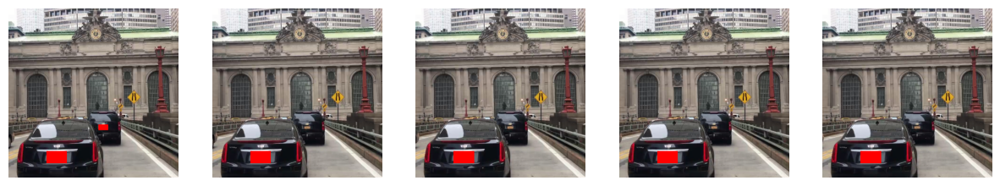

In [ ]:
fig, ax = plt.subplots(1, 5, figsize=(15, 3))
# 1068 or 8251
for i in range(5):
    img = cv2.imread("./log/detect_video/%d.png" % (8251 + i))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax[i].imshow(img)
    ax[i].axis("off")
plt.show()

From the above pictures, we can see that the model without Seq-NMS was able to consistently predict the license plate on the closer car. It managed to predict the license plate of the further car in the first frame but failed to do so in the subsequent frames. Inconsistent predictions across temporally adjacent frames is a problem when applyin just YOLOv3 on a video.

Incorporate Seq-NMS to YOLOv3 and test the new pipeline with the same video.

In [ ]:
USE_SEQ_NMS = True
MODEL_NAME = "detect_video_seq_nms"

In [ ]:
video_tester = YOLOv3VideoProcessor()
video_tester.test()

Loading model log/yolov3_plate_10_6_10/400
Begin testing detect_video_seq_nms
-------------Logging Info-------------
Outputs saved in: ./log
-------------Dataset Info-------------
Image size: 416
Data source: './dataset/video_test/new_york_5_min_720p.mp4'
-------------Model Info-------------
Testing device: cuda
Confidence threshold for NMS: 0.70
IOU threshold for NMS: 0.05
-------------Post Processing Info-------------
Post process with Seq-NMS: True
Fill detected box with color: True
Confidence threshold for Seq-NMS: 0.10
IOU threshold for Seq-NMS: 0.50
Rescoring method for Seq-NMS: max
1000.0 frames
2000.0 frames
3000.0 frames
4000.0 frames
5000.0 frames
6000.0 frames
7000.0 frames
8000.0 frames
9000.0 frames
FPS: 33.00


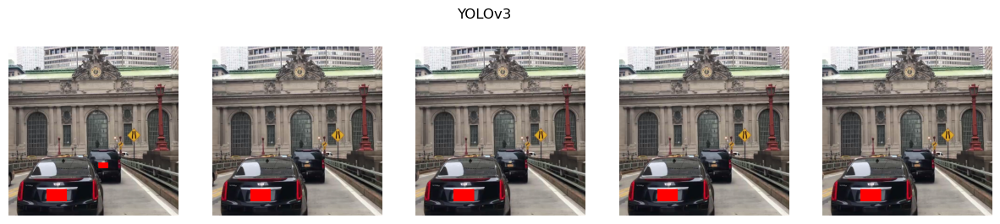

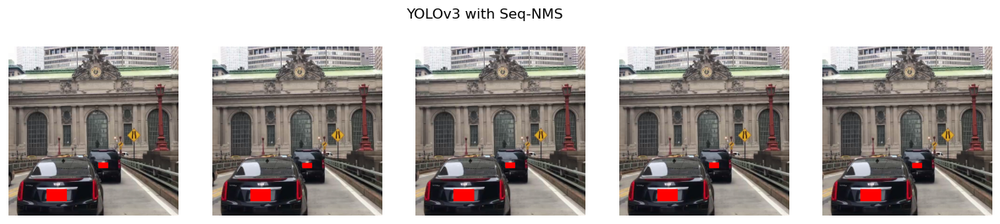

In [ ]:
fig, ax = plt.subplots(1, 5, figsize=(15, 3))
for i in range(5):
    img = cv2.imread("./log/detect_video/%d.png" % (8251 + i))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax[i].imshow(img)
    ax[i].axis("off")
fig.suptitle("YOLOv3")

fig, ax = plt.subplots(1, 5, figsize=(15, 3))
for i in range(5):
    img = cv2.imread("./log/detect_video_seq_nms/%d.png" % (8251 + i))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax[i].imshow(img)
    ax[i].axis("off")
fig.suptitle("YOLOv3 with Seq-NMS")
plt.show()

From the above images, we can see that YOLOv3 with Seq-NMS managed to consistently detect the license plate on the further car. This implies that Seq-NMS is a powerful tool to improve license plate detection in videos.

More videos comparing results from YOLOv3 and YOLOv3 with Seq-NMS can be found [here](https://drive.google.com/file/d/1f8NCgPlilrV2A9P9lareFsgtmIVt_uxC/view?usp=sharing) and [here](https://drive.google.com/file/d/1nW3TlkUJVnYQuGHmdZkFPGHTsobJw3Ls/view?usp=sharing).

### Discussion

Overall, our YOLOv3 model performed well on license plate detection from images. Although it does not produce good results on previously unseen videos, incorporating Seq-NMS has greatly improved license plate detection from videos. More specifically, Seq-NMS results in more consistent outputs across different time steps.

One thing we were surpised was that our YOLOv3 (no pre-training) obtained good accuracy with fewer than 700 training images. It is possible that the data augmentation techniques we adopted created many new unseen training images from the small dataset, which then improved our model's generalization ability. This suggests that data augmentation is an important tool to improve training, especially with a small training dataset. 

Another thing we were surpised was with respect to the anchor boxes used by YOLOv3. YOLOv3's predictions rely on anchor boxes. The size of these boxes is essentially a prior information about how big the predicted bounding box should be. In this project, we used anchor box size from [this repository](https://github.com/aladdinpersson/Machine-Learning-Collection/tree/master/ML/Pytorch/object_detection/YOLOv3) directly. This size was most likely obtained from a dataset very different from our dataset used here. Yet, our model still obtained good results from this anchor box size. However, to obtain even better results, one may want to explore the statistics of the ground truth bounding box size in the current dataset. From there, a new set of anchor box size can be generated for possibly more accurate license plate detection.

## YOLOv5

In this section, we focus on the yolov5 model. Here, two datasets are explored and used for training the model. The first dataset is from kaggle<sup>[1]</sup> consisting of 433 images of cars with license plates.
The second dataset is CCPD(Chinese City Parking Dataset) <sup>[2]</sup> consisting of more than 250k images of license plates.
<br>
More details such as annotations, nature of the images in datasets and etc are discussed as we explore them.

references:
1. https://www.kaggle.com/datasets/andrewmvd/car-plate-detection
2. https://github.com/detectRecog/CCPD

### Directory Structure

<pre>
├── datasets
│   ├── CCPD2019
│   ├── dataset1
├── test_videos
├── yolov5
├── best_3_ccpd.pt
├── best_100.pt
├── cars.yaml
├── ccpd.yaml
├── processBatch.py
├── this notebook
</pre>
note: This directory structure isn't deep and doesn't include the environment, __pycache__, yolov5 runtime generated files and etc.


### Necessary imports

In [ ]:
# required to traverse the xml files and extract the bounding boxes
from glob import glob
import xml.etree.ElementTree as xet

import pandas as pd
import cv2
import os
import shutil

import torch
import torchvision

from PIL import Image
%matplotlib inline
import matplotlib.pyplot as plt

#### Installed suitable version of pytorch library for using with my GPU from <a href="https://pytorch.org/get-started/locally/">pytorch.org</a>

| Name | specifications |
| --- | --- |
| Cuda Device | Nvidia GeForce RTX 3070 mobile   |
| Cuda Cores: | 5120 |
| Memory: | 8GB GDDR6 |
| FP32 (float) | 15.97 TFLOPS |
| FP64 (double) | 249.6 GFLOPS (1:64) |

Note: This device isn't intended for any professional/academic use. It's more of a gaming device.



In [ ]:
# proper pip installation from pytorch.org 
# !pip3 install torch torchvision torchaudio --extra-index-url https://download.pytorch.org/whl/cu117

In [ ]:
# check cuda availability
print(f'cuda is available: {torch.cuda.is_available()}')

# check pytorch version
print(f"PyTorch Version:   {torch.__version__}")

cuda is available: True
PyTorch Version:   1.13.1+cu117


### Clone the YOLOv5 repository from github and install the requirements

In [ ]:
!git clone https://github.com/ultralytics/yolov5    # clone
!cd yolov5                                          # enter root directory                                              
!pip install -r requirements.txt                    # install dependencies

### <b>Yolov5 Label Format (from documentation)</b>
yolo expects one *.txt file per image (if no objects in image, no *.txt file is required). The *.txt file specifications are:
- One row per object
- Each row is class x_center y_center width height format.
- Box coordinates must be in normalized xywh format (from 0 - 1). If your boxes are in pixels, divide x_center and width by image - - width, and y_center and height by image height.
- Class numbers are zero-indexed (start from 0).

<img src="https://user-images.githubusercontent.com/26833433/91506361-c7965000-e886-11ea-8291-c72b98c25eec.jpg" width="600" height="400" />

- The label file corresponding to the above image contains 2 persons (class 0) and a tie (class 27):

>```
>0 0.481719 0.634028 0.690625 0.713278
>0 0.741094 0.524306 0.314750 0.933389
>27 0.364844 0.795833 0.078125 0.400000
>```

<b>Note:</b> We will only be having one class in our dataset, so we will be using the same class number `0` for all the images.


### <b>Yolov5 dataset configuration file</b>

The dataset configuration file is a yaml file that contains the information about the dataset. It contains the following information:
- train: path to train images
- val: path to validation images
- nc: number of classes
- names: list of class names

Here is the configuration file for the dataset1(similar to the one for CCPD dataset as well):
>
>```yaml
>path: ../datasets/dataset1  # dataset root dir
>train: images/train  # train images (relative to 'path') 128 images
>val: images/val  # val images (relative to 'path') 128 images
>test:  images/test # test images (optional)
>
>nc: 1
>names:
>  0: license_plate
>```

### Kaggle dataset
<span id="kaggle_dataset"></span>

Dataset folder is named dataset1 in the datasets folder and have following structure:

<pre>
├── dataset1
│   ├── annotations
│   ├── images
│   ├── labels
</pre>

Some changes are done to the original download, such as dividing the images randomly into train, validation and test folders with 70:20:10 ratios, same for the labels. <br>
Though labels are aren't provided in the dataset are are derived from the annotations. <i>see the code below</i>.

**Dataset format**

- data in annotations folder is in xml files. we need to convert it to txt files in the format required by YOLOv5.
- The xml file consists lots of information but the important ones are bounding box coordinates and image dimensions.
- The bounding box coordinates are in the format: `<xmin> <ymin> <xmax> <ymax>`
<pre>
          ymax
            |
            |
            |
            |  
xmin --------------- xmax
            |
            |   
            |
            |
            ymin
</pre>    

### Converting necessary information from annotations to a dataframe

In [ ]:
def create_labels_dataframe():
    cwd = os.getcwd()
    paths = glob(r'datasets\dataset1\annotations\*.xml')
    labels_dict = dict(filepath=[],tw=[],th=[],xmin=[],xmax=[],ymin=[],ymax=[])
    for filename in paths:

        info = xet.parse(filename)
        root = info.getroot()
        size_object = root.find('size')
        width = int(size_object.find('width').text)
        height = int(size_object.find('height').text)
        member_object = root.find('object')
        labels_info = member_object.find('bndbox')
        xmin = int(labels_info.find('xmin').text)
        xmax = int(labels_info.find('xmax').text)
        ymin = int(labels_info.find('ymin').text)
        ymax = int(labels_info.find('ymax').text)

        labels_dict['filepath'].append(cwd+"\\"+filename)
        labels_dict['tw'].append(width) # tw = total width
        labels_dict['th'].append(height) # th = total height
        labels_dict['xmin'].append(xmin)
        labels_dict['xmax'].append(xmax)
        labels_dict['ymin'].append(ymin)
        labels_dict['ymax'].append(ymax)

    return pd.DataFrame(labels_dict)

In [ ]:
df = create_labels_dataframe()
df

,filepath,tw,th,xmin,xmax,ymin,ymax
0,c:\Users\shiva\Desktop\UofT\Term4-winter2023\M...,500,268,226,419,125,173
1,c:\Users\shiva\Desktop\UofT\Term4-winter2023\M...,400,248,134,262,128,160
2,c:\Users\shiva\Desktop\UofT\Term4-winter2023\M...,400,225,140,303,5,148
3,c:\Users\shiva\Desktop\UofT\Term4-winter2023\M...,400,267,175,214,114,131
4,c:\Users\shiva\Desktop\UofT\Term4-winter2023\M...,400,300,167,240,202,220
...,...,...,...,...,...,...,...
428,c:\Users\shiva\Desktop\UofT\Term4-winter2023\M...,600,400,278,407,182,263
429,c:\Users\shiva\Desktop\UofT\Term4-winter2023\M...,400,248,133,261,126,160
430,c:\Users\shiva\Desktop\UofT\Term4-winter2023\M...,400,300,98,297,102,191
431,c:\Users\shiva\Desktop\UofT\Term4-winter2023\M...,370,400,85,247,196,259


### <b>Testing the annotations</b>

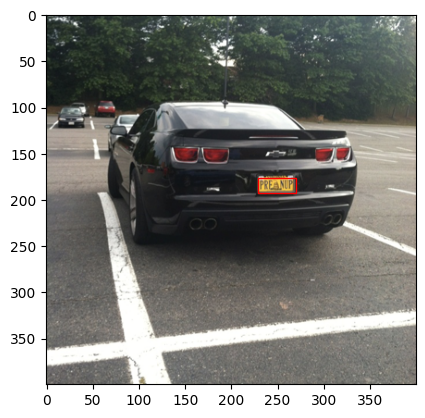

In [ ]:
def show_image_with_bounding_box(bounding_box_test):
    img_path = os.path.join(os.getcwd(),"datasets","dataset1","images","train","Cars"+str(bounding_box_test)+".png")
    img = Image.open(img_path)
    # get the bounding box from the dataframe if filepath has Cars+bounding_box_test+.png in it, then also get the xmin,ymin,xmax,ymax into a list
    bounding_box = df[df['filepath'].str.contains("Cars"+str(bounding_box_test)+".xml")][['xmin','ymin','xmax','ymax']].values.tolist()
    bounding_box = bounding_box[0]
    rect = plt.Rectangle((bounding_box[0], bounding_box[1] ),bounding_box[2]-bounding_box[0],bounding_box[3]-bounding_box[1],fill=False,edgecolor='red',linewidth=1)
    plt.imshow(img)
    plt.gca().add_patch(rect)

show_image_with_bounding_box(2)

### <b>Dataset split ratios</b>

In [ ]:
images_file_path_main = os.path.join(os.getcwd(),"datasets","dataset1","images")

# loop through the images folder and folders inside it train, val, test and get the total number of images
total_images = 0
for folder in os.listdir(images_file_path_main):
    images_file_path = os.path.join(images_file_path_main,folder)
    # add to images only if the file is a png file
    total_images += len([name for name in os.listdir(images_file_path) if name.endswith(".png")])
    
print(f"Total images: {total_images}")

# divide images into 7:2:1 ratio
train_num = int(total_images*0.7)
val_num = int(total_images*0.2)
test_num = total_images - (train_num + val_num)

print(f"train: {train_num}, val: {val_num}, test: {test_num}")

Total images: 433
train: 303, val: 86, test: 44


### <b>Calculating the x_center, y_center, width and height</b>


- The x_center and y_center are calculated by the formula: <br>
`x_center = (xmin + xmax)/(2*tw)` <br>
`y_center = (ymin + ymax)/(2*th)`
<br>
<br>
- The width and height of the bounding box are calculated by the formula: <br>
`width = (xmax - xmin)/tw`<br>
`height = (ymax - ymin)/th` <br>

note: where tw and th are the width and height of the image respectively.

In [ ]:
def calculate_xywh( tw, th, xmin,ymin,xmax,ymax):
    xc = (xmin+xmax)/2
    xc = xc/tw
    yc = (ymin+ymax)/2
    yc = yc/th
    w = xmax-xmin
    w = w/tw
    h = ymax-ymin
    h = h/th
    return xc,yc,w,h

### <b>Creating Labels (*.txt files)</b>
- the bounding box coordinates are converted to the required format by using the image dimensions.
- the class is 0 as there is only one class in the dataset.
- the labels are saved in the labels folder in the same format as the images in the images folder.
- the labels are saved in the same name as the image file with .txt extension.

In [ ]:
# create labels folder if it doesn't exist
labels_folder = 'datasets/dataset1/labels'
if not os.path.exists(labels_folder):
    os.makedirs(labels_folder)

if os.path.exists(labels_folder):
    # loop through the images folder and folders inside it train, val, test
    for folder in os.listdir(images_file_path_main):
        images_file_path = os.path.join(images_file_path_main,folder)
        # loop through the images in the train folder
        for image in os.listdir(images_file_path):
            # get the bounding box from the dataframe if filepath has image in it, then also get the xmin,ymin,xmax,ymax into a list
            bounding_box = df[df['filepath'].str.contains(image[:-4])][['tw','th','xmin','ymin','xmax','ymax']].values.tolist()
            bounding_box = bounding_box[0]
            # calculate the xc,yc,w,h
            xc,yc,w,h = calculate_xywh(*bounding_box)
            # create a file with the same name as the image and write the label and bounding box coordinates
            with open(os.path.join(labels_folder,folder,image.split(".")[0]+".txt"), "w") as f:
                f.write(f"0 {xc} {yc} {w} {h}")

### <b>Training the model</b>

Either bug or intended behavior, but jupyter notebook doesn't show the progress bar of the training process. So, I ran the training process in a terminal. <br>
The training process is done in the terminal using the following command:
>```
>!python yolov5/train.py --img 640 --batch 4 --epochs 100 --data cars.yaml --weights yolov5s.pt --device 0
>```

<b> parameters used:</b>
- `--img 640` : image size
- `--batch 4` : batch size
- `--epochs 100` : number of epochs
- `--data cars.yaml` : path to the dataset configuration file
- `--weights yolov5s.pt` : path to the pretrained weights
- `--device 0` : device to use for training (GPU here)



In [ ]:
!python yolov5/train.py --img 640 --batch 4 --epochs 100 --data cars.yaml --weights yolov5s.pt --device 0

### <b>Testing the model using detect.py script</b>
We will use the test images using yolov5 detect.py script. <br>

In [ ]:
!python yolov5/detect.py --weights yolov5/runs/train/exp24/weights/best.pt --img 640 --conf 0.25 --source datasets/dataset1/images/test

detect: weights=['yolov5/runs/train/exp24/weights/best.pt'], source=datasets/dataset1/images/test, data=yolov5\data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5\runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  v7.0-108-g4db6757 Python-3.10.4 torch-1.13.1+cu117 CUDA:0 (NVIDIA GeForce RTX 3070 Laptop GPU, 8192MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/44 C:\Users\shiva\Desktop\UofT\Term4-winter2023\MIE1517\Project\Testing\datasets\dataset1\images\test\Cars389.png: 480x640 1 license_plate, 22.2ms
image 2/44 C:\Users\shiva\Desktop\UofT\Term4-winter2023\MIE1517\Project\Testing\datasets\dataset1\images\test\Cars390.png: 480x640 2 l

### <b>Testing on a single image</b>

Using cache found in C:\Users\shiva/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2023-2-19 Python-3.10.4 torch-1.13.1+cu117 CUDA:0 (NVIDIA GeForce RTX 3070 Laptop GPU, 8192MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


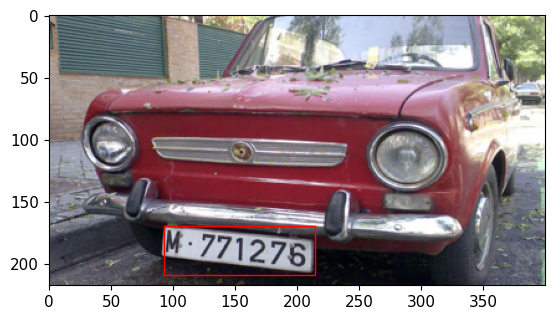

In [ ]:
model = torch.hub.load('ultralytics/yolov5', 'custom', path='yolov5/runs/train/exp24/weights/best.pt')
image_path = Image.open('datasets/dataset1/images/test/Cars393.png')
results = model(image_path)

res_tensor = results.xyxy[0]

# convert tensor to normal array
res_numpy = res_tensor.cpu().numpy()

plt.imshow(image_path)
# get the bounding box coordinates
xmin = res_numpy[0][0]
ymin = res_numpy[0][1]
xmax = res_numpy[0][2]
ymax = res_numpy[0][3]

# # draw the bounding box
rect = plt.Rectangle((xmin, ymin),xmax-xmin,ymax-ymin,fill=False,edgecolor='red',linewidth=1)
plt.gca().add_patch(rect)
plt.show()

### <b>Bluring the image using the coordinates acquired from the model</b>

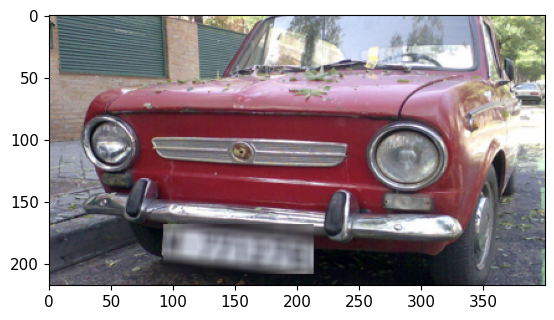

In [ ]:
# blur bounding box area
image = cv2.imread('datasets/dataset1/images/test/Cars393.png')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# get the bounding box coordinates
xmin = int(res_numpy[0][0])
ymin = int(res_numpy[0][1])
xmax = int(res_numpy[0][2])
ymax = int(res_numpy[0][3])

# blur the image
image[ymin:ymax,xmin:xmax] = cv2.blur(image[ymin:ymax,xmin:xmax],(10,10))

plt.imshow(image)

>### <b>Note:</b> We will later create a function to find and blur the license plate in the image. as well as test it on videos.

### <b>Observations</b> <span id="kaggle_dataset_observations"></span>

Test results from detect.py were good, mostly detecting the license plate and blurring it. <br>
While there were no image with missed license plates, There were though 2 false positives.

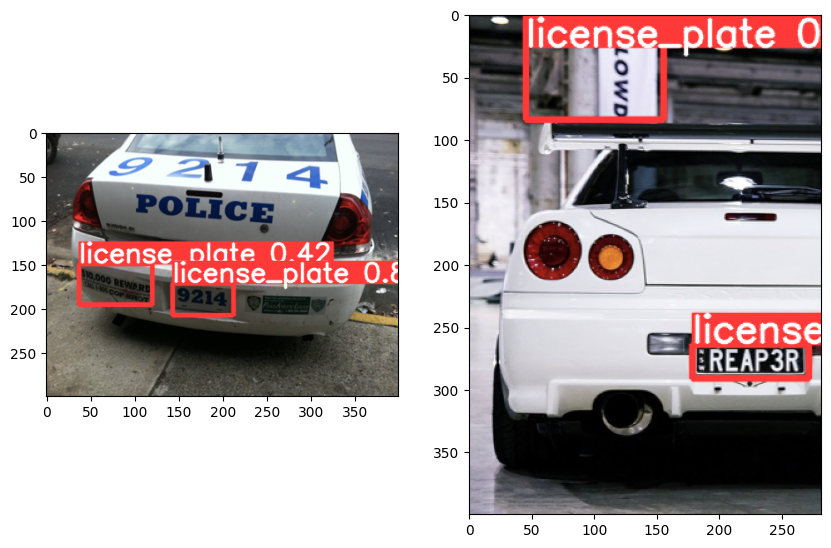

In [ ]:
obs_imgs = ["yolov5/runs/detect/exp14/Cars397.png","yolov5/runs/detect/exp14/Cars396.png"]
fig, ax = plt.subplots(1,2,figsize=(10,10))
for i in range(2):
    image = cv2.imread(obs_imgs[i])
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    ax[i].imshow(image)

Here we can see that text in images are being confused as license plates. resulting in false positives.

### <b>CCPD2019 Dataset</b><span id='ccpd_dataset'></span>

This dataset folder is named CCPD2019 in the datasets folder and have following structure:

<pre>
├── CCPD2019
│   ├── ccpd_base
│   ├── ccpd_blur
│   ├── ccpd_challenge
│   ├── ccpd_db
│   ├── ccpd_fn
│   ├── ccpd_np
│   ├── ccpd_rotate
│   ├── ccpd_tilt
│   ├── ccpd_weather
│   ├── splits
│   ├── yolo
│   ├── ├── images
│   ├── ├── labels
</pre>

Some changes are done to the original download, yolo is a folder that is created to store the dataset in required yolo format (using python).<br>
Here as well labels are aren't provided in the dataset neither are any kind of separate annotation files. it is to be extracted from the image file names.

**Dataset format (from Github)**


Annotations are embedded in file name.

<b>Example:</b> "025-95_113-154&383_386&473-386&473_177&454_154&383_363&402-0_0_22_27_27_33_16-37-15.jpg".<br> Each name can be split into seven fields where "-" is present. Those fields are explained as follows.

- <b>Area (025):</b> Area ratio of license plate area to the entire picture area.

- <b>Tilt degree (95,113):</b> Horizontal tilt degree and vertical tilt degree.

- <b>Bounding box coordinates:</b> The coordinates of the left-up and the right-bottom vertices.

- <b>Four vertices locations:</b> The exact (x, y) coordinates of the four vertices of LP in the whole image. These coordinates start from the right-bottom vertex.

- <b>License plate number:</b> Each image in CCPD has only one LP. Each LP number is comprised of a Chinese character, a letter, and five letters or numbers. A valid Chinese license plate consists of seven characters: province (1 character), alphabets (1 character), alphabets+digits (5 characters). "0_0_22_27_27_33_16" is the index of each character. These three arrays are defined as follows. The last character of each array is letter O rather than a digit 0. We use O as a sign of "no character" because there is no O in Chinese license plate characters.

- <b>Brightness:</b> The brightness of the license plate region.

- <b>Blurriness:</b> The Blurriness of the license plate region.

### <b>Dataset split ratio (provided)</b>
Some information about the dataset split ratio is provided in the splits folder, though it is not in the format required by YOLOv5 and the one we used for training. <br>

In [ ]:
# read test, train and val text files from CCPD2019/splits
with open('datasets/CCPD2019/splits/test.txt') as f:
    test_images = f.readlines()
with open('datasets/CCPD2019/splits/train.txt') as f:
    train_images = f.readlines()
with open('datasets/CCPD2019/splits/val.txt') as f:
    val_images = f.readlines()

# remove the new line character from the end of the string
test_images = [x.strip() for x in test_images]
train_images = [x.strip() for x in train_images]
val_images = [x.strip() for x in val_images]

print(f"test images: {len(test_images)}, train images: {len(train_images)}, val images: {len(val_images)}")

total_images = len(test_images) + len(train_images) + len(val_images)
print(f"total images: {total_images}\n")
# get ratios of train, val and test images
train_ratio = len(train_images)/total_images
val_ratio = len(val_images)/total_images
test_ratio = len(test_images)/total_images

print(f"train ratio: {train_ratio}, \nval ratio: {val_ratio}, \ntest ratio: {test_ratio}")

test images: 141982, train images: 100000, val images: 99996
total images: 341978

train ratio: 0.2924164712349917, 
val ratio: 0.29240477457614233, 
test ratio: 0.41517875418886596


### <b>Testing the annotations (bounding box coordinates)</b>

In [ ]:
def check_image_bounding_box(image_str):
    xy = []

    test1 = image_str[10:].split("-")
    test1 = test1[2].split("_")

    # convert to x1,y1,x2,y2
    for i in range(len(test1)):
        test1[i] = test1[i].split("&")
        xy.append((int(test1[i][0]),int(test1[i][1])))

    print(xy)
    # get the image and show it with bounding box
    image = cv2.imread('datasets/CCPD2019/'+image_str)
    # get height and width of the image
    h,w = image.shape[:2]
    print(f"height: {h}, width: {w}")
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # get the bounding box coordinates
    xmin = xy[0][0]
    ymin = xy[0][1]
    xmax = xy[1][0]
    ymax = xy[1][1]

    # print x_center,y_center,width,height in ratios
    print(f"x_center: {(xmin+xmax)/2/w},\ny_center: {(ymin+ymax)/2/h},\nwidth: {(xmax-xmin)/w},\nheight: {(ymax-ymin)/h}""")

    # draw the bounding box
    rect = plt.Rectangle((xmin, ymin),xmax-xmin,ymax-ymin,fill=False,edgecolor='red',linewidth=1)
    plt.gca().add_patch(rect)

    # draw a circle in the center of the bounding box
    plt.plot((xmin+xmax)/2,(ymin+ymax)/2,'ro')

    plt.imshow(image)

ccpd_base/0219683908046-89_84-126&620_414&687-414&688_144&694_122&619_392&613-0_0_1_25_25_26_3-36-29.jpg
[(126, 620), (414, 687)]
height: 1160, width: 720
x_center: 0.375,
y_center: 0.5633620689655172,
width: 0.4,
height: 0.05775862068965517


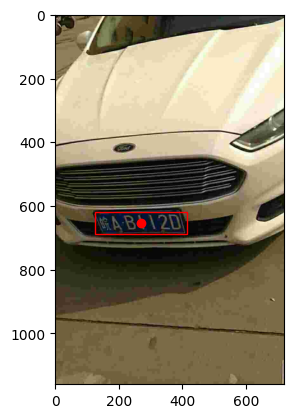

In [ ]:
print(val_images[0])
check_image_bounding_box(val_images[0])

### <b>Testing annotations (edges)</b>

In [ ]:
def check_image_exact_vertices(image_str):
    xy = []

    test1 = image_str[10:].split("-")
    test1 = test1[3].split("_")

    # convert to x1,y1,x2,y2
    for i in range(len(test1)):
        test1[i] = test1[i].split("&")
        xy.append((int(test1[i][0]),int(test1[i][1])))

    print(xy)

    # [(482, 585), (148, 572), (139, 473), (473, 486)]
    # show these points on the image
    image = cv2.imread('datasets/CCPD2019/'+image_str)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # show the points on the image
    for i in range(len(xy)):
        # show the points bigger
        cv2.circle(image, xy[i], 10, (0, 0, 255), -1)

    plt.imshow(image)


[(482, 585), (148, 572), (139, 473), (473, 486)]


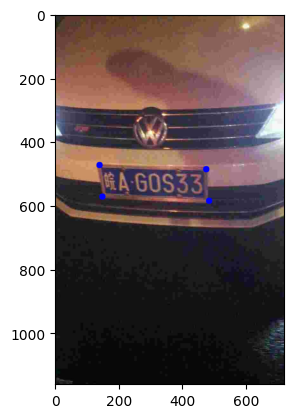

In [ ]:
check_image_exact_vertices(val_images[3])

### <b>Check number of images given in splits *.txt file</b>

In [ ]:
# while the ccpd does have train, val and test splits,it is of 30%, 30%, 40% respectively.
# so we will create our own splits with more images in the train set.
# lets remove ccpd_np as it does not have bounding boxes
all_images = []

# loop through datasets/CCPD2019/splits files
for file in os.listdir('datasets/CCPD2019/splits'):
    if "test" not in file and "train" not in file and "val" not in file:
        with open('datasets/CCPD2019/splits/'+file) as f:
            images = f.readlines()
        # remove the new line character from the end of the string
        images = [x.strip() for x in images]
        print(f"{file}: {len(images)}")
        all_images.extend(images)

print(f"total images: {len(all_images)}")


ccpd_blur.txt: 20611
ccpd_challenge.txt: 50003
ccpd_db.txt: 10132
ccpd_fn.txt: 20967
ccpd_rotate.txt: 10053
ccpd_tilt.txt: 30216
total images: 141982


>#### **Note:** we won't be using the train, val and test splits provided by the CCPD2019 dataset. We will be creating our own splits.

### <b>Check number of images in folders</b>

In [ ]:
images_count = 0
# loop through datasets/CCPD2019
for file in os.listdir('datasets/CCPD2019'):
    # check if the file is a directory
    if os.path.isdir('datasets/CCPD2019/'+file) and file!="splits" and file!="ccpd_np" and file!="yolo":
        # add length of the directory to images_count
        print(f"{file}: {len(os.listdir('datasets/CCPD2019/'+file))}")
        images_count += len(os.listdir('datasets/CCPD2019/'+file))

print()
print(f"Total Images: {images_count}")


ccpd_base: 199996
ccpd_blur: 20611
ccpd_challenge: 50003
ccpd_db: 10132
ccpd_fn: 20967
ccpd_rotate: 10053
ccpd_tilt: 30216
ccpd_weather: 9999

Total Images: 351977


### Preparing Data

### <b>Creating a dictionary of folders and images</b>

In [ ]:
# splitting the images into train, val and test with 60%, 20%, 20% ratio
# for each of the folders in CCPD2019

images_folders = []

# loop through datasets/CCPD2019
for file in os.listdir('datasets/CCPD2019'):
    # check if the file is a directory
    if os.path.isdir('datasets/CCPD2019/'+file) and file!="splits" and file!="ccpd_np":
        images_folders.append(file)

print(images_folders)

# create a dictionary with the folder name as key and the list of images as value
images_dict = {}

# loop through the images folders
for folder in images_folders:
    images = []
    # loop through the images in the folder
    for file in os.listdir('datasets/CCPD2019/'+folder):
        images.append('datasets/CCPD2019/'+folder+'/'+file)
    images_dict[folder] = images

# print total length of all folder in the dictionary
print(f"total images in dictionary: {sum([len(images_dict[x]) for x in images_dict])}")


['ccpd_base', 'ccpd_blur', 'ccpd_challenge', 'ccpd_db', 'ccpd_fn', 'ccpd_rotate', 'ccpd_tilt', 'ccpd_weather', 'yolo']
total images in dictionary: 351979


### <b>Splitting the dataset in 60:20:20 ratio</b>

In [ ]:
# We need to split the images into train, val and test with 60%, 20%, 20% ratio for each of the folders in CCPD2019
# using the images_dict dictionary
train_images_dirs = []
val_images_dirs = []
test_images_dirs = []

# loop through the images dictionary
for folder in images_dict:
    # get the length of the images in the folder
    images_len = len(images_dict[folder])
    # get the train, val and test split
    train_split = int(images_len*0.6)
    val_split = int(images_len*0.2)
    test_split = int(images_len*0.2)

    # get the train, val and test images
    train_images = images_dict[folder][:train_split]
    val_images = images_dict[folder][train_split:train_split+val_split]
    test_images = images_dict[folder][train_split+val_split:]

    # append the train, val and test images to the train_images_dirs, val_images_dirs and test_images_dirs
    train_images_dirs.extend(train_images)
    val_images_dirs.extend(val_images)
    test_images_dirs.extend(test_images)

print(f"train images: {len(train_images_dirs)}")
print(f"val images: {len(val_images_dirs)}")
print(f"test images: {len(test_images_dirs)}\n")

# verify the total number of images
print(f"total images: {len(train_images_dirs)+len(val_images_dirs)+len(test_images_dirs)}")

train images: 211183
val images: 70392
test images: 70404

total images: 351979


### <b>Copying the images to the respective folders (Yolo format)</b>

In [ ]:
# create folders for train, val and test images in CCPD2019 folder
# and copy the images to the respective folders

# create train folder
if not os.path.exists('datasets/CCPD2019/yolo/images/train'):
    os.makedirs('datasets/CCPD2019/yolo/images/train')

# create val folder
if not os.path.exists('datasets/CCPD2019/yolo/images/val'):
    os.makedirs('datasets/CCPD2019/yolo/images/val')

# create test folder
if not os.path.exists('datasets/CCPD2019/yolo/images/test'):
    os.makedirs('datasets/CCPD2019/yolo/images/test')

# loop through the train images
for image in train_images_dirs:
    # copy the image to the train folder
    shutil.copy(image, 'datasets/CCPD2019/yolo/images/train')
    # status bar percentage
    print(f"Copying train images: {round((train_images_dirs.index(image)/len(train_images_dirs))*100, 2)}%", end="\r")

print()
print("_"*50)
# loop through the val images
for image in val_images_dirs:
    # copy the image to the val folder
    shutil.copy(image, 'datasets/CCPD2019/yolo/images/val')
    print(f"Copying val images: {round((val_images_dirs.index(image)/len(val_images_dirs))*100, 2)}%", end="\r")

print()
print("_"*50)
# loop through the test images
for image in test_images_dirs:
    # copy the image to the test folder
    shutil.copy(image, 'datasets/CCPD2019/yolo/images/test')
    print(f"Copying test images: {round((test_images_dirs.index(image)/len(test_images_dirs))*100, 2)}%", end="\r")

### <b>Creating labels (*.txt files)</b>

Creating Labels was very slow, coming around 7hrs+ if done in a single run as a loop. <br>
So to speed up the process, I used multiprocessing to create the labels in parallel in batches of 1000. <br>
Since I have a 16 core CPU, I used 12 processes to create the labels. theoretically reducing the time by a factor of 12.

#### <b>Multiprocessing check</b>

In [ ]:
import multiprocessing
# print number of cpu cores
print(f"Number of CPU cores: {multiprocessing.cpu_count()}")

Number of CPU cores: 16


#### <b>Creating folders and labels</b>

Here I faced a problem with jupyter notebook and multiprocessing. <br>
The problems/bugs are well known and workarounds were cumbersome. <br>
So I decided to write code in a separate python file and call it from notebook <br>
The code is written in a file `processBatch.py` and contains following code:
```python
from PIL import Image

def process_batch(batch):
    for image_dir, image in batch:
        # get the image name
        image_name = image.split("/")[-1]
        # get the image width and height
        image_width, image_height = Image.open(image_dir+"/"+image).size
        # get the image label
        image_label = (image_dir+"/"+image).replace("images", "labels").replace(".jpg", ".txt")
        # get the image label name
        image_label_name = image_label.split("/")[-1]
        # break the image name into parts
        image_name_parts = image_name.split("-")
        xy = []
        for i in range(len(image_name_parts[2].split("_"))):
            xy.append(image_name_parts[2].split("_")[i].split("&"))
            xy = [list(map(int, x)) for x in xy]
        # get bounding box coordinates
        xmin = xy[0][0]
        ymin = xy[0][1]
        xmax = xy[1][0]
        ymax = xy[1][1]

        # print x_center, y_center, width, height in ratios
        x_center = (xmin + xmax) / (2 * image_width)
        y_center = (ymin + ymax) / (2 * image_height)
        width = (xmax - xmin) / image_width
        height = (ymax - ymin) / image_height
        # write the bounding box coordinates to the txt file
        with open(image_label, "w") as f:
            f.write(f"0 {x_center} {y_center} {width} {height}")

        # close the file
        f.close()

        print(f"Creating labels {image_dir.split('/')[-1]}")
```

It used the same formulas as above to convert the bounding box coordinates to ratios. <br>
The formulas are as follows
- The x_center and y_center are calculated by the formula: <br>
`x_center = (xmin + xmax)/(2*tw)` <br>
`y_center = (ymin + ymax)/(2*th)`
<br>
<br>
- The width and height of the bounding box are calculated by the formula: <br>
`width = (xmax - xmin)/tw`<br>
`height = (ymax - ymin)/th` <br>

note: where tw and th are the width and height of the image respectively.

In [ ]:
import os
import multiprocessing
import processBatch

if __name__ == '__main__':
    # create a folder called labels in CCPD2019/yolo
    if not os.path.exists('datasets/CCPD2019/yolo/labels'):
        os.makedirs('datasets/CCPD2019/yolo/labels')

    # create train folder
    if not os.path.exists('datasets/CCPD2019/yolo/labels/train'):
        os.makedirs('datasets/CCPD2019/yolo/labels/train')

    # create val folder
    if not os.path.exists('datasets/CCPD2019/yolo/labels/val'):
        os.makedirs('datasets/CCPD2019/yolo/labels/val')

    # create test folder
    if not os.path.exists('datasets/CCPD2019/yolo/labels/test'):
        os.makedirs('datasets/CCPD2019/yolo/labels/test')

    images_dir = []
    for dirs in os.listdir('datasets/CCPD2019/yolo/images'):
        images_dir.append('datasets/CCPD2019/yolo/images/'+dirs)

    # create a pool of worker processes
    pool = multiprocessing.Pool(processes=12)

    batch_size = 1000
    for image_dir in images_dir:
        image_files = os.listdir(image_dir)
        num_batches = len(image_files) // batch_size + 1
        for i in range(num_batches):
            batch_start = i * batch_size
            batch_end = (i + 1) * batch_size
            batch = [(image_dir, image_files[j]) for j in range(batch_start, batch_end) if j < len(image_files)]
            # submit each image and its directory to the process pool
            pool.apply_async(processBatch.process_batch, args=(batch,))

    # close the pool and wait for all processes to complete
    pool.close()
    pool.join()

    print("Done")

Done


Either bug or intended behavior, but jupyter notebook doesn't show the progress bar of the training process. So, I ran the training process in a terminal. <br>
The training process is done in the terminal using the following command:
>```
>!python yolov5/train.py --img 640 --batch 8 --epochs 3 --data ccpd.yaml --weights yolov5s.pt --device 0
>```

<b> parameters used:</b>
- `--img 640` : image size
- `--batch 8` : batch size
- `--epochs 3` : number of epochs
- `--data ccpd.yaml` : path to the dataset configuration file
- `--weights yolov5s.pt` : path to the pretrained weights
- `--device 0` : device to use for training (GPU here)



### <b>Training the model</b>

In [ ]:
!python yolov5/train.py --img 640 --batch 8 --epochs 3 --data ccpd.yaml --weights yolov5s.pt --device 0

#### <b>Note:</b> We won't be testing using detect.py script as there are many images in the test set. <br>

### <b>Observations</b> <span id="ccpd_dataset_observations"></span>

- This model is much resource intensive than the previous one due to the sheer number of images in the dataset. each epoch taking around 1hr to complete.
- The model was trained for 3 epochs any more resulted in very little improvement.
- We are limited by the local machine resources and the time taken to train the model. system would be unusable for other tasks during the time (uses all the RAM).
- Many different variations were tried and most optimal is chosen, batch size 8 makes it slightly faster, 16 much more but either crashes the system or break's display drivers. 
- But again this dataset resulted in almost similar result with just 3 epochs compared to previous dataset trained for 100 epochs.


### Testing using the trained models

It's time to create proper function's to detect and blur license plates in an image and video without needing to run the detect.py script. <br>
It's important to make the function as versatile as possible so that it can be used in various scenarios. <br>

### <b>Function to detect license plates in an image</b>

In [ ]:
import torch
from PIL import Image
%matplotlib inline
import matplotlib.pyplot as plt
import cv2

def detect_and_blur_number_plates(model, image, blur_size = 10, show_image=False, image_is_path=False, color = False):

    if image_is_path:
        image_path = image
        image = Image.open(image)

    results = model(image)
    if len(results.xyxy[0]) == 0:
        # show the image
        if show_image:
            # plot title
            plt.title("No license plates detected")
            plt.imshow(image)
            plt.show()
        return image
    res_tensor = results.xyxy[0]

    # convert tensor to normal array
    res_numpy = res_tensor.cpu().numpy()

    image_to_blur = None
    # loop through all detected license plates and blur each one
    for bbox in res_numpy:
        xmin = int(bbox[0])
        ymin = int(bbox[1])
        xmax = int(bbox[2])
        ymax = int(bbox[3])
        # cv2 reads image in BGR format
        if image_is_path:
            image_to_blur = cv2.imread(image_path)
            image_to_blur = cv2.cvtColor(image_to_blur, cv2.COLOR_BGR2RGB)
        else:
            image_to_blur = image.copy()

        if color:
            # fill with red color
            image_to_blur[ymin:ymax,xmin:xmax] = color
        else:
            # blur the image
            image_to_blur[ymin:ymax,xmin:xmax] = cv2.blur(image_to_blur[ymin:ymax,xmin:xmax],(blur_size,blur_size))

    if show_image:
        fig, (ax1,ax2) = plt.subplots(1, 2, figsize=(10, 5), sharey=True)
        ax1.imshow(image)
        rect = plt.Rectangle((xmin, ymin),xmax-xmin,ymax-ymin,fill=False,edgecolor='red',linewidth=1)
        ax1.add_patch(rect)
        ax1.set_title('Original Image')
        ax2.imshow(image_to_blur)
        ax2.set_title('Blurred Image')
        plt.show()
        
    return image_to_blur



#### <b>Model is passed outside the function to avoid loading the model again and again.</b>

In [ ]:
# model is passed outside the function to avoid loading the model again and again
model = torch.hub.load('ultralytics/yolov5', 'custom', path='best_3_ccpd.pt')

Using cache found in C:\Users\shiva/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2023-2-19 Python-3.10.4 torch-1.13.1+cu117 CUDA:0 (NVIDIA GeForce RTX 3070 Laptop GPU, 8192MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


Using cache found in C:\Users\shiva/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2023-2-19 Python-3.10.4 torch-1.13.1+cu117 CUDA:0 (NVIDIA GeForce RTX 3070 Laptop GPU, 8192MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


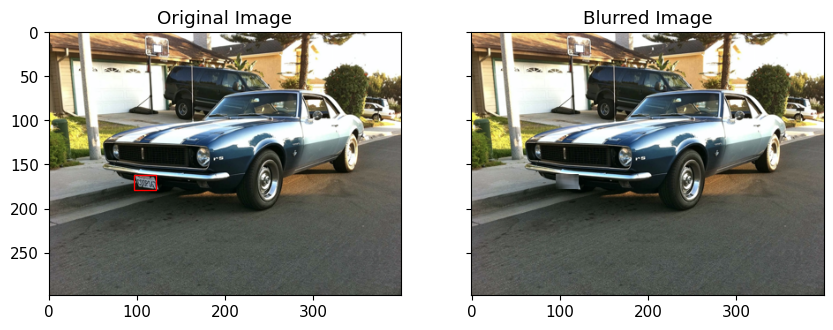

In [ ]:
image_path = 'datasets/dataset1/images/test/Cars421.png'
blur_size = 10

image = detect_and_blur_number_plates(model, image_path, blur_size, show_image=True, image_is_path=True)

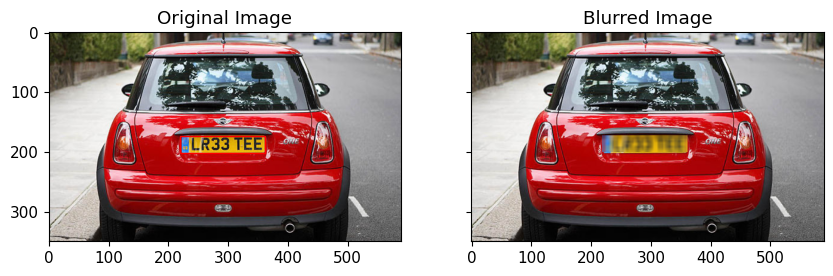

In [ ]:
# one another
image_path = 'datasets/dataset1/images/test/Cars412.png'
image = detect_and_blur_number_plates(model, image_path, blur_size, show_image=True, image_is_path=True)

### <b>Function to detect license plates in a video</b>

In [ ]:
def blur_number_plates_in_video(model, video_path, output_video_path, blur_size = 10,  color = False, real_time=False):

    # Load the input video file
    cap = cv2.VideoCapture(video_path)
    print(cap.get(3), cap.get(4))
    # Define the output video codec and size
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_video_path, fourcc, 30, (int(cap.get(3)), int(cap.get(4))))

    # get the number of frames in the video
    num_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    print("Number of frames in the video: {}".format(num_frames))
    # Loop through each frame of the video
    while(cap.isOpened()):
        # show the progress of the video
        print("Processing frame {}/{}".format(int(cap.get(1)), num_frames), end="\r")

        ret, frame = cap.read()
        if ret == True:
            # Pass the frame through your model to detect number plates
            # and blur the region
            processed_frame = detect_and_blur_number_plates(model, frame, blur_size, color=color)

            # Check if the processed frame is not None before writing to the output video, else write the original frame
            if processed_frame is not None:
                # Write the processed frame to the output video file
                out.write(processed_frame)

                # Display the processed frame if you want to see it in real-time
                if real_time:
                    cv2.imshow('Live output', processed_frame)
                    if cv2.waitKey(1) & 0xFF == ord('q'):
                        break
            else:
                # Write the original frame to the output video file
                out.write(frame)

                # Display the original frame if you want to see it in real-time
                cv2.imshow('Live output', frame)
                if cv2.waitKey(1) & 0xFF == ord('q'):
                    break
        else:
            break

    # Release the video capture and writer objects
    cap.release()
    out.release()

    # Close all windows
    cv2.destroyAllWindows()

    # Print the message
    print()
    print("Video processing complete")


In [ ]:
blur_number_plates_in_video(model, "test_videos/new_york_5_min_720p.mp4", "test_videos/output/output_new_york_720p_ccpd.mp4", color=(0,0,255), real_time=False)

1280.0 720.0
Number of frames in the video: 9050
Processing frame 9050/9050
Video processing complete


### Video Result Observations

- I tested the models in 5 mins clips (30 fps) from youtube, one in busy new york city street and another in singapore highway.
- For the sake of the testing, instead of blurring the license plates, i painted them red.
- The model is able to detect license plates in the video but with lots of false positives.
- Billboards, signs, sometimes windows and other objects are also detected as license plates.
- The models also fail to detect license plates that are either too small or too far away.
- Tried with 4k quality which resulted in broken windows and other artifacts (too much for the system to handle).


> Output video files are available here <a href="https://drive.google.com/drive/folders/1Fm4Rnj7Gu8G5PPf-NkJbl7OfZiacBRKR?usp=sharing">Google Drive</a>

Compared to YOLOv3, YOLOv5 tends to miss more predictions when applying it to videos. Hence, we did not proceed further to test YOLOv5 with Seq-NMS and only used YOLOv3 with Seq-NMS instead.

## **License Plate Modification**

Instead of simply blurring the detected license plates, we are interested to explore different options to anonymize the license plates. two of the options we tried are: <br>
* **Inpainting Using GANs**
* **Generating Fake License Plates using Diffusion**

### **Exploring GANs for inpainting** <span id='gan'></span>

GANs or Generative Adversarial Networks have been shown to be extremely useful for image generation. Generative Adversarial Networks run on a basic principle of a generator trying to ‘fool’ a discriminator and a determined discriminator trying to get hold of the generator. In other words, two networks trying to minimize and maximize a loss function respectively. <br>

Here we used Loss function directly but in the original paper we referred, the authors used a combination of Reconstruction loss and Adversarial loss. <br>

#### Generator and Discriminator on CCPD Dataset

In [ ]:
import os
import glob
from PIL import Image
import torch
from torch.utils.data import Dataset
from torchvision.transforms import Resize, ToTensor, Normalize, Compose
from torchvision import transforms
from sklearn.model_selection import train_test_split

class LicensePlateDataset(Dataset):
    def __init__(self, image_paths, transform=None):
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        image = Image.open(image_path)

        if self.transform:
            image = self.transform(image)

        return image, image_path


transform = Compose([
    Resize((512, 512)),
    ToTensor(),
    Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

folder_path = "datasets/CCPD2019/ccpd_testdata"
image_paths = glob.glob(os.path.join(folder_path, "*.jpg"))

train_paths, val_paths = train_test_split(image_paths, test_size=0.3, random_state=42)

train_dataset = LicensePlateDataset(train_paths, transform)
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=8, shuffle=True)

val_dataset = LicensePlateDataset(val_paths, transform)
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=8, shuffle=True)


# dataset = LicensePlateDataset("datasets/CCPD2019/ccpd_testdata", transform)
# dataloader = torch.utils.data.DataLoader(dataset, batch_size=16, shuffle=True)

In [ ]:
import torch.nn as nn

class Generator_CCPD(nn.Module):
    def __init__(self):
        super(Generator_CCPD, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
        )
        
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1),
            nn.Tanh(),
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

class Discriminator_CCPD(nn.Module):
    def __init__(self):
        super(Discriminator_CCPD, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.Conv2d(256, 1, kernel_size=4, stride=1, padding=0),
            nn.AdaptiveAvgPool2d(1),
            nn.Sigmoid(),
        )

    def forward(self, x):
        x = self.main(x)
        return x.view(-1, 1)


In [ ]:
import torch.optim as optim
import math

def imshow(img):
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

def apply_mask(images, mask):
    return images * (1 - mask)

def masked_l1_loss(real, generated, mask):
    return torch.mean(torch.abs((generated - real) * mask))

def display_images(corrupted, generated, real, epoch):
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    
    corrupted_np = torchvision.utils.make_grid(corrupted[:1], nrow=1).cpu().numpy()
    axs[0].imshow(np.transpose(corrupted_np, (1, 2, 0)))
    axs[0].set_title('Corrupted Image')
    axs[0].axis('off')
    
    generated_np = torchvision.utils.make_grid(generated[:1].detach(), nrow=1).cpu().numpy()
    axs[1].imshow(np.transpose(generated_np, (1, 2, 0)))
    axs[1].set_title('Generated Image')
    axs[1].axis('off')
    
    real_np = torchvision.utils.make_grid(real[:1], nrow=1).cpu().numpy()
    axs[2].imshow(np.transpose(real_np, (1, 2, 0)))
    axs[2].set_title('Real Image')
    axs[2].axis('off')
    
    plt.suptitle(f'Epoch {epoch}')
    plt.show()


def compute_validation_loss(generator, dataloader, extract_bbox):
    criterion = nn.BCELoss()
    loss = 0.0
    count = 0
    width_scale = 512 / 720
    height_scale = 512 / 1160

    with torch.no_grad():
        for images, image_paths in dataloader:
            real_images = images.cuda()
            real_labels = torch.ones(real_images.size(0), 1).cuda()

            # Create masks for license plate regions
            masks = []
            for path in image_paths:
                xmin, ymin, xmax, ymax = extract_bbox(os.path.basename(path))
                # Scale the bounding box coordinates
                xmin = int(xmin * width_scale)
                ymin = int(ymin * height_scale)
                xmax = int(xmax * width_scale)
                ymax = int(ymax * height_scale)
                mask = torch.zeros_like(real_images[0], device='cuda')
                mask[:, ymin:ymax, xmin:xmax] = 1
                masks.append(mask)
            masks = torch.stack(masks)

            # Apply masks to create corrupted images
            corrupted_images = apply_mask(real_images, masks)

            # Compute generator loss on corrupted images
            fake_images = generator(corrupted_images)
            g_loss = criterion(discriminator(fake_images), real_labels)

            loss += g_loss.item() * real_images.size(0)
            count += real_images.size(0)

    return loss / count


def train_gan(generator, discriminator, dataloader, extract_bbox, epochs=100, save_path=None):
    criterion = nn.BCELoss()
    optimizer_g = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    optimizer_d = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    best_loss = math.inf
    best_generator_state = None
    display_interval = 10  # Choose the interval at which you want to display the images (e.g., every 5 epochs)
    
    width_scale = 512 / 720
    height_scale = 512 / 1160

    for epoch in range(epochs):
        for i, (images, image_paths) in enumerate(dataloader):
            real_images = images.cuda()
            real_labels = torch.ones(real_images.size(0), 1).cuda()

            # Create masks for license plate regions
            masks = []
            for path in image_paths:
                xmin, ymin, xmax, ymax = extract_bbox(os.path.basename(path))
                # Scale the bounding box coordinates
                xmin = int(xmin * width_scale)
                ymin = int(ymin * height_scale)
                xmax = int(xmax * width_scale)
                ymax = int(ymax * height_scale)
                mask = torch.zeros_like(real_images[0], device='cuda')
                mask[:, ymin:ymax, xmin:xmax] = 1
                masks.append(mask)
            masks = torch.stack(masks)

            # Apply masks to create corrupted images
            corrupted_images = apply_mask(real_images, masks)

            lambda_l1 = 100  # You can experiment with different values

            # Train generator
            optimizer_g.zero_grad()
            fake_images = generator(corrupted_images)
            fake_labels = torch.zeros(real_images.size(0), 1).cuda()
            g_bce_loss = criterion(discriminator(fake_images), real_labels)
            g_l1_loss = masked_l1_loss(real_images, fake_images, masks) * lambda_l1
            g_loss = g_bce_loss + g_l1_loss
            g_loss.backward()
            optimizer_g.step()

            # Train discriminator
            optimizer_d.zero_grad()
            real_loss = criterion(discriminator(real_images), real_labels)
            fake_loss = criterion(discriminator(fake_images.detach()), fake_labels)
            d_loss = real_loss + fake_loss
            d_loss.backward()
            optimizer_d.step()

        if save_path is not None:
            val_loss = compute_validation_loss(generator, val_dataloader, extract_bbox)
            if val_loss < best_loss:
                best_loss = val_loss
                best_generator_state = generator.state_dict()
                torch.save(best_generator_state, os.path.join(save_path, "best_generator.pth"))

        print(f"Epoch {epoch}/{epochs}, d_loss: {d_loss.item()}, g_loss: {g_loss.item()}")

        if epoch % display_interval == 0:
            print(f"Displaying images at epoch {epoch}")
            display_images(corrupted_images, fake_images, real_images, epoch)



In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from torchvision.transforms import ToTensor

def test_apply_mask(image_path, extract_bbox):
    image = Image.open(image_path)
    image_tensor = ToTensor()(image).unsqueeze(0).cuda()

    xmin, ymin, xmax, ymax = extract_bbox(os.path.basename(image_path))
    mask = torch.zeros_like(image_tensor[0], device='cuda')
    mask[:, ymin:ymax, xmin:xmax] = 1

    masked_image_tensor = apply_mask(image_tensor, mask)

    # Convert tensor back to image
    masked_image = transforms.ToPILImage()(masked_image_tensor[0].cpu())

    # Display original and masked images
    fig, axs = plt.subplots(1, 2)
    axs[0].imshow(image)
    axs[1].imshow(masked_image)
    plt.show()

# Example usage
# test_apply_mask("datasets/CCPD2019/ccpd_testdata/005-90_91-298&425_440&477-434&485_297&479_299&429_436&435-0_0_2_30_21_32_24-191-5.jpg", extract_bbox)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0/100, d_loss: 0.9018703699111938, g_loss: 2.4568796157836914
Displaying images at epoch 0


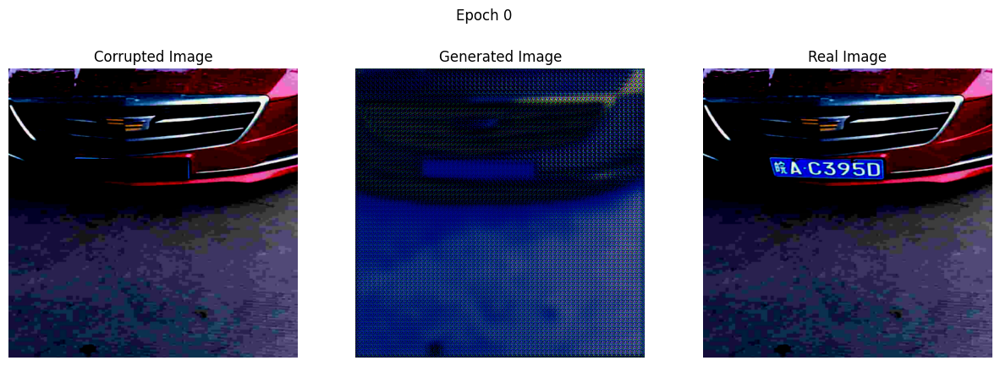

Epoch 1/100, d_loss: 0.950236439704895, g_loss: 2.0164427757263184
Epoch 2/100, d_loss: 1.0037567615509033, g_loss: 1.9585907459259033
Epoch 3/100, d_loss: 1.1593170166015625, g_loss: 2.1659674644470215
Epoch 4/100, d_loss: 0.9490450620651245, g_loss: 2.1475701332092285
Epoch 5/100, d_loss: 1.065427303314209, g_loss: 1.811058759689331
Epoch 6/100, d_loss: 1.202751874923706, g_loss: 1.4017525911331177
Epoch 7/100, d_loss: 1.5237374305725098, g_loss: 1.6803562641143799
Epoch 8/100, d_loss: 1.112323522567749, g_loss: 1.767425298690796
Epoch 9/100, d_loss: 1.2995448112487793, g_loss: 1.8655085563659668


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10/100, d_loss: 1.21702241897583, g_loss: 1.6162440776824951
Displaying images at epoch 10


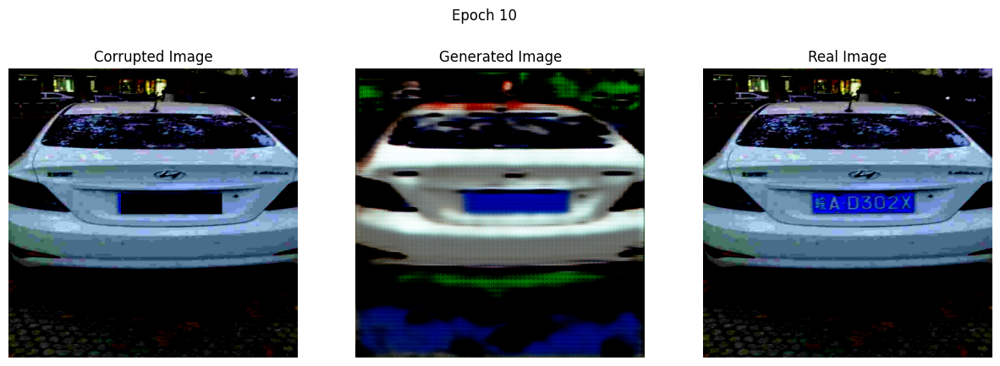

Epoch 11/100, d_loss: 1.086709976196289, g_loss: 2.044843912124634
Epoch 12/100, d_loss: 0.8691550493240356, g_loss: 1.7485814094543457
Epoch 13/100, d_loss: 0.8565355539321899, g_loss: 1.8428945541381836
Epoch 14/100, d_loss: 0.7286958694458008, g_loss: 2.7772085666656494
Epoch 15/100, d_loss: 0.9787254929542542, g_loss: 2.9250330924987793
Epoch 16/100, d_loss: 1.28794264793396, g_loss: 2.1857709884643555
Epoch 17/100, d_loss: 0.4574355185031891, g_loss: 2.458482027053833
Epoch 18/100, d_loss: 0.6524938941001892, g_loss: 2.5968992710113525
Epoch 19/100, d_loss: 0.7754771709442139, g_loss: 2.2163314819335938


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20/100, d_loss: 0.917304277420044, g_loss: 3.128653049468994
Displaying images at epoch 20


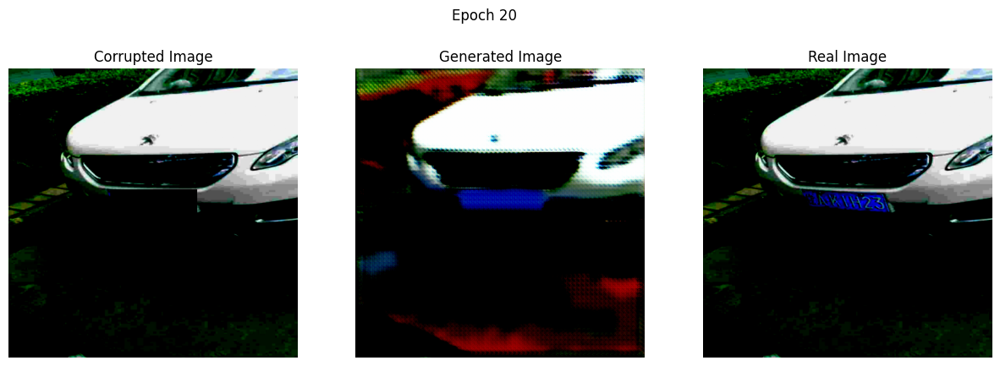

Epoch 21/100, d_loss: 0.47219860553741455, g_loss: 2.668698310852051
Epoch 22/100, d_loss: 0.38950973749160767, g_loss: 2.87662410736084
Epoch 23/100, d_loss: 0.5672606825828552, g_loss: 3.331254720687866
Epoch 24/100, d_loss: 0.8146514296531677, g_loss: 2.6553163528442383
Epoch 25/100, d_loss: 0.502684473991394, g_loss: 2.913315534591675
Epoch 26/100, d_loss: 0.3876321315765381, g_loss: 3.214064836502075
Epoch 27/100, d_loss: 0.5746321678161621, g_loss: 4.444981098175049
Epoch 28/100, d_loss: 1.081047534942627, g_loss: 2.9696898460388184
Epoch 29/100, d_loss: 0.42450132966041565, g_loss: 2.7441201210021973


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30/100, d_loss: 0.6962877511978149, g_loss: 2.199361562728882
Displaying images at epoch 30


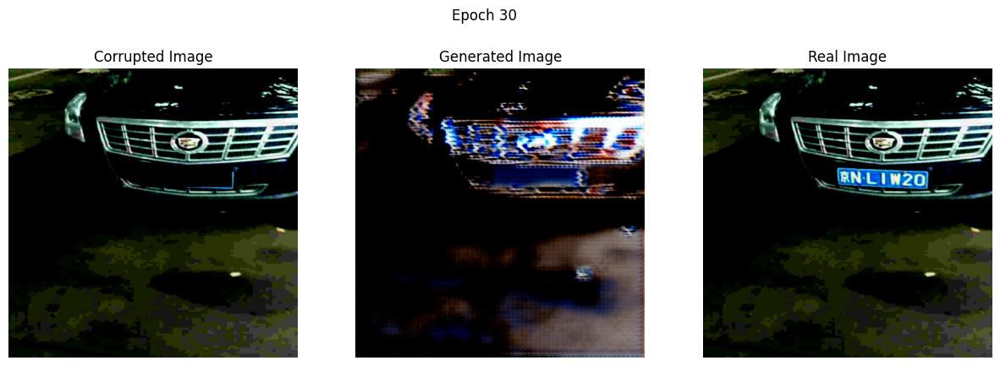

Epoch 31/100, d_loss: 0.48648878931999207, g_loss: 3.975792407989502
Epoch 32/100, d_loss: 0.2938183546066284, g_loss: 3.952646493911743
Epoch 33/100, d_loss: 0.8454186320304871, g_loss: 4.0845947265625
Epoch 34/100, d_loss: 0.31946253776550293, g_loss: 3.10184645652771
Epoch 35/100, d_loss: 0.8214008808135986, g_loss: 1.9479091167449951
Epoch 36/100, d_loss: 0.6163357496261597, g_loss: 4.019220352172852
Epoch 37/100, d_loss: 0.3949925899505615, g_loss: 3.676595449447632
Epoch 38/100, d_loss: 0.47939908504486084, g_loss: 3.2719719409942627
Epoch 39/100, d_loss: 0.41968899965286255, g_loss: 2.497349739074707


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40/100, d_loss: 0.5498291254043579, g_loss: 4.919507026672363
Displaying images at epoch 40


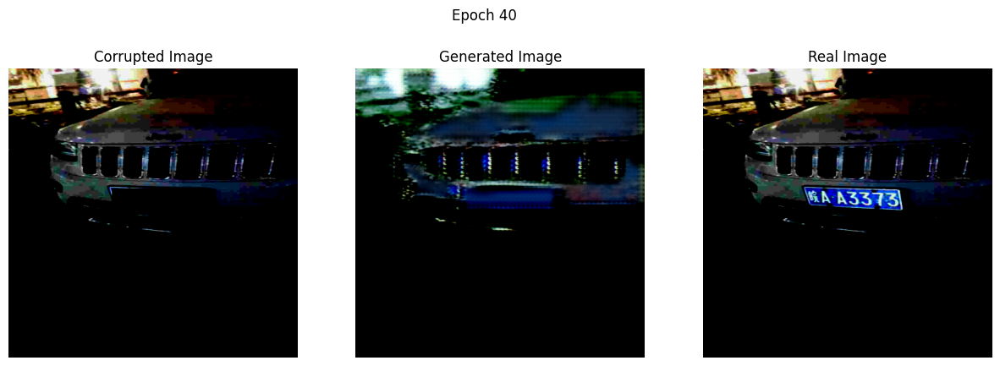

Epoch 41/100, d_loss: 0.7852704524993896, g_loss: 3.021956443786621
Epoch 42/100, d_loss: 0.5725997686386108, g_loss: 3.170276165008545
Epoch 43/100, d_loss: 1.0860097408294678, g_loss: 2.420109510421753
Epoch 44/100, d_loss: 0.8904523253440857, g_loss: 2.193105459213257
Epoch 45/100, d_loss: 0.29145753383636475, g_loss: 2.9101834297180176
Epoch 46/100, d_loss: 0.17461788654327393, g_loss: 3.6668479442596436
Epoch 47/100, d_loss: 0.883925199508667, g_loss: 3.632081985473633
Epoch 48/100, d_loss: 0.396689236164093, g_loss: 2.658222198486328
Epoch 49/100, d_loss: 0.5031605958938599, g_loss: 3.163557529449463


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 50/100, d_loss: 0.6242318749427795, g_loss: 2.003811836242676
Displaying images at epoch 50


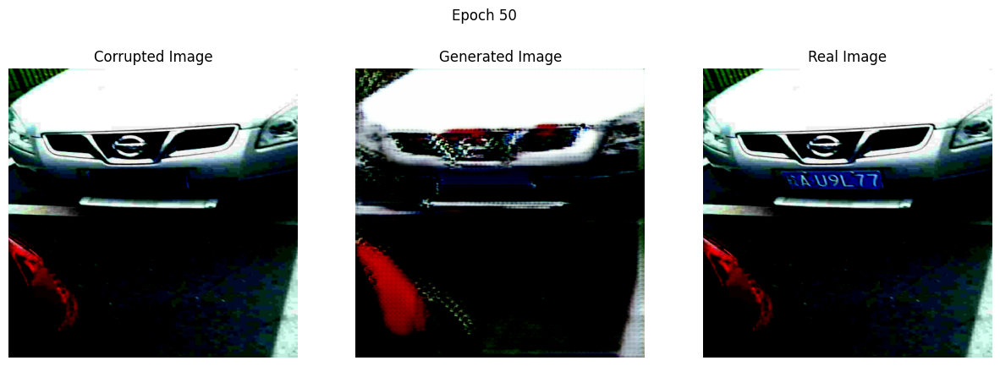

Epoch 51/100, d_loss: 0.31817078590393066, g_loss: 3.5799334049224854
Epoch 52/100, d_loss: 0.3056742250919342, g_loss: 3.884373903274536
Epoch 53/100, d_loss: 0.7093862891197205, g_loss: 2.5035386085510254
Epoch 54/100, d_loss: 0.19410152733325958, g_loss: 3.662346363067627
Epoch 55/100, d_loss: 0.4667218327522278, g_loss: 2.7876720428466797
Epoch 56/100, d_loss: 0.507780909538269, g_loss: 2.9315528869628906
Epoch 57/100, d_loss: 0.8503127098083496, g_loss: 3.8253650665283203
Epoch 58/100, d_loss: 0.6800590753555298, g_loss: 4.3151326179504395
Epoch 59/100, d_loss: 1.017937183380127, g_loss: 2.5311663150787354


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 60/100, d_loss: 0.15647593140602112, g_loss: 5.013144016265869
Displaying images at epoch 60


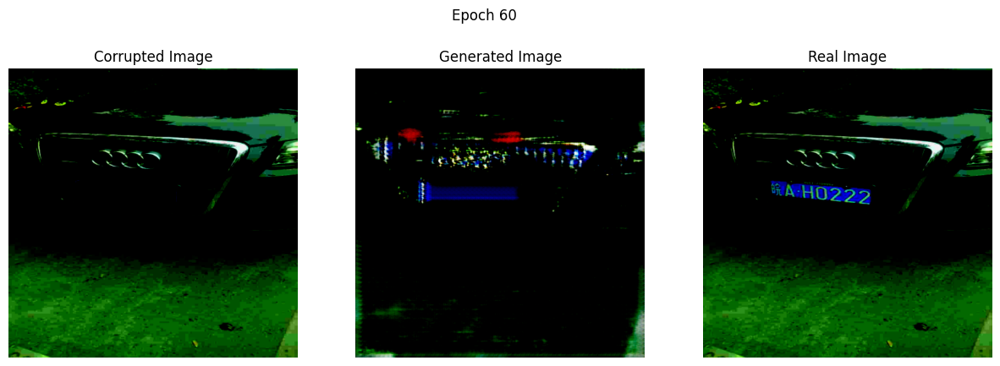

Epoch 61/100, d_loss: 0.35159292817115784, g_loss: 2.7804322242736816
Epoch 62/100, d_loss: 0.35579121112823486, g_loss: 3.330284833908081
Epoch 63/100, d_loss: 0.5870879292488098, g_loss: 2.519660472869873
Epoch 64/100, d_loss: 0.9721226692199707, g_loss: 6.407463550567627
Epoch 65/100, d_loss: 0.3677329421043396, g_loss: 3.5685834884643555
Epoch 66/100, d_loss: 0.5597106218338013, g_loss: 2.749922275543213
Epoch 67/100, d_loss: 0.1731545329093933, g_loss: 3.99221134185791
Epoch 68/100, d_loss: 0.5444375276565552, g_loss: 2.6021695137023926
Epoch 69/100, d_loss: 0.522113561630249, g_loss: 2.304732322692871


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 70/100, d_loss: 0.5180516242980957, g_loss: 4.599034309387207
Displaying images at epoch 70


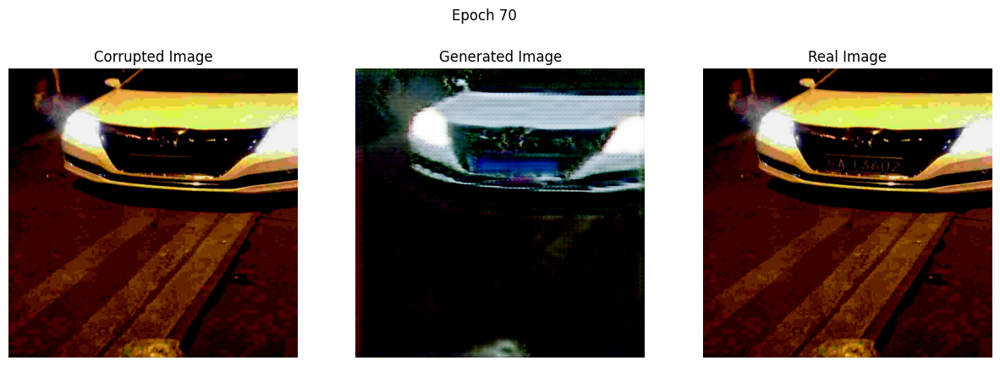

Epoch 71/100, d_loss: 1.1592434644699097, g_loss: 1.5478483438491821
Epoch 72/100, d_loss: 0.6271860599517822, g_loss: 6.081337928771973
Epoch 73/100, d_loss: 0.6642266511917114, g_loss: 4.154871940612793
Epoch 74/100, d_loss: 0.49202975630760193, g_loss: 4.513643264770508
Epoch 75/100, d_loss: 0.5095739364624023, g_loss: 2.5227065086364746
Epoch 76/100, d_loss: 0.5470995903015137, g_loss: 4.099190711975098
Epoch 77/100, d_loss: 1.065643310546875, g_loss: 4.128448963165283
Epoch 78/100, d_loss: 0.6156851053237915, g_loss: 2.404916286468506
Epoch 79/100, d_loss: 0.26437482237815857, g_loss: 4.353341102600098


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 80/100, d_loss: 0.16958032548427582, g_loss: 4.263783931732178
Displaying images at epoch 80


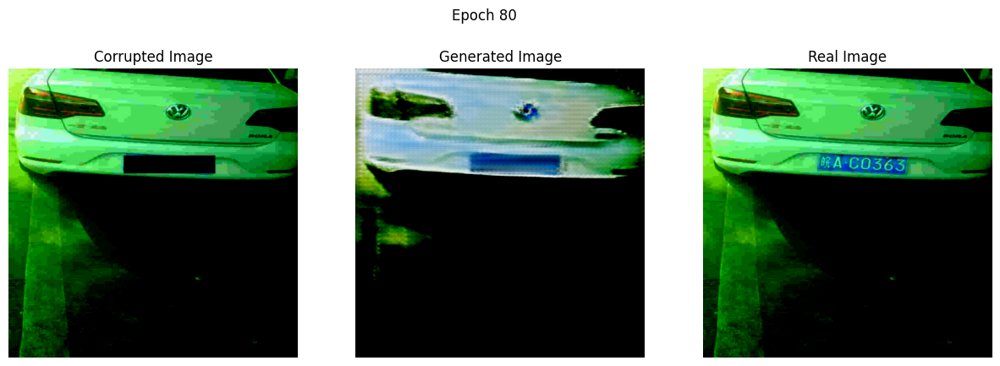

Epoch 81/100, d_loss: 0.22595243155956268, g_loss: 5.0868611335754395
Epoch 82/100, d_loss: 2.092569351196289, g_loss: 4.631284236907959
Epoch 83/100, d_loss: 0.6156563758850098, g_loss: 2.2157468795776367
Epoch 84/100, d_loss: 0.7826322913169861, g_loss: 2.83716082572937
Epoch 85/100, d_loss: 0.22464045882225037, g_loss: 4.324027061462402
Epoch 86/100, d_loss: 2.4087581634521484, g_loss: 7.76276969909668
Epoch 87/100, d_loss: 0.35130831599235535, g_loss: 3.126430034637451
Epoch 88/100, d_loss: 0.2696794867515564, g_loss: 3.860361337661743
Epoch 89/100, d_loss: 0.5048379898071289, g_loss: 2.755850315093994


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 90/100, d_loss: 0.8190982937812805, g_loss: 4.3147711753845215
Displaying images at epoch 90


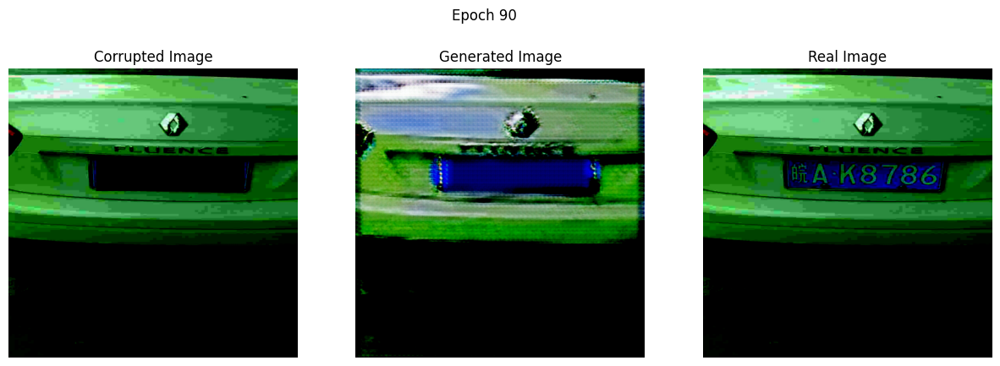

Epoch 91/100, d_loss: 0.3641921877861023, g_loss: 3.5628490447998047
Epoch 92/100, d_loss: 0.2137642204761505, g_loss: 3.849949359893799
Epoch 93/100, d_loss: 1.156251311302185, g_loss: 5.1479668617248535
Epoch 94/100, d_loss: 0.5459204912185669, g_loss: 3.347414016723633
Epoch 95/100, d_loss: 0.41045230627059937, g_loss: 4.108639240264893
Epoch 96/100, d_loss: 0.4677545726299286, g_loss: 2.6435697078704834
Epoch 97/100, d_loss: 0.44887396693229675, g_loss: 4.120785236358643
Epoch 98/100, d_loss: 0.7296346426010132, g_loss: 2.2569479942321777
Epoch 99/100, d_loss: 1.8817310333251953, g_loss: 3.7975902557373047


In [ ]:
generator = Generator_CCPD().cuda()
discriminator = Discriminator_CCPD().cuda()

train_gan(generator, discriminator, train_dataloader, extract_bbox, epochs=100, save_path="GAN_models")

In [ ]:
# import transforms
from torchvision import transforms

# torchvision.transforms.functional
import torchvision.transforms.functional as TF

def test_image_CCPD(generator_path, image_path, extract_bbox, output_path=None):

    model = Generator_CCPD()
    model.load_state_dict(torch.load(generator_path))
    model = model.to('cuda')


    # Load and transform the image
    image = Image.open(image_path)
    transform = transforms.Compose([
        transforms.Resize((512, 512)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
    real_image = transform(image).unsqueeze(0).cuda()

    # Create a mask for the license plate region
    xmin, ymin, xmax, ymax = extract_bbox(os.path.basename(image_path))
    width_scale = 512 / 720
    height_scale = 512 / 1160
    # Scale the bounding box coordinates
    xmin = int(xmin * width_scale)
    ymin = int(ymin * height_scale)
    xmax = int(xmax * width_scale)
    ymax = int(ymax * height_scale)
    mask = torch.zeros_like(real_image[0], device='cuda')
    mask[:, ymin:ymax, xmin:xmax] = 1

    # Apply the mask to create a corrupted input image
    input_image = apply_mask(real_image, mask)

    # Generate the inpainted image
    with torch.no_grad():
        output_image = generator(input_image).cpu()

    # Convert the output tensor to a PIL image
    output_image = TF.to_pil_image(output_image.squeeze(0) * 0.5 + 0.5)

    if output_path:
        # Save the output image
        output_image.save(output_path)

    # Display the input, corrupted, and output images
    import matplotlib.pyplot as plt

    corrupted_image = TF.to_pil_image(input_image.squeeze(0).cpu() * 0.5 + 0.5)

    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    axs[0].imshow(image)
    axs[0].set_title("Input Image")
    axs[1].imshow(corrupted_image)
    axs[1].set_title("Corrupted Image")
    axs[2].imshow(output_image)
    axs[2].set_title("Output Image")
    plt.show()


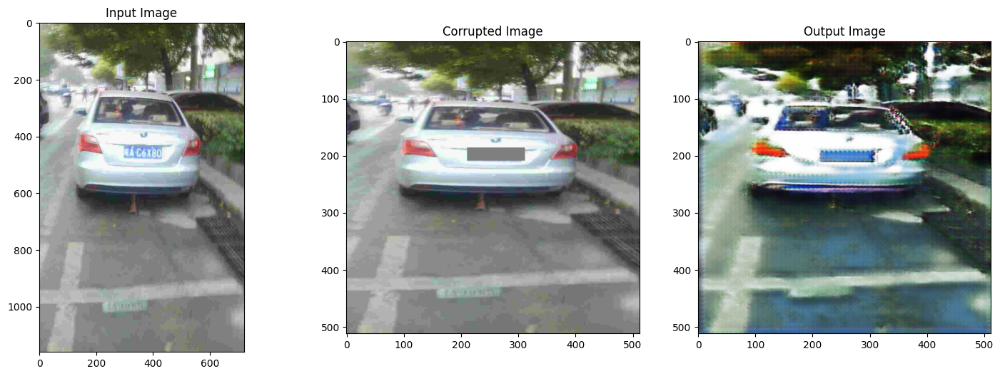

In [ ]:
test_image_CCPD("GAN_models/best_generator.pth", "datasets/CCPD2019/ccpd_testdata/005-90_91-298&425_440&477-434&485_297&479_299&429_436&435-0_0_2_30_21_32_24-191-5.jpg", extract_bbox)

In [ ]:
# !pip install segmentation-models-pytorch

#### Pretrained U-Net with Resnet encoder, Custom Discriminator, CCPD Dataset

In [ ]:
import segmentation_models_pytorch as smp

# Load a pre-trained U-Net model with a ResNet encoder
ResNetGenerator = smp.Unet(
    encoder_name="resnet34",        # Choose the encoder, e.g., "resnet34"
    encoder_weights="imagenet",      # Use pre-trained weights from ImageNet
    in_channels=3,                   # Number of input channels (3 for RGB images)
    classes=3,                       # Number of output channels (3 for RGB images)
).cuda()

class Discriminator_CCPD_resnet(nn.Module):
    def __init__(self):
        super(Discriminator_CCPD_resnet, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.Conv2d(256, 1, kernel_size=4, stride=1, padding=0),
            nn.AdaptiveAvgPool2d(1),
            nn.Sigmoid(),
        )

    def forward(self, x):
        x = self.main(x)
        return x.view(-1, 1)
    
discriminator = Discriminator_CCPD_resnet().cuda()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0/100, d_loss: 1.1833988428115845, g_loss: 2.236313581466675
Displaying images at epoch 0


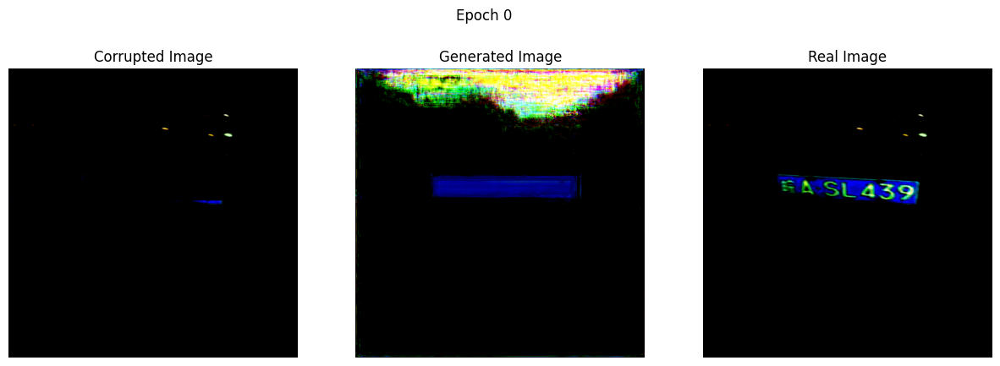

Epoch 1/100, d_loss: 1.4566302299499512, g_loss: 2.2116565704345703
Epoch 2/100, d_loss: 1.2438714504241943, g_loss: 2.1343636512756348
Epoch 3/100, d_loss: 1.5065007209777832, g_loss: 1.669050693511963
Epoch 4/100, d_loss: 1.2911956310272217, g_loss: 1.4117882251739502
Epoch 5/100, d_loss: 1.3412495851516724, g_loss: 1.6930336952209473
Epoch 6/100, d_loss: 1.101231336593628, g_loss: 1.4727604389190674
Epoch 7/100, d_loss: 1.2472995519638062, g_loss: 1.7439606189727783
Epoch 8/100, d_loss: 1.2355976104736328, g_loss: 1.7050200700759888
Epoch 9/100, d_loss: 1.4261507987976074, g_loss: 1.638018012046814


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10/100, d_loss: 1.1950268745422363, g_loss: 1.6752408742904663
Displaying images at epoch 10


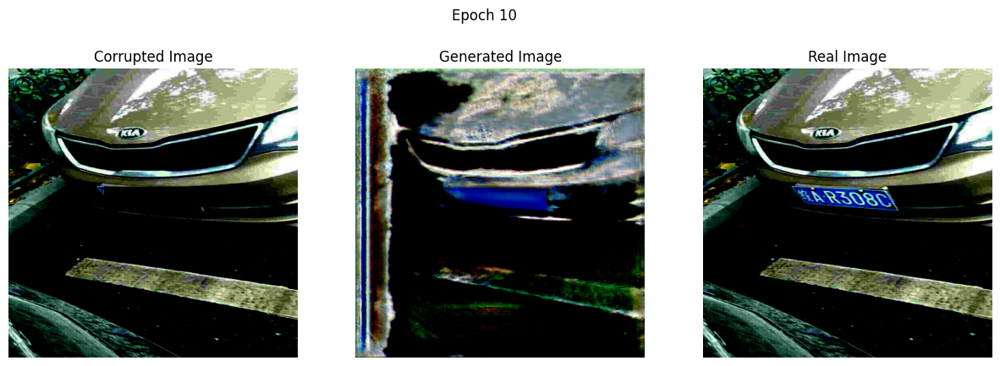

Epoch 11/100, d_loss: 1.283444881439209, g_loss: 1.3595519065856934
Epoch 12/100, d_loss: 1.1956760883331299, g_loss: 1.5662214756011963
Epoch 13/100, d_loss: 1.374536156654358, g_loss: 1.6724517345428467
Epoch 14/100, d_loss: 1.377233624458313, g_loss: 1.766418695449829
Epoch 15/100, d_loss: 1.4640567302703857, g_loss: 1.6497178077697754
Epoch 16/100, d_loss: 1.4167516231536865, g_loss: 1.343887209892273
Epoch 17/100, d_loss: 1.2797191143035889, g_loss: 1.6199352741241455
Epoch 18/100, d_loss: 1.524452567100525, g_loss: 1.6180939674377441
Epoch 19/100, d_loss: 1.4178712368011475, g_loss: 1.743580937385559


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20/100, d_loss: 1.2020310163497925, g_loss: 1.6589494943618774
Displaying images at epoch 20


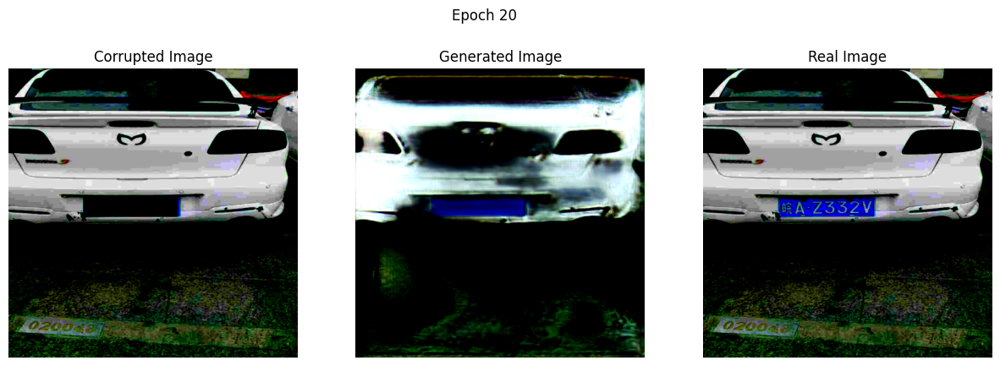

Epoch 21/100, d_loss: 1.2141492366790771, g_loss: 1.4885129928588867
Epoch 22/100, d_loss: 1.2792178392410278, g_loss: 1.549396276473999
Epoch 23/100, d_loss: 1.5028282403945923, g_loss: 1.5689659118652344
Epoch 24/100, d_loss: 1.2483681440353394, g_loss: 1.4595248699188232
Epoch 25/100, d_loss: 1.5234512090682983, g_loss: 1.516217589378357
Epoch 26/100, d_loss: 1.1976081132888794, g_loss: 1.8540000915527344
Epoch 27/100, d_loss: 1.260990858078003, g_loss: 1.6387842893600464
Epoch 28/100, d_loss: 1.2498230934143066, g_loss: 1.510817050933838
Epoch 29/100, d_loss: 1.2167296409606934, g_loss: 1.7048242092132568


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30/100, d_loss: 1.2563865184783936, g_loss: 1.8759056329727173
Displaying images at epoch 30


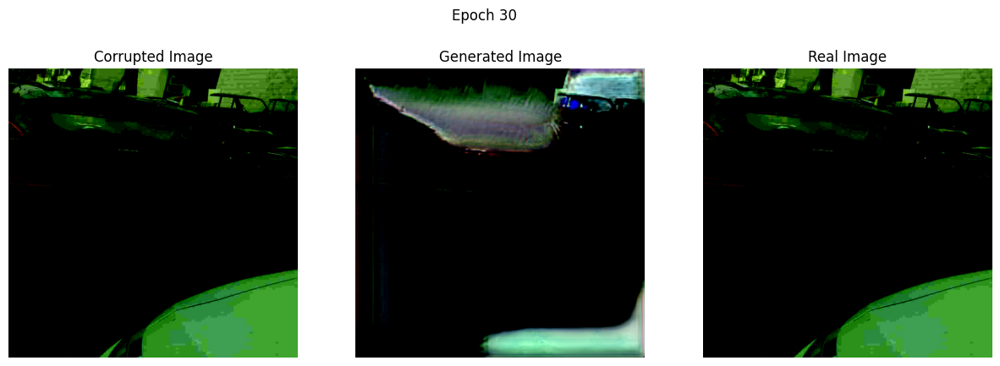

Epoch 31/100, d_loss: 1.1979053020477295, g_loss: 1.7145018577575684
Epoch 32/100, d_loss: 1.406235933303833, g_loss: 1.261965036392212
Epoch 33/100, d_loss: 1.3225443363189697, g_loss: 1.7607085704803467
Epoch 34/100, d_loss: 1.276902675628662, g_loss: 1.5007514953613281
Epoch 35/100, d_loss: 1.2478773593902588, g_loss: 1.4909639358520508
Epoch 36/100, d_loss: 1.1457725763320923, g_loss: 1.6481602191925049
Epoch 37/100, d_loss: 1.359860897064209, g_loss: 1.3844115734100342
Epoch 38/100, d_loss: 1.2703964710235596, g_loss: 1.8493597507476807
Epoch 39/100, d_loss: 1.1750261783599854, g_loss: 1.4780246019363403


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40/100, d_loss: 1.3882005214691162, g_loss: 1.6934324502944946
Displaying images at epoch 40


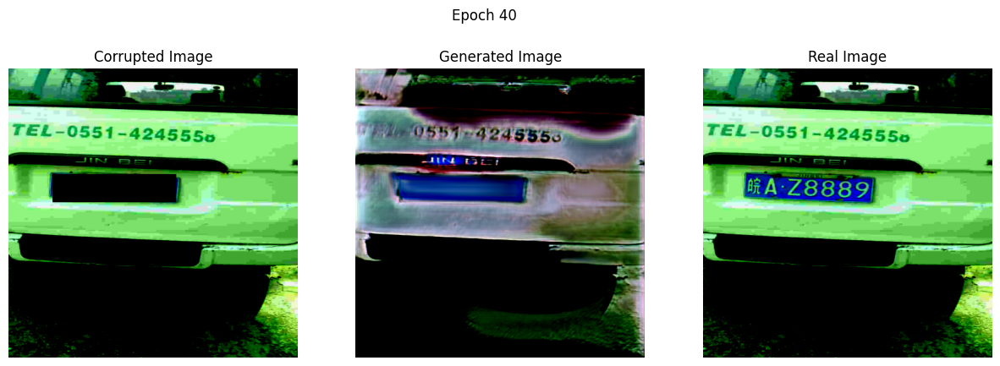

Epoch 41/100, d_loss: 1.209856629371643, g_loss: 1.5832980871200562
Epoch 42/100, d_loss: 1.1559076309204102, g_loss: 1.5292586088180542
Epoch 43/100, d_loss: 1.2153000831604004, g_loss: 1.747281789779663
Epoch 44/100, d_loss: 1.3065440654754639, g_loss: 1.3224775791168213
Epoch 45/100, d_loss: 1.0932462215423584, g_loss: 1.8179234266281128
Epoch 46/100, d_loss: 1.183632493019104, g_loss: 1.4298776388168335
Epoch 47/100, d_loss: 1.5169517993927002, g_loss: 1.7785409688949585
Epoch 48/100, d_loss: 1.1979386806488037, g_loss: 1.860106110572815
Epoch 49/100, d_loss: 1.5297722816467285, g_loss: 1.58414888381958


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 50/100, d_loss: 1.2272809743881226, g_loss: 1.5839109420776367
Displaying images at epoch 50


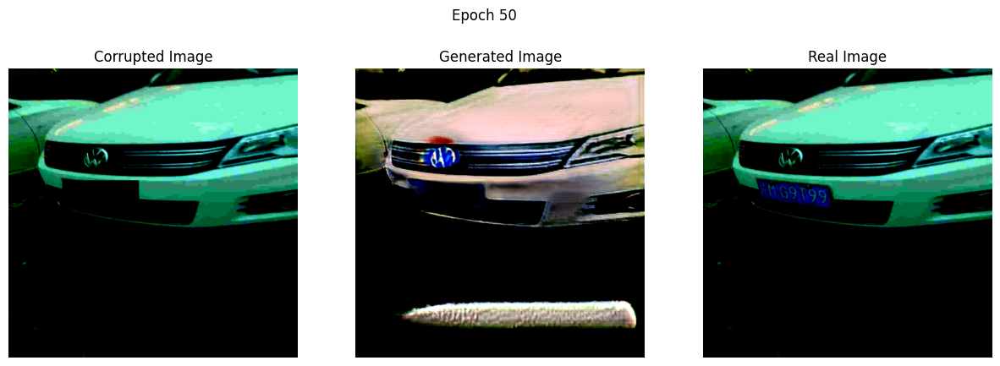

Epoch 51/100, d_loss: 0.9282836318016052, g_loss: 1.664324164390564
Epoch 52/100, d_loss: 1.4453015327453613, g_loss: 2.1029319763183594
Epoch 53/100, d_loss: 0.9466710090637207, g_loss: 1.6370359659194946
Epoch 54/100, d_loss: 1.0179368257522583, g_loss: 1.67634916305542
Epoch 55/100, d_loss: 1.398825764656067, g_loss: 1.538360834121704
Epoch 56/100, d_loss: 1.1481508016586304, g_loss: 1.5627424716949463
Epoch 57/100, d_loss: 1.2093043327331543, g_loss: 1.6127183437347412
Epoch 58/100, d_loss: 1.483083724975586, g_loss: 1.469775676727295
Epoch 59/100, d_loss: 1.5207655429840088, g_loss: 1.388157844543457


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 60/100, d_loss: 1.1390188932418823, g_loss: 1.4486370086669922
Displaying images at epoch 60


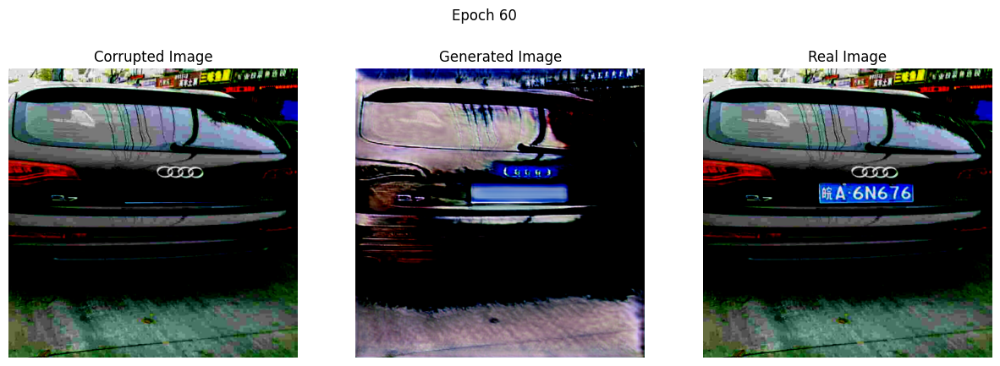

Epoch 61/100, d_loss: 1.2923489809036255, g_loss: 1.5855706930160522
Epoch 62/100, d_loss: 0.9776290655136108, g_loss: 2.1196255683898926
Epoch 63/100, d_loss: 1.4199001789093018, g_loss: 1.9427422285079956
Epoch 64/100, d_loss: 1.3846147060394287, g_loss: 1.2858808040618896
Epoch 65/100, d_loss: 1.1823413372039795, g_loss: 2.322981357574463
Epoch 66/100, d_loss: 1.1080361604690552, g_loss: 1.6524862051010132
Epoch 67/100, d_loss: 0.7775615453720093, g_loss: 2.135314464569092
Epoch 68/100, d_loss: 0.7492035627365112, g_loss: 1.7930316925048828
Epoch 69/100, d_loss: 1.0112004280090332, g_loss: 1.5624971389770508
Epoch 70/100, d_loss: 1.02779221534729, g_loss: 1.652435302734375
Displaying images at epoch 70


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


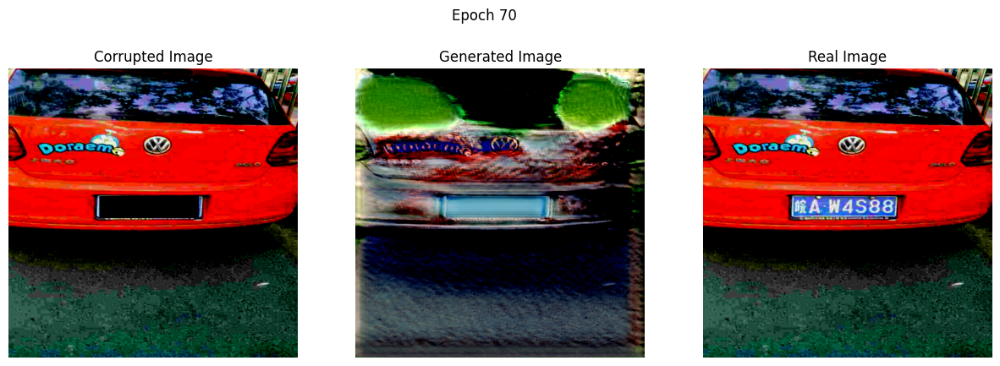

Epoch 71/100, d_loss: 1.1786082983016968, g_loss: 1.773407220840454
Epoch 72/100, d_loss: 1.0720808506011963, g_loss: 1.7905447483062744
Epoch 73/100, d_loss: 1.1449326276779175, g_loss: 1.7086939811706543
Epoch 74/100, d_loss: 1.2673840522766113, g_loss: 1.6262365579605103
Epoch 75/100, d_loss: 1.1115493774414062, g_loss: 1.8678317070007324
Epoch 76/100, d_loss: 1.2639338970184326, g_loss: 1.8268616199493408
Epoch 77/100, d_loss: 1.075852632522583, g_loss: 1.557396411895752
Epoch 78/100, d_loss: 1.2714815139770508, g_loss: 1.4911341667175293
Epoch 79/100, d_loss: 1.2658822536468506, g_loss: 1.7939565181732178


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 80/100, d_loss: 1.0259183645248413, g_loss: 1.7009270191192627
Displaying images at epoch 80


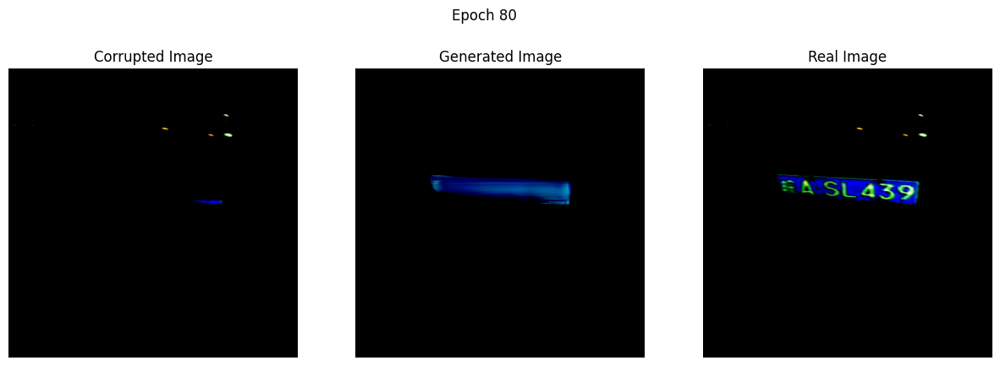

Epoch 81/100, d_loss: 1.012574315071106, g_loss: 1.7289223670959473
Epoch 82/100, d_loss: 1.2307558059692383, g_loss: 1.747643232345581
Epoch 83/100, d_loss: 1.4717764854431152, g_loss: 1.2877169847488403
Epoch 84/100, d_loss: 1.0333318710327148, g_loss: 2.1946964263916016
Epoch 85/100, d_loss: 1.923938274383545, g_loss: 2.0853271484375
Epoch 86/100, d_loss: 1.51253342628479, g_loss: 1.6145713329315186
Epoch 87/100, d_loss: 1.127971887588501, g_loss: 2.0593113899230957
Epoch 88/100, d_loss: 1.6017063856124878, g_loss: 1.8483048677444458
Epoch 89/100, d_loss: 1.4349627494812012, g_loss: 1.4790129661560059


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 90/100, d_loss: 1.1114935874938965, g_loss: 1.9154431819915771
Displaying images at epoch 90


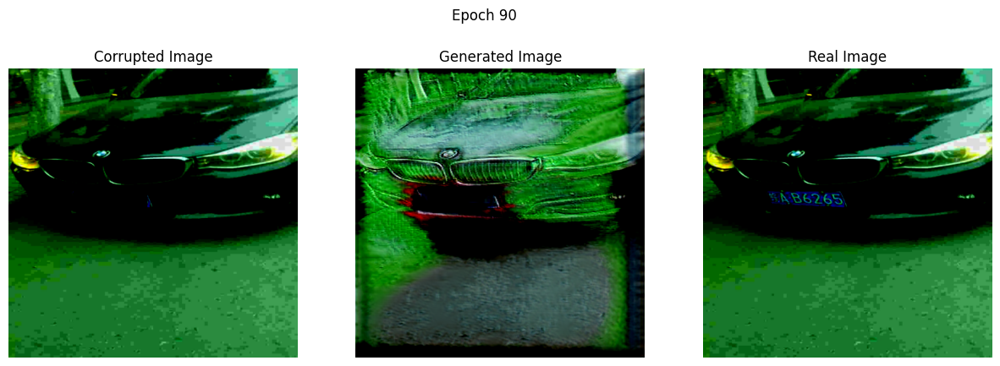

Epoch 91/100, d_loss: 1.665021538734436, g_loss: 1.9267373085021973
Epoch 92/100, d_loss: 1.445430040359497, g_loss: 1.7297852039337158
Epoch 93/100, d_loss: 1.0120686292648315, g_loss: 1.9499306678771973
Epoch 94/100, d_loss: 1.423479437828064, g_loss: 1.8972822427749634
Epoch 95/100, d_loss: 1.1454977989196777, g_loss: 1.6430461406707764
Epoch 96/100, d_loss: 1.0740621089935303, g_loss: 1.7018038034439087
Epoch 97/100, d_loss: 1.1807698011398315, g_loss: 1.8025712966918945
Epoch 98/100, d_loss: 1.151231050491333, g_loss: 1.4386200904846191
Epoch 99/100, d_loss: 1.1650607585906982, g_loss: 2.0467469692230225


In [ ]:
train_gan(ResNetGenerator, discriminator, train_dataloader, extract_bbox, epochs=100, save_path="GAN_models/Unet-resnet34")

In [ ]:
import torch
from torchvision.transforms import functional as TF

def test_image_ResNet(generator_path, image_path, extract_bbox, output_path=None):

    model = smp.Unet(
        encoder_name="resnet34",
        encoder_weights="imagenet",
        in_channels=3,
        classes=3,
    ).cuda()

    model.load_state_dict(torch.load(generator_path))
    model.eval()

    # Load and transform the image
    image = Image.open(image_path)
    transform = transforms.Compose([
        transforms.Resize((512, 512)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
    real_image = transform(image).unsqueeze(0).cuda()

    # Create a mask for the license plate region
    xmin, ymin, xmax, ymax =extract_bbox(os.path.basename(image_path))
    width_scale = 512 / 720
    height_scale = 512 / 1160
    # Scale the bounding box coordinates
    xmin = int(xmin * width_scale)
    ymin = int(ymin * height_scale)
    xmax = int(xmax * width_scale)
    ymax = int(ymax * height_scale)
    mask = torch.zeros_like(real_image[0], device='cuda')
    mask[:, ymin:ymax, xmin:xmax] = 1

    # Apply the mask to create a corrupted input image
    input_image = apply_mask(real_image, mask)

    # Generate the inpainted image
    with torch.no_grad():
        output_image = model(input_image).cpu()

    # Convert the output tensor to a PIL image
    output_image = TF.to_pil_image(output_image.squeeze(0) * 0.5 + 0.5)

    if output_path:
        # Save the output image
        output_image.save(output_path)

    # Display the input, corrupted, and output images
    import matplotlib.pyplot as plt

    corrupted_image = TF.to_pil_image(input_image.squeeze(0).cpu() * 0.5 + 0.5)

    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    axs[0].imshow(image)
    axs[0].set_title("Input Image")
    axs[1].imshow(corrupted_image)
    axs[1].set_title("Corrupted Image")
    axs[2].imshow(output_image)
    axs[2].set_title("Output Image")
    plt.show()


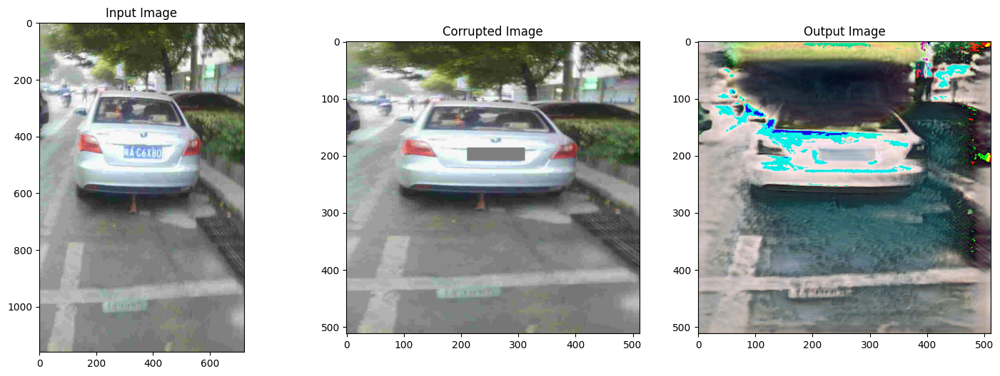

In [ ]:
test_image_ResNet("GAN_models/Unet-resnet34/best_generator.pth", "datasets/CCPD2019/ccpd_testdata/005-90_91-298&425_440&477-434&485_297&479_299&429_436&435-0_0_2_30_21_32_24-191-5.jpg", extract_bbox)

#### Generator and Discriminator, Kaggle Dataset

In [ ]:
class LicensePlateDataset(Dataset):
    def __init__(self, image_paths, transform=None):
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        image = Image.open(image_path).convert("RGB")


        if self.transform:
            image = self.transform(image)

        return image, image_path


transform = Compose([
    Resize((512, 512)),
    ToTensor(),
    Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

folder_path = "datasets/dataset1/images"

train_paths = glob.glob(os.path.join(os.path.join(folder_path, "train"), "*.png"))
train_dataset = LicensePlateDataset(train_paths, transform)
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=8, shuffle=True)

val_paths = glob.glob(os.path.join(os.path.join(folder_path, "val"), "*.png"))
val_dataset = LicensePlateDataset(val_paths, transform)
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=8, shuffle=True)

In [ ]:
import torch.nn as nn

class Generator_Kaggle(nn.Module):
    def __init__(self):
        super(Generator_Kaggle, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
        )
        
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1),
            nn.Tanh(),
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

class Discriminator_Kaggle(nn.Module):
    def __init__(self):
        super(Discriminator_Kaggle, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.Conv2d(256, 1, kernel_size=4, stride=1, padding=0),
            nn.AdaptiveAvgPool2d(1),
            nn.Sigmoid(),
        )

    def forward(self, x):
        x = self.main(x)
        return x.view(-1, 1)


In [ ]:
import torch.optim as optim
import math

def xml_bbox(name):
    anno = "datasets/dataset1/annotations"
    # find the xml file with name
    for file in os.listdir(anno):
        if file[:-4] == name[:-4]:
            info = xet.parse(os.path.join(anno, file))
            root = info.getroot()
            size_object = root.find('size')
            width = int(size_object.find('width').text)
            height = int(size_object.find('height').text)
            member_object = root.find('object')
            labels_info = member_object.find('bndbox')
            xmin = int(labels_info.find('xmin').text)
            xmax = int(labels_info.find('xmax').text)
            ymin = int(labels_info.find('ymin').text)
            ymax = int(labels_info.find('ymax').text)
    return xmin, ymin, xmax, ymax, width, height

def imshow(img):
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

def apply_mask(images, mask):
    return images * (1 - mask)

def masked_l1_loss(real, generated, mask):
    return torch.mean(torch.abs((generated - real) * mask))

def display_images(corrupted, generated, real, epoch):
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    
    corrupted_np = torchvision.utils.make_grid(corrupted[:1], nrow=1).cpu().numpy()
    axs[0].imshow(np.transpose(corrupted_np, (1, 2, 0)))
    axs[0].set_title('Corrupted Image')
    axs[0].axis('off')
    
    generated_np = torchvision.utils.make_grid(generated[:1].detach(), nrow=1).cpu().numpy()
    axs[1].imshow(np.transpose(generated_np, (1, 2, 0)))
    axs[1].set_title('Generated Image')
    axs[1].axis('off')
    
    real_np = torchvision.utils.make_grid(real[:1], nrow=1).cpu().numpy()
    axs[2].imshow(np.transpose(real_np, (1, 2, 0)))
    axs[2].set_title('Real Image')
    axs[2].axis('off')
    
    plt.suptitle(f'Epoch {epoch}')
    plt.show()

def compute_validation_loss(generator, dataloader, extract_bbox):
    criterion = nn.BCELoss()
    loss = 0.0
    count = 0

    with torch.no_grad():
        for images, image_paths in dataloader:
            real_images = images.cuda()
            real_labels = torch.ones(real_images.size(0), 1).cuda()

            # Create masks for license plate regions
            masks = []
            for path in image_paths:
                xmin, ymin, xmax, ymax, width, height = xml_bbox(os.path.basename(path))
                width_scale = 512 / width
                height_scale = 512 / height
                # Scale the bounding box coordinates
                xmin = int(xmin * width_scale)
                ymin = int(ymin * height_scale)
                xmax = int(xmax * width_scale)
                ymax = int(ymax * height_scale)
                mask = torch.zeros_like(real_images[0], device='cuda')
                mask[:, ymin:ymax, xmin:xmax] = 1
                masks.append(mask)
            masks = torch.stack(masks)

            # Apply masks to create corrupted images
            corrupted_images = apply_mask(real_images, masks)

            # Compute generator loss on corrupted images
            fake_images = generator(corrupted_images)
            g_loss = criterion(discriminator(fake_images), real_labels)

            loss += g_loss.item() * real_images.size(0)
            count += real_images.size(0)

    return loss / count


def train_gan_kaggle(generator, discriminator, dataloader, extract_bbox, epochs=100, save_path=None):
    criterion = nn.BCELoss()
    optimizer_g = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    optimizer_d = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    best_loss = math.inf
    best_generator_state = None
    display_interval = 10  # Choose the interval at which you want to display the images (e.g., every 5 epochs)

    for epoch in range(epochs):
        for i, (images, image_paths) in enumerate(dataloader):
            real_images = images.cuda()
            real_labels = torch.ones(real_images.size(0), 1).cuda()

            # Create masks for license plate regions
            masks = []
            for path in image_paths:
                xmin, ymin, xmax, ymax, width, height = xml_bbox(os.path.basename(path))
                width_scale = 512 / width
                height_scale = 512 / height
                # Scale the bounding box coordinates
                xmin = int(xmin * width_scale)
                ymin = int(ymin * height_scale)
                xmax = int(xmax * width_scale)
                ymax = int(ymax * height_scale)
                mask = torch.zeros_like(real_images[0], device='cuda')
                mask[:, ymin:ymax, xmin:xmax] = 1
                masks.append(mask)
            masks = torch.stack(masks)

            # Apply masks to create corrupted images
            corrupted_images = apply_mask(real_images, masks)

            lambda_l1 = 100  # You can experiment with different values

            # Train generator
            optimizer_g.zero_grad()
            fake_images = generator(corrupted_images)
            fake_labels = torch.zeros(real_images.size(0), 1).cuda()
            g_bce_loss = criterion(discriminator(fake_images), real_labels)
            g_l1_loss = masked_l1_loss(real_images, fake_images, masks) * lambda_l1
            g_loss = g_bce_loss + g_l1_loss
            g_loss.backward()
            optimizer_g.step()

            # Train discriminator
            optimizer_d.zero_grad()
            real_loss = criterion(discriminator(real_images), real_labels)
            fake_loss = criterion(discriminator(fake_images.detach()), fake_labels)
            d_loss = real_loss + fake_loss
            d_loss.backward()
            optimizer_d.step()

        if save_path is not None:
            val_loss = compute_validation_loss(generator, val_dataloader, extract_bbox)
            if val_loss < best_loss:
                best_loss = val_loss
                best_generator_state = generator.state_dict()
                torch.save(best_generator_state, os.path.join(save_path, "best_generator.pth"))

        print(f"Epoch {epoch}/{epochs}, d_loss: {d_loss.item()}, g_loss: {g_loss.item()}")

        if epoch % display_interval == 0:
            print(f"Displaying images at epoch {epoch}")
            display_images(corrupted_images, fake_images, real_images, epoch)



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0/100, d_loss: 0.8972499966621399, g_loss: 4.273706436157227
Displaying images at epoch 0


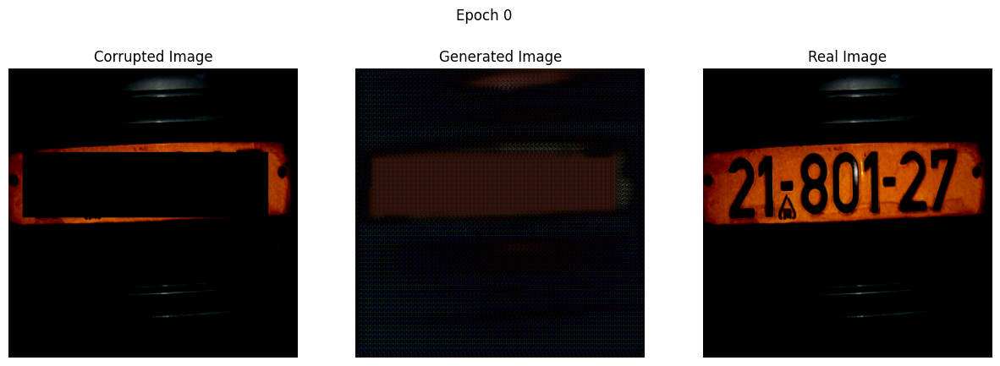

Epoch 1/100, d_loss: 1.0288336277008057, g_loss: 3.52475643157959
Epoch 2/100, d_loss: 0.9481866359710693, g_loss: 2.3508355617523193
Epoch 3/100, d_loss: 1.1814377307891846, g_loss: 2.5222737789154053
Epoch 4/100, d_loss: 1.006349802017212, g_loss: 1.811741590499878
Epoch 5/100, d_loss: 0.8725733757019043, g_loss: 9.932426452636719
Epoch 6/100, d_loss: 0.8487227559089661, g_loss: 2.8730177879333496
Epoch 7/100, d_loss: 1.1435203552246094, g_loss: 3.0063600540161133
Epoch 8/100, d_loss: 1.8373703956604004, g_loss: 4.402863502502441
Epoch 9/100, d_loss: 1.1224225759506226, g_loss: 2.4890241622924805


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10/100, d_loss: 1.0863059759140015, g_loss: 2.99397873878479
Displaying images at epoch 10


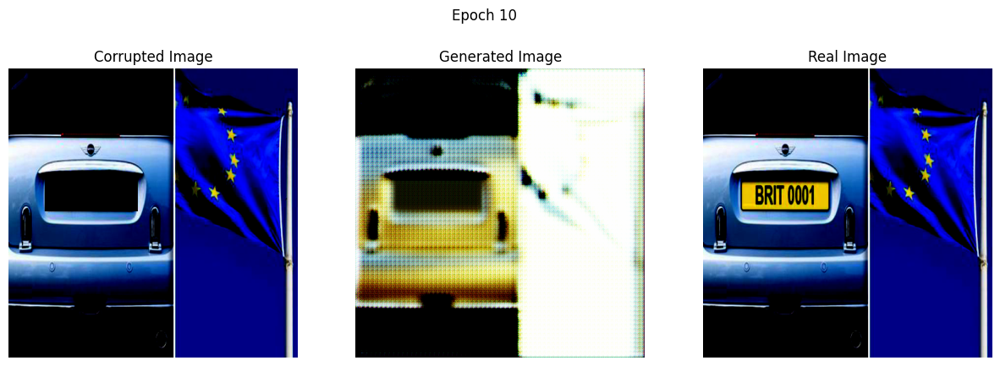

Epoch 11/100, d_loss: 0.8418929576873779, g_loss: 5.048373699188232
Epoch 12/100, d_loss: 0.8515232801437378, g_loss: 2.850325584411621
Epoch 13/100, d_loss: 1.0828908681869507, g_loss: 2.76129150390625
Epoch 14/100, d_loss: 0.8642899990081787, g_loss: 2.1024773120880127
Epoch 15/100, d_loss: 1.5029515027999878, g_loss: 3.8793206214904785
Epoch 16/100, d_loss: 1.5967178344726562, g_loss: 2.1344292163848877
Epoch 17/100, d_loss: 0.7524850964546204, g_loss: 8.71835708618164
Epoch 18/100, d_loss: 0.5755225419998169, g_loss: 2.204392433166504
Epoch 19/100, d_loss: 0.43546435236930847, g_loss: 4.238582611083984


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20/100, d_loss: 0.7886106967926025, g_loss: 2.4391777515411377
Displaying images at epoch 20


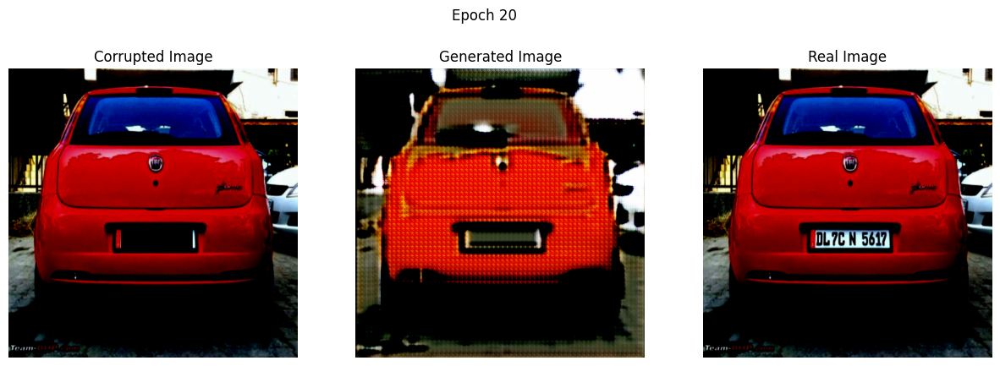

Epoch 21/100, d_loss: 0.366746187210083, g_loss: 3.8595874309539795
Epoch 22/100, d_loss: 0.45877963304519653, g_loss: 2.486391544342041
Epoch 23/100, d_loss: 0.6685830354690552, g_loss: 7.658538818359375
Epoch 24/100, d_loss: 0.7437263131141663, g_loss: 9.75011157989502
Epoch 25/100, d_loss: 0.6959923505783081, g_loss: 10.976700782775879
Epoch 26/100, d_loss: 0.6608363389968872, g_loss: 2.499026298522949
Epoch 27/100, d_loss: 0.3212142288684845, g_loss: 2.476529359817505
Epoch 28/100, d_loss: 0.456399530172348, g_loss: 5.629068374633789
Epoch 29/100, d_loss: 0.2807431221008301, g_loss: 5.325803756713867


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30/100, d_loss: 0.7479612827301025, g_loss: 3.365044593811035
Displaying images at epoch 30


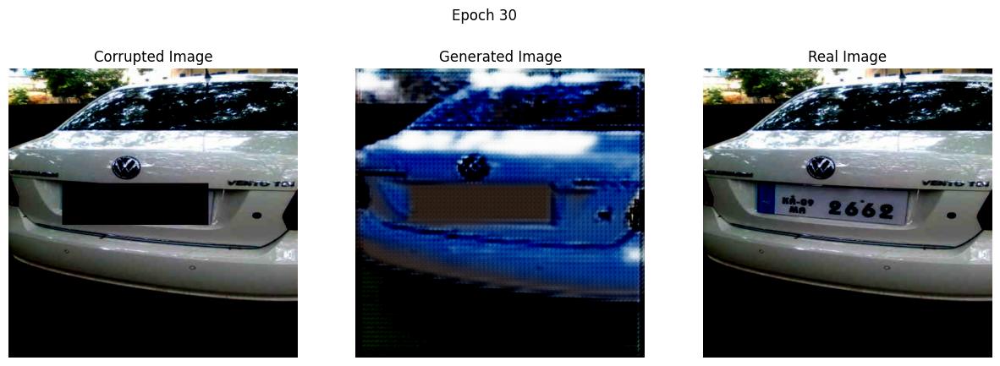

Epoch 31/100, d_loss: 0.48959845304489136, g_loss: 2.886658191680908
Epoch 32/100, d_loss: 0.5843144655227661, g_loss: 2.6882386207580566
Epoch 33/100, d_loss: 0.3926502764225006, g_loss: 2.777311325073242
Epoch 34/100, d_loss: 1.6703332662582397, g_loss: 3.6130316257476807
Epoch 35/100, d_loss: 0.9536117315292358, g_loss: 2.6414361000061035
Epoch 36/100, d_loss: 0.4186861217021942, g_loss: 3.213290214538574
Epoch 37/100, d_loss: 0.7436545491218567, g_loss: 3.5059704780578613
Epoch 38/100, d_loss: 0.8326605558395386, g_loss: 5.668149948120117
Epoch 39/100, d_loss: 0.49845999479293823, g_loss: 9.037979125976562


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40/100, d_loss: 1.0866377353668213, g_loss: 3.3667585849761963
Displaying images at epoch 40


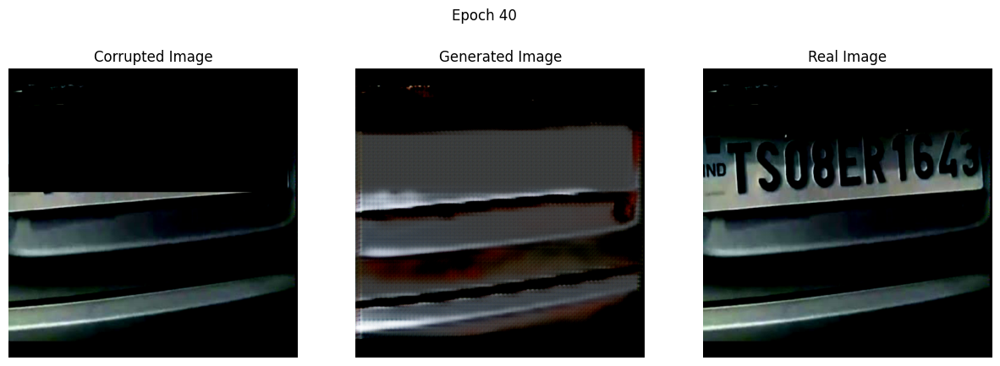

Epoch 41/100, d_loss: 0.623478889465332, g_loss: 6.966056823730469
Epoch 42/100, d_loss: 0.30161070823669434, g_loss: 2.7701961994171143
Epoch 43/100, d_loss: 0.2663360834121704, g_loss: 4.2564897537231445
Epoch 44/100, d_loss: 0.8271007537841797, g_loss: 3.698368787765503
Epoch 45/100, d_loss: 0.8125598430633545, g_loss: 9.511354446411133
Epoch 46/100, d_loss: 0.5476953387260437, g_loss: 1.9380873441696167
Epoch 47/100, d_loss: 1.171402931213379, g_loss: 4.796976089477539
Epoch 48/100, d_loss: 0.2749965190887451, g_loss: 3.5741851329803467
Epoch 49/100, d_loss: 0.22108376026153564, g_loss: 6.193394184112549


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 50/100, d_loss: 0.40533119440078735, g_loss: 2.907862663269043
Displaying images at epoch 50


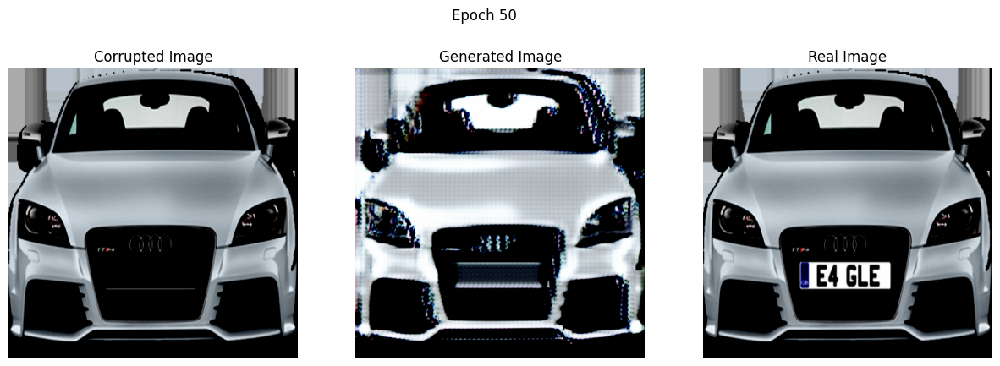

Epoch 51/100, d_loss: 0.23602750897407532, g_loss: 5.617109298706055
Epoch 52/100, d_loss: 0.1650727391242981, g_loss: 9.842830657958984
Epoch 53/100, d_loss: 0.22324994206428528, g_loss: 8.250343322753906
Epoch 54/100, d_loss: 0.29986947774887085, g_loss: 2.8913629055023193
Epoch 55/100, d_loss: 0.4900187849998474, g_loss: 3.6742000579833984
Epoch 56/100, d_loss: 0.516589879989624, g_loss: 2.621199369430542
Epoch 57/100, d_loss: 0.5496926307678223, g_loss: 3.151965379714966
Epoch 58/100, d_loss: 0.44678404927253723, g_loss: 2.6054768562316895
Epoch 59/100, d_loss: 0.861714243888855, g_loss: 3.369112968444824


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 60/100, d_loss: 0.3690325915813446, g_loss: 3.2585058212280273
Displaying images at epoch 60


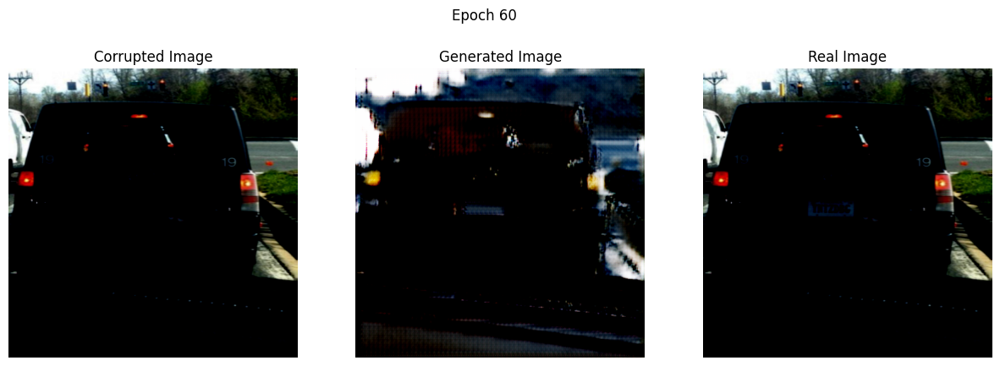

Epoch 61/100, d_loss: 0.7021183967590332, g_loss: 3.3262431621551514
Epoch 62/100, d_loss: 0.8270037174224854, g_loss: 2.171952962875366
Epoch 63/100, d_loss: 0.2959117591381073, g_loss: 3.6310343742370605
Epoch 64/100, d_loss: 1.8170989751815796, g_loss: 9.598578453063965
Epoch 65/100, d_loss: 0.44622889161109924, g_loss: 2.4419307708740234
Epoch 66/100, d_loss: 0.7543826103210449, g_loss: 1.227613925933838
Epoch 67/100, d_loss: 0.3833509087562561, g_loss: 3.5756397247314453
Epoch 68/100, d_loss: 1.4087638854980469, g_loss: 4.561828136444092
Epoch 69/100, d_loss: 0.6626982688903809, g_loss: 3.1736836433410645
Epoch 70/100, d_loss: 0.7356946468353271, g_loss: 4.64951229095459
Displaying images at epoch 70


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


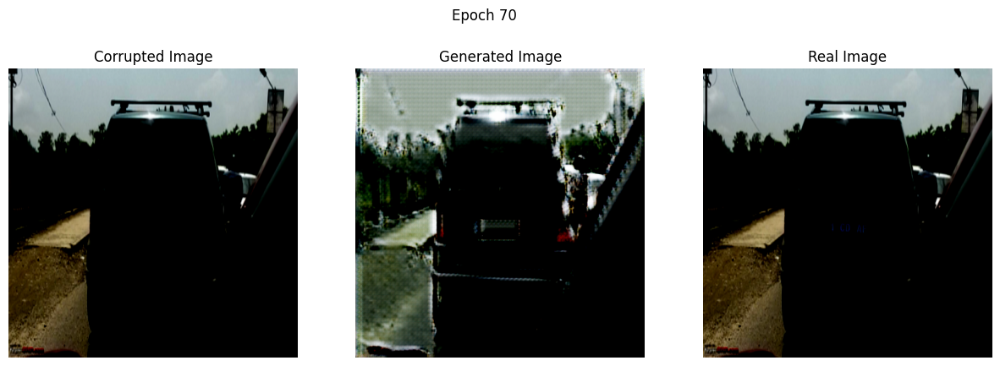

Epoch 71/100, d_loss: 0.4351692199707031, g_loss: 2.711663007736206
Epoch 72/100, d_loss: 0.7850824594497681, g_loss: 1.7540568113327026
Epoch 73/100, d_loss: 0.46420538425445557, g_loss: 4.646458625793457
Epoch 74/100, d_loss: 0.3407321572303772, g_loss: 4.708878517150879
Epoch 75/100, d_loss: 0.49898141622543335, g_loss: 4.098640441894531
Epoch 76/100, d_loss: 0.8266682624816895, g_loss: 3.797407865524292
Epoch 77/100, d_loss: 0.3534115254878998, g_loss: 6.128974437713623
Epoch 78/100, d_loss: 0.37521225214004517, g_loss: 6.6258111000061035
Epoch 79/100, d_loss: 0.5349108576774597, g_loss: 3.913435459136963


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 80/100, d_loss: 0.3943355083465576, g_loss: 4.440266132354736
Displaying images at epoch 80


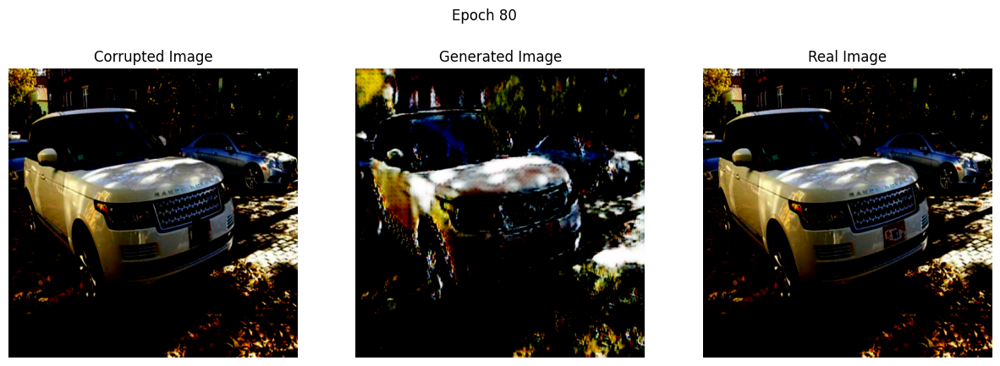

Epoch 81/100, d_loss: 0.8033801317214966, g_loss: 2.8156614303588867
Epoch 82/100, d_loss: 0.858191192150116, g_loss: 3.9269871711730957
Epoch 83/100, d_loss: 0.36086732149124146, g_loss: 4.4425249099731445
Epoch 84/100, d_loss: 0.49906665086746216, g_loss: 3.9798178672790527
Epoch 85/100, d_loss: 0.3086867034435272, g_loss: 3.5558104515075684
Epoch 86/100, d_loss: 0.4648802876472473, g_loss: 4.0303802490234375
Epoch 87/100, d_loss: 0.5214598774909973, g_loss: 1.5478849411010742
Epoch 88/100, d_loss: 0.3815082609653473, g_loss: 9.394867897033691
Epoch 89/100, d_loss: 0.32214364409446716, g_loss: 3.027416467666626


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 90/100, d_loss: 0.6432329416275024, g_loss: 4.441944122314453
Displaying images at epoch 90


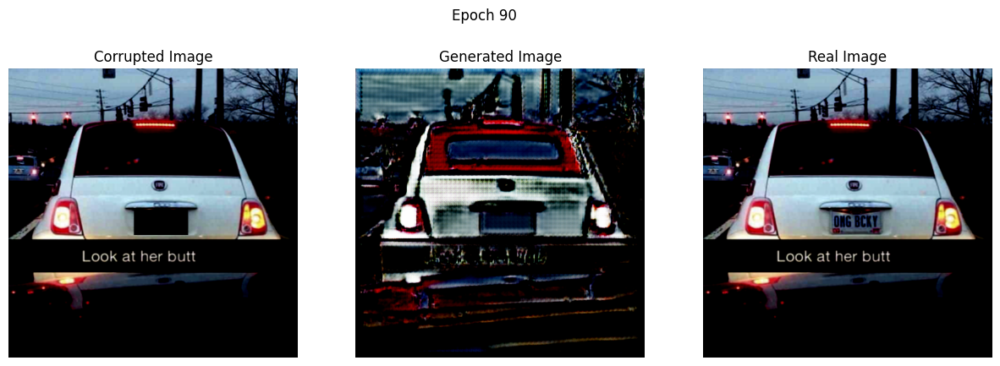

Epoch 91/100, d_loss: 0.5743116140365601, g_loss: 1.745160460472107
Epoch 92/100, d_loss: 0.6874761581420898, g_loss: 3.6555891036987305
Epoch 93/100, d_loss: 0.6106610298156738, g_loss: 3.5692124366760254
Epoch 94/100, d_loss: 0.08310017734766006, g_loss: 6.398820877075195
Epoch 95/100, d_loss: 1.8785598278045654, g_loss: 4.658825874328613
Epoch 96/100, d_loss: 0.7991162538528442, g_loss: 2.652006149291992
Epoch 97/100, d_loss: 0.2673693001270294, g_loss: 4.672792434692383
Epoch 98/100, d_loss: 0.6714372634887695, g_loss: 2.8307454586029053
Epoch 99/100, d_loss: 0.6393386125564575, g_loss: 3.487292766571045


In [ ]:
generator = Generator_Kaggle().cuda()
discriminator = Discriminator_Kaggle().cuda()

train_gan_kaggle(generator, discriminator, train_dataloader, extract_bbox, epochs=100, save_path="GAN_models/kaggle")

In [ ]:
from torchvision import transforms
import torchvision.transforms.functional as TF

def xml_bbox(name):
    anno = "datasets/dataset1/annotations"
    # find the xml file with name
    for file in os.listdir(anno):
        if file[:-4] == name[:-4]:
            info = xet.parse(os.path.join(anno, file))
            root = info.getroot()
            size_object = root.find('size')
            width = int(size_object.find('width').text)
            height = int(size_object.find('height').text)
            member_object = root.find('object')
            labels_info = member_object.find('bndbox')
            xmin = int(labels_info.find('xmin').text)
            xmax = int(labels_info.find('xmax').text)
            ymin = int(labels_info.find('ymin').text)
            ymax = int(labels_info.find('ymax').text)
    return xmin, ymin, xmax, ymax, width, height

def test_image_kaggle(generator_path, image_path, xml_bbox, output_path=None):

    model = Generator_Kaggle()
    model.load_state_dict(torch.load(generator_path))
    model = model.to('cuda')

    # Load and transform the image
    image = Image.open(image_path).convert("RGB")
    transform = transforms.Compose([
        transforms.Resize((512, 512)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
    real_image = transform(image).unsqueeze(0).cuda()

    # Create a mask for the license plate region
    xmin, ymin, xmax, ymax, width, height = xml_bbox(os.path.basename(image_path))
    width_scale = 512 / width
    height_scale = 512 / height
    
    # Scale the bounding box coordinates
    xmin = int(xmin * width_scale)
    ymin = int(ymin * height_scale)
    xmax = int(xmax * width_scale)
    ymax = int(ymax * height_scale)
    mask = torch.zeros_like(real_image[0], device='cuda')
    mask[:, ymin:ymax, xmin:xmax] = 1

    # Apply the mask to create a corrupted input image
    input_image = apply_mask(real_image, mask)

    # Generate the inpainted image
    with torch.no_grad():
        output_image = model(input_image).cpu()

    # Convert the output tensor to a PIL image
    output_image = TF.to_pil_image(output_image.squeeze(0) * 0.5 + 0.5)

    if output_path:
        # Save the output image
        output_image.save(output_path)

    # Display the input, corrupted, and output images
    import matplotlib.pyplot as plt

    corrupted_image = TF.to_pil_image(input_image.squeeze(0).cpu() * 0.5 + 0.5)

    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    axs[0].imshow(image)
    axs[0].set_title("Input Image")
    axs[1].imshow(corrupted_image)
    axs[1].set_title("Corrupted Image")
    axs[2].imshow(output_image)
    axs[2].set_title("Output Image")
    plt.show()


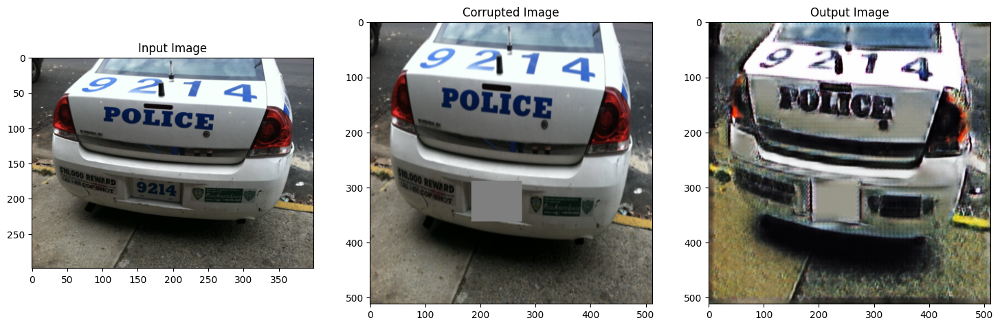

In [ ]:
test_image_kaggle("GAN_models/kaggle/best_generator.pth", "datasets/dataset1/images/test/Cars397.png", xml_bbox)

#### Pre-trained U-Net model with a ResNet encoder, Kaggle Dataset

In [ ]:
import segmentation_models_pytorch as smp

# Load a pre-trained U-Net model with a ResNet encoder
ResNetGenerator = smp.Unet(
    encoder_name="resnet34",        # Choose the encoder, e.g., "resnet34"
    encoder_weights="imagenet",      # Use pre-trained weights from ImageNet
    in_channels=3,                   # Number of input channels (3 for RGB images)
    classes=3,                       # Number of output channels (3 for RGB images)
).cuda()

class Discriminator_Kaggle_resnet(nn.Module):
    def __init__(self):
        super(Discriminator_Kaggle_resnet, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.Conv2d(256, 1, kernel_size=4, stride=1, padding=0),
            nn.AdaptiveAvgPool2d(1),
            nn.Sigmoid(),
        )

    def forward(self, x):
        x = self.main(x)
        return x.view(-1, 1)
    
discriminator = Discriminator_Kaggle_resnet().cuda()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0/100, d_loss: 0.5596832036972046, g_loss: 2.2570719718933105
Displaying images at epoch 0


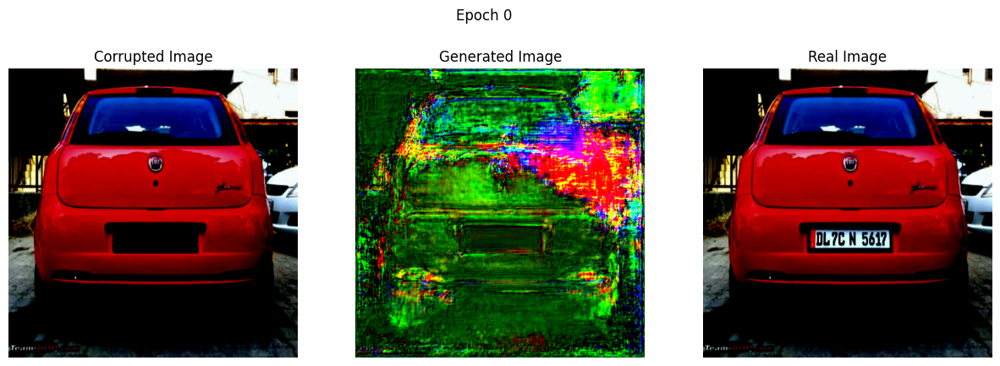

Epoch 1/100, d_loss: 0.9496332406997681, g_loss: 1.9061347246170044
Epoch 2/100, d_loss: 1.0648518800735474, g_loss: 1.7320183515548706
Epoch 3/100, d_loss: 1.1655067205429077, g_loss: 9.244370460510254
Epoch 4/100, d_loss: 1.1819937229156494, g_loss: 1.9218409061431885
Epoch 5/100, d_loss: 1.071366310119629, g_loss: 1.2925598621368408
Epoch 6/100, d_loss: 0.7298281192779541, g_loss: 5.365901947021484
Epoch 7/100, d_loss: 1.0539212226867676, g_loss: 2.0691885948181152
Epoch 8/100, d_loss: 0.9863308668136597, g_loss: 2.3612325191497803
Epoch 9/100, d_loss: 1.448559284210205, g_loss: 5.233684539794922


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10/100, d_loss: 1.0812331438064575, g_loss: 1.3952593803405762
Displaying images at epoch 10


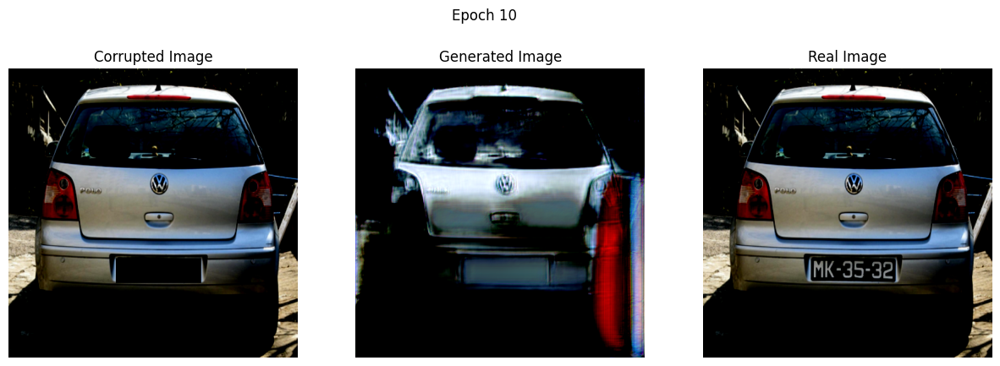

Epoch 11/100, d_loss: 1.0357149839401245, g_loss: 1.5011553764343262
Epoch 12/100, d_loss: 1.1608871221542358, g_loss: 2.879450798034668
Epoch 13/100, d_loss: 1.0134222507476807, g_loss: 3.5285515785217285
Epoch 14/100, d_loss: 1.0906801223754883, g_loss: 2.8005716800689697
Epoch 15/100, d_loss: 1.2008382081985474, g_loss: 1.8714599609375
Epoch 16/100, d_loss: 1.2123262882232666, g_loss: 2.5509583950042725
Epoch 17/100, d_loss: 1.0843979120254517, g_loss: 4.52147102355957
Epoch 18/100, d_loss: 1.3484554290771484, g_loss: 2.1579084396362305
Epoch 19/100, d_loss: 0.8653439283370972, g_loss: 1.684175968170166


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20/100, d_loss: 0.7735135555267334, g_loss: 1.8743619918823242
Displaying images at epoch 20


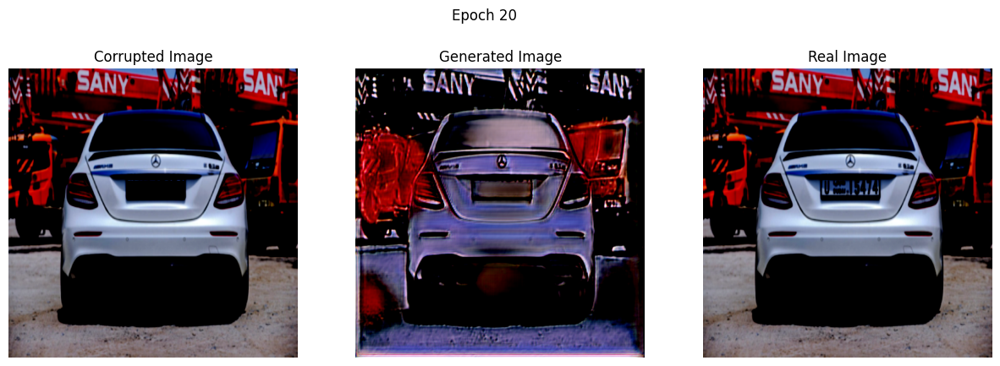

Epoch 21/100, d_loss: 1.3607369661331177, g_loss: 1.4129993915557861
Epoch 22/100, d_loss: 0.6758729219436646, g_loss: 3.0294010639190674
Epoch 23/100, d_loss: 0.9093738794326782, g_loss: 1.5435831546783447
Epoch 24/100, d_loss: 0.9511788487434387, g_loss: 2.0740315914154053
Epoch 25/100, d_loss: 0.8611609935760498, g_loss: 3.8356709480285645
Epoch 26/100, d_loss: 1.1086535453796387, g_loss: 8.202837944030762
Epoch 27/100, d_loss: 1.214543342590332, g_loss: 6.856923580169678
Epoch 28/100, d_loss: 1.4935052394866943, g_loss: 3.9102392196655273
Epoch 29/100, d_loss: 1.0998228788375854, g_loss: 2.2581701278686523


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30/100, d_loss: 1.0450854301452637, g_loss: 1.9462560415267944
Displaying images at epoch 30


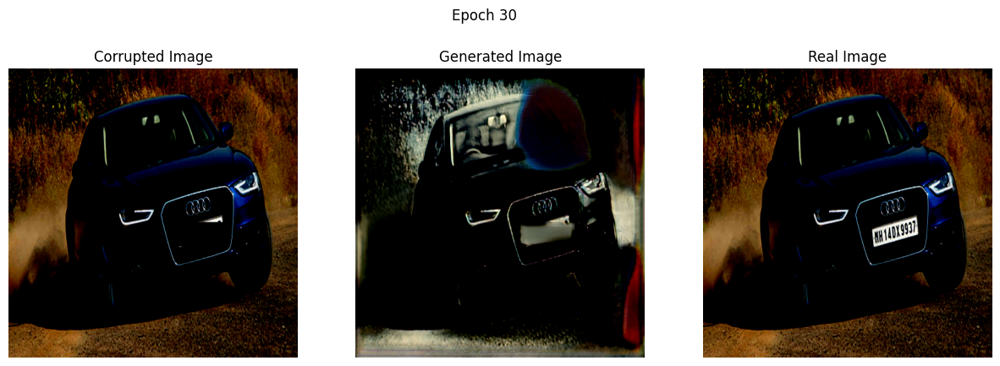

Epoch 31/100, d_loss: 0.8205039501190186, g_loss: 6.046999454498291
Epoch 32/100, d_loss: 1.3913019895553589, g_loss: 2.743940830230713
Epoch 33/100, d_loss: 1.3022775650024414, g_loss: 3.308347225189209
Epoch 34/100, d_loss: 0.7724918127059937, g_loss: 6.17016077041626
Epoch 35/100, d_loss: 1.3224830627441406, g_loss: 5.694333553314209
Epoch 36/100, d_loss: 0.8699129819869995, g_loss: 1.8309738636016846
Epoch 37/100, d_loss: 1.1998932361602783, g_loss: 4.328880786895752
Epoch 38/100, d_loss: 1.4930384159088135, g_loss: 1.6038001775741577
Epoch 39/100, d_loss: 0.8870701789855957, g_loss: 1.9474818706512451


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40/100, d_loss: 1.0830379724502563, g_loss: 2.7246196269989014
Displaying images at epoch 40


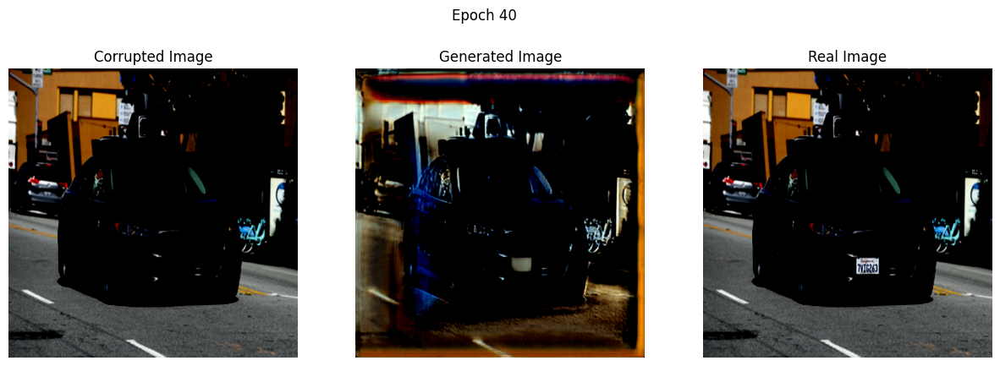

Epoch 41/100, d_loss: 0.7182886004447937, g_loss: 2.048469305038452
Epoch 42/100, d_loss: 0.9075142741203308, g_loss: 3.393404006958008
Epoch 43/100, d_loss: 1.0226651430130005, g_loss: 1.5124925374984741
Epoch 44/100, d_loss: 1.2108771800994873, g_loss: 1.3536219596862793
Epoch 45/100, d_loss: 0.7768312096595764, g_loss: 6.705854892730713
Epoch 46/100, d_loss: 0.7983015775680542, g_loss: 2.875826835632324
Epoch 47/100, d_loss: 1.6914281845092773, g_loss: 2.6457090377807617
Epoch 48/100, d_loss: 1.2835540771484375, g_loss: 1.4434694051742554
Epoch 49/100, d_loss: 0.9727479815483093, g_loss: 1.712019681930542


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 50/100, d_loss: 1.178033471107483, g_loss: 3.18552827835083
Displaying images at epoch 50


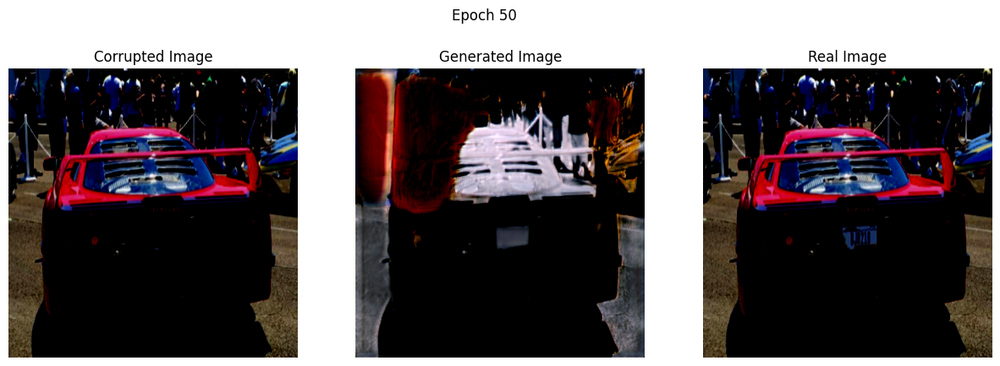

Epoch 51/100, d_loss: 1.1601496934890747, g_loss: 2.3930437564849854
Epoch 52/100, d_loss: 1.6293528079986572, g_loss: 1.6693042516708374
Epoch 53/100, d_loss: 0.9479519128799438, g_loss: 1.8098251819610596
Epoch 54/100, d_loss: 1.3874216079711914, g_loss: 2.588078498840332
Epoch 55/100, d_loss: 1.1215161085128784, g_loss: 1.311447024345398
Epoch 56/100, d_loss: 1.35447359085083, g_loss: 1.7709457874298096
Epoch 57/100, d_loss: 1.0277979373931885, g_loss: 1.6109708547592163
Epoch 58/100, d_loss: 1.252091407775879, g_loss: 1.4440648555755615
Epoch 59/100, d_loss: 0.8520734310150146, g_loss: 3.9474434852600098


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 60/100, d_loss: 1.2679600715637207, g_loss: 1.594188928604126
Displaying images at epoch 60


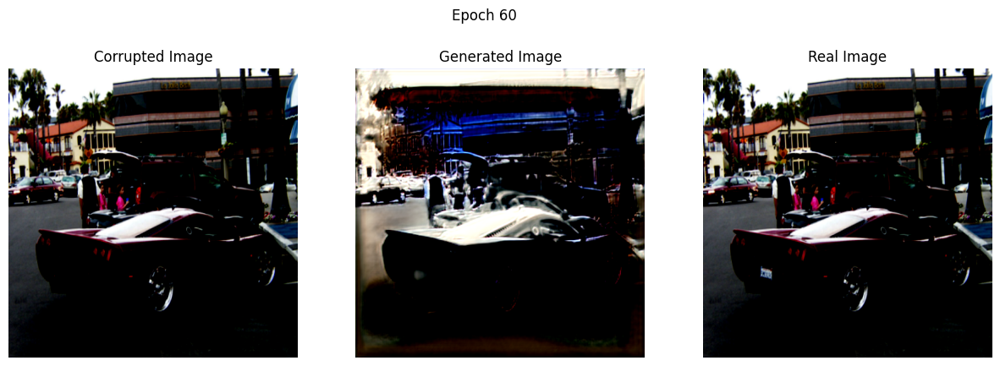

Epoch 61/100, d_loss: 1.170804738998413, g_loss: 1.4616522789001465
Epoch 62/100, d_loss: 1.116175889968872, g_loss: 1.5367066860198975
Epoch 63/100, d_loss: 1.0630733966827393, g_loss: 1.5144259929656982
Epoch 64/100, d_loss: 1.1527137756347656, g_loss: 2.0837278366088867
Epoch 65/100, d_loss: 1.0888562202453613, g_loss: 2.239388942718506
Epoch 66/100, d_loss: 1.6826585531234741, g_loss: 1.1908587217330933
Epoch 67/100, d_loss: 1.4053611755371094, g_loss: 1.5940485000610352
Epoch 68/100, d_loss: 1.199794888496399, g_loss: 1.350187063217163
Epoch 69/100, d_loss: 0.8505477905273438, g_loss: 1.912693738937378


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 70/100, d_loss: 1.3143718242645264, g_loss: 2.1577203273773193
Displaying images at epoch 70


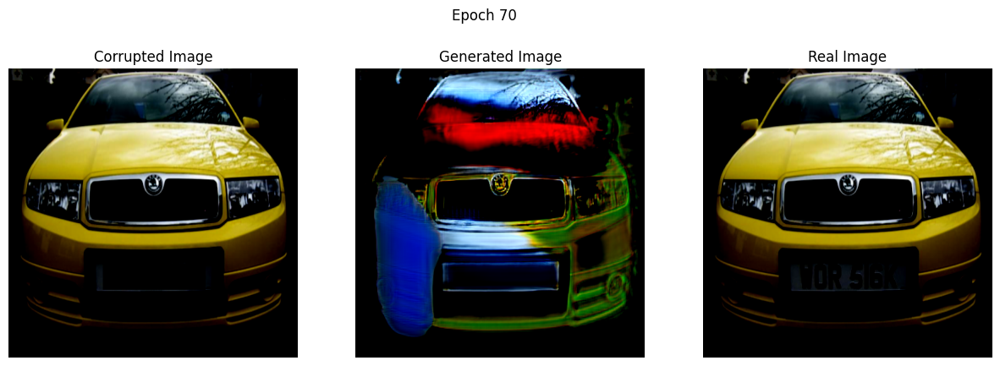

Epoch 71/100, d_loss: 1.1542049646377563, g_loss: 1.5800703763961792
Epoch 72/100, d_loss: 0.9239764213562012, g_loss: 3.542795419692993
Epoch 73/100, d_loss: 1.3092055320739746, g_loss: 1.6792398691177368
Epoch 74/100, d_loss: 0.8308938145637512, g_loss: 1.6769468784332275
Epoch 75/100, d_loss: 1.157555341720581, g_loss: 4.92344856262207
Epoch 76/100, d_loss: 1.621716022491455, g_loss: 1.527578353881836
Epoch 77/100, d_loss: 0.9306584596633911, g_loss: 2.439812183380127
Epoch 78/100, d_loss: 1.539165735244751, g_loss: 2.467660427093506
Epoch 79/100, d_loss: 0.9650872349739075, g_loss: 1.591613531112671


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 80/100, d_loss: 1.2695728540420532, g_loss: 3.186535358428955
Displaying images at epoch 80


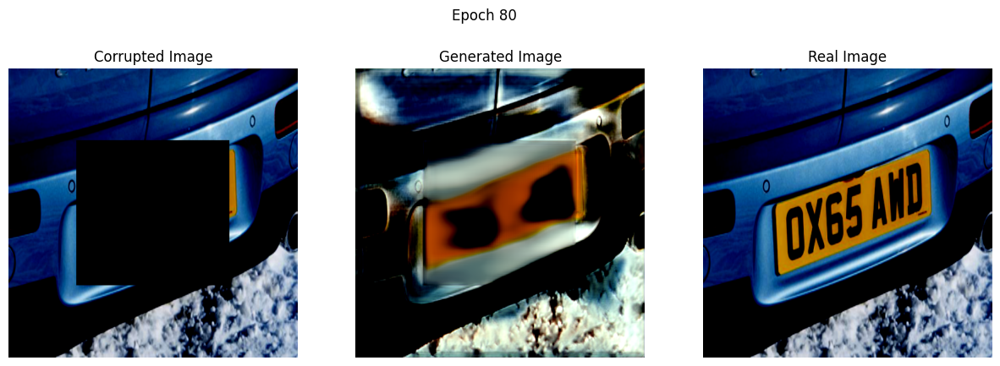

Epoch 81/100, d_loss: 1.0463604927062988, g_loss: 1.6572084426879883
Epoch 82/100, d_loss: 1.5304632186889648, g_loss: 1.47146475315094
Epoch 83/100, d_loss: 0.9660037755966187, g_loss: 1.520064353942871
Epoch 84/100, d_loss: 1.449620246887207, g_loss: 1.6492972373962402
Epoch 85/100, d_loss: 1.2577333450317383, g_loss: 1.7218440771102905
Epoch 86/100, d_loss: 1.522796392440796, g_loss: 2.649902820587158
Epoch 87/100, d_loss: 0.9769466519355774, g_loss: 2.6069231033325195
Epoch 88/100, d_loss: 1.2314491271972656, g_loss: 1.2545661926269531
Epoch 89/100, d_loss: 1.087881088256836, g_loss: 2.805224895477295


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 90/100, d_loss: 1.697356104850769, g_loss: 1.219099998474121
Displaying images at epoch 90


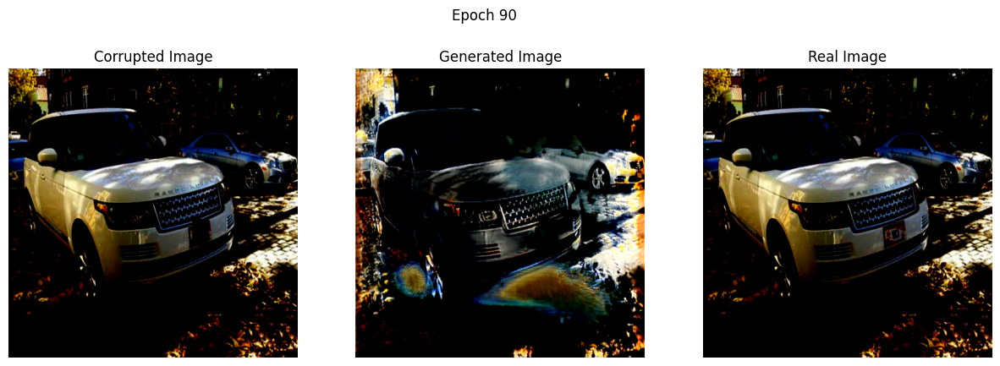

Epoch 91/100, d_loss: 1.1814186573028564, g_loss: 1.3213328123092651
Epoch 92/100, d_loss: 1.6898460388183594, g_loss: 6.347733974456787
Epoch 93/100, d_loss: 1.2599127292633057, g_loss: 1.1028891801834106
Epoch 94/100, d_loss: 1.154392123222351, g_loss: 1.644123911857605
Epoch 95/100, d_loss: 0.97777259349823, g_loss: 2.4373691082000732
Epoch 96/100, d_loss: 1.1968443393707275, g_loss: 2.3984551429748535
Epoch 97/100, d_loss: 1.1775051355361938, g_loss: 1.4487099647521973
Epoch 98/100, d_loss: 1.6597883701324463, g_loss: 1.763237714767456
Epoch 99/100, d_loss: 1.1291098594665527, g_loss: 2.2533326148986816


In [ ]:
train_gan_kaggle(ResNetGenerator, discriminator, train_dataloader, xml_bbox, epochs=100, save_path="GAN_models/Kaggle-Unet-resnet34")

In [ ]:
def test_image_kaggle_resnet(generator_path, image_path, xml_bbox, output_path=None):

    model = smp.Unet(
        encoder_name="resnet34",        # Choose the encoder, e.g., "resnet34"
        encoder_weights="imagenet",      # Use pre-trained weights from ImageNet
        in_channels=3,                   # Number of input channels (3 for RGB images)
        classes=3,                       # Number of output channels (3 for RGB images)
    )
    model.load_state_dict(torch.load(generator_path))
    model = model.to('cuda')

    # Load and transform the image
    image = Image.open(image_path).convert("RGB")
    transform = transforms.Compose([
        transforms.Resize((512, 512)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
    real_image = transform(image).unsqueeze(0).cuda()

    # Create a mask for the license plate region
    xmin, ymin, xmax, ymax, width, height = xml_bbox(os.path.basename(image_path))
    width_scale = 512 / width
    height_scale = 512 / height
    
    # Scale the bounding box coordinates
    xmin = int(xmin * width_scale)
    ymin = int(ymin * height_scale)
    xmax = int(xmax * width_scale)
    ymax = int(ymax * height_scale)
    mask = torch.zeros_like(real_image[0], device='cuda')
    mask[:, ymin:ymax, xmin:xmax] = 1

    # Apply the mask to create a corrupted input image
    input_image = apply_mask(real_image, mask)

    # Generate the inpainted image
    with torch.no_grad():
        output_image = model(input_image).cpu()

    # Convert the output tensor to a PIL image
    output_image = TF.to_pil_image(output_image.squeeze(0) * 0.5 + 0.5)

    if output_path:
        # Save the output image
        output_image.save(output_path)

    # Display the input, corrupted, and output images
    import matplotlib.pyplot as plt

    corrupted_image = TF.to_pil_image(input_image.squeeze(0).cpu() * 0.5 + 0.5)

    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    axs[0].imshow(image)
    axs[0].set_title("Input Image")
    axs[1].imshow(corrupted_image)
    axs[1].set_title("Corrupted Image")
    axs[2].imshow(output_image)
    axs[2].set_title("Output Image")
    plt.show()

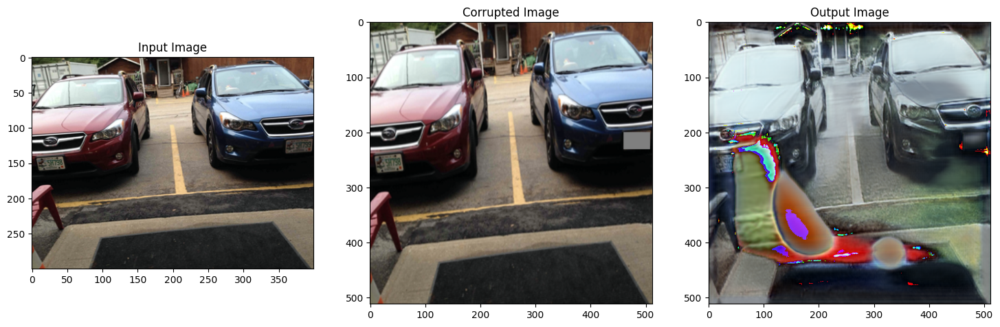

In [ ]:
test_image_kaggle_resnet("GAN_models/Kaggle-Unet-resnet34/best_generator.pth", "datasets/dataset1/images/test/Cars390.png", xml_bbox)

#### UNet Generator, ResNet34 encoder and descriminators, Kaggle Dataset

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models
import segmentation_models_pytorch as smp

class UNet_Generator(nn.Module):
    def __init__(self, encoder_weights="imagenet", freeze_encoder=True):
        super(UNet_Generator, self).__init__()

        self.model = smp.Unet(
            encoder_name="resnet34",
            encoder_weights=encoder_weights,
            in_channels=3,
            classes=3
        )

        if freeze_encoder:
            for param in self.model.encoder.parameters():
                param.requires_grad = False

    def forward(self, x):
        x = self.model(x)
        return x

class Resnet34_Discriminator(nn.Module):
    def __init__(self, freeze_layers=False):
        super(Resnet34_Discriminator, self).__init__()

        resnet = models.resnet34(pretrained=False)
        if freeze_layers:
            for param in resnet.parameters():
                param.requires_grad = False

        layers = list(resnet.children())[:-2]
        layers.extend([
            nn.Conv2d(512, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.Conv2d(256, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 1, kernel_size=3, stride=1, padding=1),
            nn.AdaptiveAvgPool2d(1),
            nn.Sigmoid()
        ])

        self.main = nn.Sequential(*layers)

    def forward(self, x):
        x = self.main(x)
        return x.view(-1, 1)


In [ ]:
import torch.optim as optim
import math

def xml_bbox(name):
    anno = "datasets/dataset1/annotations"
    # find the xml file with name
    for file in os.listdir(anno):
        if file[:-4] == name[:-4]:
            info = xet.parse(os.path.join(anno, file))
            root = info.getroot()
            size_object = root.find('size')
            width = int(size_object.find('width').text)
            height = int(size_object.find('height').text)
            member_object = root.find('object')
            labels_info = member_object.find('bndbox')
            xmin = int(labels_info.find('xmin').text)
            xmax = int(labels_info.find('xmax').text)
            ymin = int(labels_info.find('ymin').text)
            ymax = int(labels_info.find('ymax').text)
    return xmin, ymin, xmax, ymax, width, height

def imshow(img):
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

def apply_mask(images, mask):
    return images * (1 - mask)

def masked_l1_loss(real, generated, mask):
    return torch.mean(torch.abs((generated - real) * mask))

def display_images(corrupted, generated, real, epoch):
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    
    corrupted_np = torchvision.utils.make_grid(corrupted[:1], nrow=1).cpu().numpy()
    axs[0].imshow(np.transpose(corrupted_np, (1, 2, 0)))
    axs[0].set_title('Corrupted Image')
    axs[0].axis('off')
    
    generated_np = torchvision.utils.make_grid(generated[:1].detach(), nrow=1).cpu().numpy()
    axs[1].imshow(np.transpose(generated_np, (1, 2, 0)))
    axs[1].set_title('Generated Image')
    axs[1].axis('off')
    
    real_np = torchvision.utils.make_grid(real[:1], nrow=1).cpu().numpy()
    axs[2].imshow(np.transpose(real_np, (1, 2, 0)))
    axs[2].set_title('Real Image')
    axs[2].axis('off')
    
    plt.suptitle(f'Epoch {epoch}')
    plt.show()

def compute_validation_loss(generator, dataloader, extract_bbox):
    criterion = nn.BCELoss()
    loss = 0.0
    count = 0

    with torch.no_grad():
        for images, image_paths in dataloader:
            real_images = images.cuda()
            real_labels = torch.ones(real_images.size(0), 1).cuda()

            # Create masks for license plate regions
            masks = []
            for path in image_paths:
                xmin, ymin, xmax, ymax, width, height = xml_bbox(os.path.basename(path))
                width_scale = 512 / width
                height_scale = 512 / height
                # Scale the bounding box coordinates
                xmin = int(xmin * width_scale)
                ymin = int(ymin * height_scale)
                xmax = int(xmax * width_scale)
                ymax = int(ymax * height_scale)
                mask = torch.zeros_like(real_images[0], device='cuda')
                mask[:, ymin:ymax, xmin:xmax] = 1
                masks.append(mask)
            masks = torch.stack(masks)

            # Apply masks to create corrupted images
            corrupted_images = apply_mask(real_images, masks)

            # Compute generator loss on corrupted images
            fake_images = generator(corrupted_images)
            g_loss = criterion(discriminator(fake_images), real_labels)

            loss += g_loss.item() * real_images.size(0)
            count += real_images.size(0)

    return loss / count


def train_gan_kaggle(generator, discriminator, dataloader, extract_bbox, epochs=100, save_path=None):
    criterion = nn.BCELoss()
    optimizer_g = optim.Adam(generator.parameters(), lr=0.001)
    optimizer_d = optim.Adam(discriminator.parameters(), lr=0.001)
    best_loss = math.inf
    best_generator_state = None
    display_interval = 5  # Choose the interval at which you want to display the images (e.g., every 5 epochs)

    for epoch in range(epochs):
        for i, (images, image_paths) in enumerate(dataloader):
            real_images = images.cuda()
            real_labels = torch.ones(real_images.size(0), 1).cuda()

            # Create masks for license plate regions
            masks = []
            for path in image_paths:
                xmin, ymin, xmax, ymax, width, height = xml_bbox(os.path.basename(path))
                width_scale = 512 / width
                height_scale = 512 / height
                # Scale the bounding box coordinates
                xmin = int(xmin * width_scale)
                ymin = int(ymin * height_scale)
                xmax = int(xmax * width_scale)
                ymax = int(ymax * height_scale)
                mask = torch.zeros_like(real_images[0], device='cuda')
                mask[:, ymin:ymax, xmin:xmax] = 1
                masks.append(mask)
            masks = torch.stack(masks)

            # Apply masks to create corrupted images
            corrupted_images = apply_mask(real_images, masks)

            lambda_l1 = 100  # You can experiment with different values

            # Train generator
            optimizer_g.zero_grad()
            fake_images = generator(corrupted_images)
            fake_labels = torch.zeros(real_images.size(0), 1).cuda()
            g_bce_loss = criterion(discriminator(fake_images), real_labels)
            g_l1_loss = masked_l1_loss(real_images, fake_images, masks) * lambda_l1
            g_loss = g_bce_loss + g_l1_loss
            g_loss.backward()
            optimizer_g.step()

            # Train discriminator
            optimizer_d.zero_grad()
            real_loss = criterion(discriminator(real_images), real_labels)
            fake_loss = criterion(discriminator(fake_images.detach()), fake_labels)
            d_loss = real_loss + fake_loss
            d_loss.backward()
            optimizer_d.step()

        if save_path is not None:
            val_loss = compute_validation_loss(generator, val_dataloader, extract_bbox)
            if val_loss < best_loss:
                best_loss = val_loss
                best_generator_state = generator.state_dict()
                torch.save(best_generator_state, os.path.join(save_path, "best_generator.pth"))

        print(f"Epoch {epoch}/{epochs}, d_loss: {d_loss.item()}, g_loss: {g_loss.item()}")

        if epoch % display_interval == 0:
            print(f"Displaying images at epoch {epoch}")
            display_images(corrupted_images, fake_images, real_images, epoch)



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0/100, d_loss: 0.6350803375244141, g_loss: 4.512054920196533
Displaying images at epoch 0


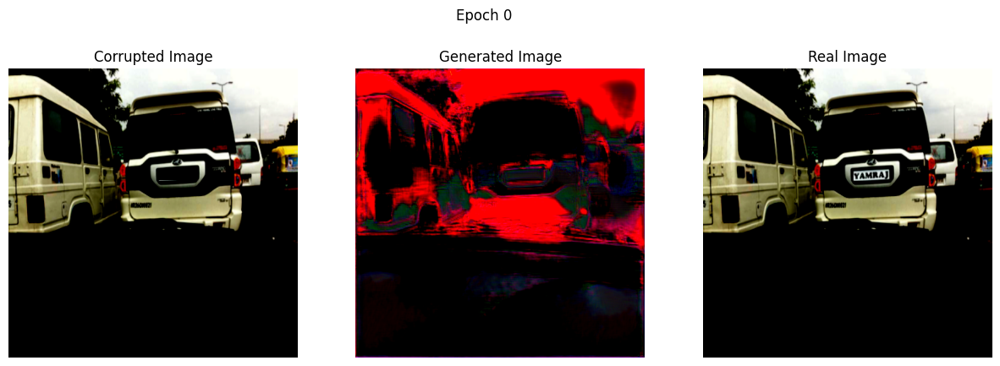

Epoch 1/100, d_loss: 0.14686813950538635, g_loss: 4.717146396636963
Epoch 2/100, d_loss: 0.4131980240345001, g_loss: 4.842755317687988
Epoch 3/100, d_loss: 1.4210710525512695, g_loss: 4.513327598571777
Epoch 4/100, d_loss: 1.1176550388336182, g_loss: 1.4902756214141846


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5/100, d_loss: 0.16141349077224731, g_loss: 9.278738021850586
Displaying images at epoch 5


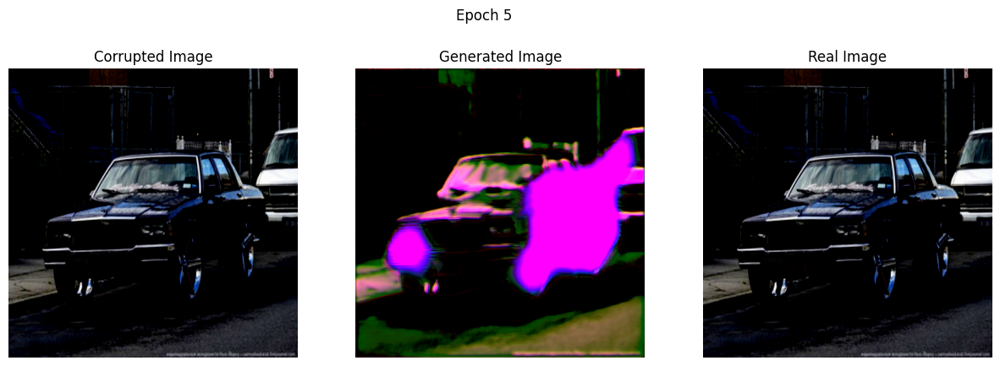

Epoch 6/100, d_loss: 0.04300428926944733, g_loss: 4.739181995391846
Epoch 7/100, d_loss: 0.5097473859786987, g_loss: 2.5027525424957275
Epoch 8/100, d_loss: 0.3660811483860016, g_loss: 3.438673496246338
Epoch 9/100, d_loss: 1.232348918914795, g_loss: 2.8887782096862793


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10/100, d_loss: 1.3115156888961792, g_loss: 7.369565486907959
Displaying images at epoch 10


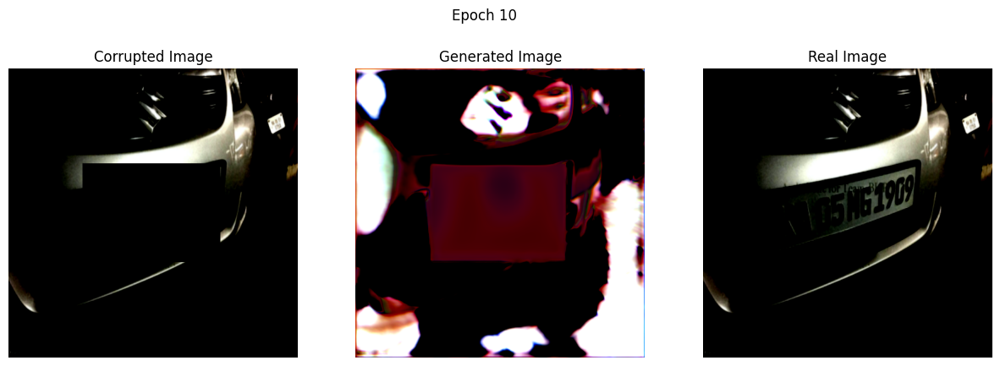

Epoch 11/100, d_loss: 1.8029353618621826, g_loss: 0.7490779757499695
Epoch 12/100, d_loss: 1.3536396026611328, g_loss: 1.3577731847763062
Epoch 13/100, d_loss: 0.5869705677032471, g_loss: 6.679843425750732
Epoch 14/100, d_loss: 1.1267976760864258, g_loss: 2.4013571739196777


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15/100, d_loss: 0.3172198534011841, g_loss: 3.7008161544799805
Displaying images at epoch 15


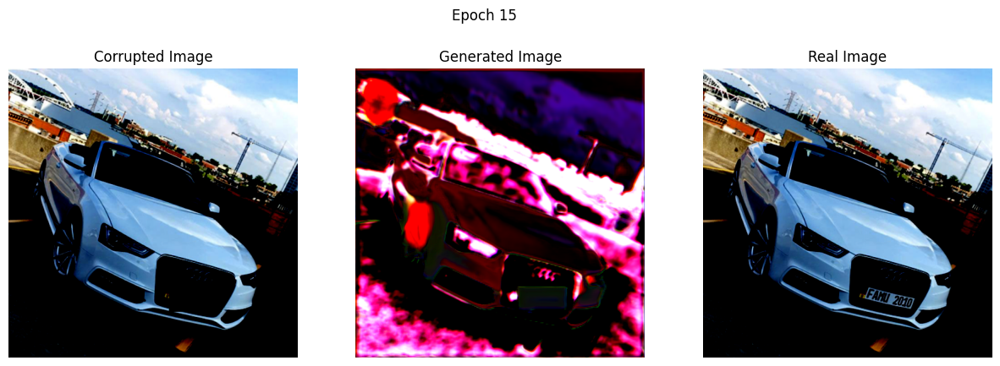

Epoch 16/100, d_loss: 0.12653614580631256, g_loss: 3.4409964084625244
Epoch 17/100, d_loss: 1.041028380393982, g_loss: 2.049743175506592
Epoch 18/100, d_loss: 2.1588237285614014, g_loss: 1.5509870052337646
Epoch 19/100, d_loss: 0.11890901625156403, g_loss: 3.434790849685669


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20/100, d_loss: 0.19472622871398926, g_loss: 3.448761463165283
Displaying images at epoch 20


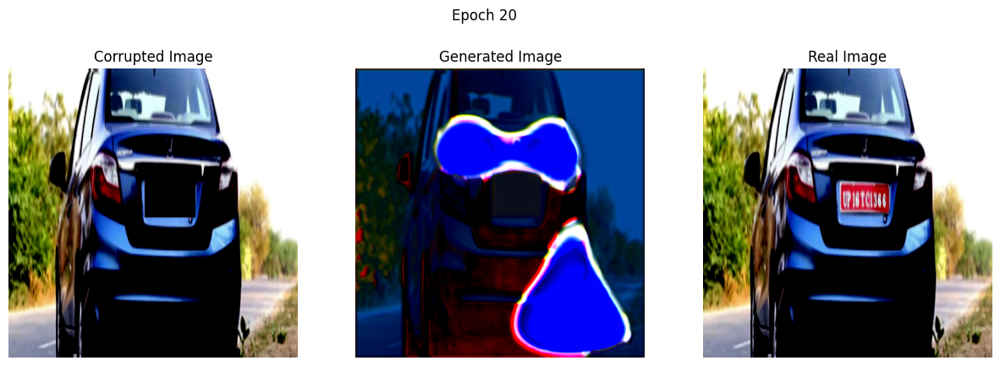

Epoch 21/100, d_loss: 0.04175310581922531, g_loss: 5.730189800262451
Epoch 22/100, d_loss: 0.014352303929626942, g_loss: 12.088232040405273
Epoch 23/100, d_loss: 0.010358965024352074, g_loss: 8.95483112335205
Epoch 24/100, d_loss: 0.028697511181235313, g_loss: 13.472114562988281


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25/100, d_loss: 0.005824016407132149, g_loss: 10.606358528137207
Displaying images at epoch 25


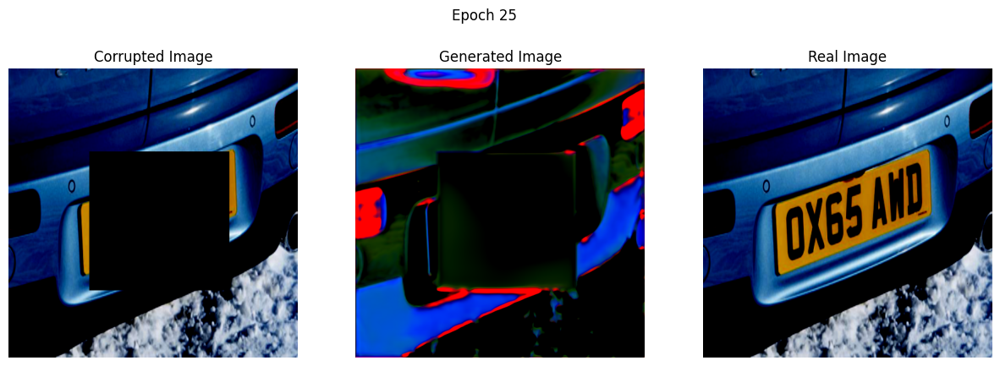

Epoch 26/100, d_loss: 0.534065842628479, g_loss: 7.282711982727051
Epoch 27/100, d_loss: 0.02777590975165367, g_loss: 8.803297996520996
Epoch 28/100, d_loss: 0.051863063126802444, g_loss: 7.030639171600342
Epoch 29/100, d_loss: 0.009979022666811943, g_loss: 7.690752029418945


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30/100, d_loss: 0.7859752178192139, g_loss: 3.524167060852051
Displaying images at epoch 30


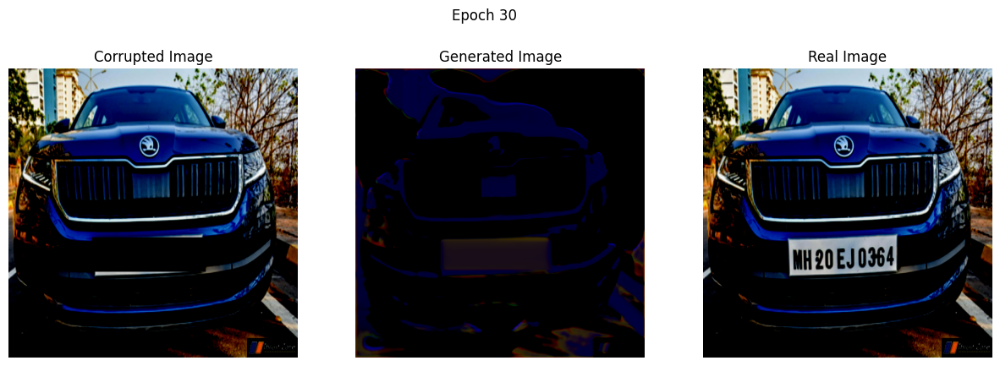

Epoch 31/100, d_loss: 1.4239888191223145, g_loss: 1.5057917833328247
Epoch 32/100, d_loss: 0.5575780272483826, g_loss: 7.450260639190674
Epoch 33/100, d_loss: 0.15775172412395477, g_loss: 10.138265609741211
Epoch 34/100, d_loss: 0.10970534384250641, g_loss: 5.454505920410156


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35/100, d_loss: 1.663789987564087, g_loss: 9.212390899658203
Displaying images at epoch 35


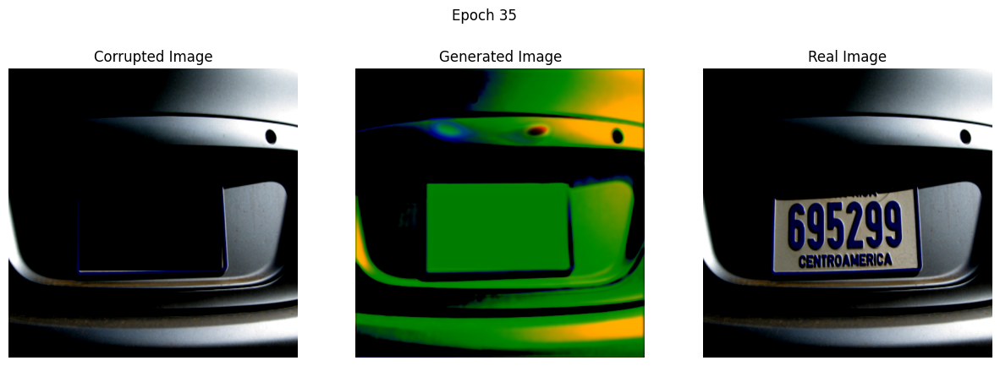

Epoch 36/100, d_loss: 0.23063306510448456, g_loss: 7.8442511558532715
Epoch 37/100, d_loss: 0.13912469148635864, g_loss: 5.869989395141602
Epoch 38/100, d_loss: 0.039903417229652405, g_loss: 5.751070022583008
Epoch 39/100, d_loss: 4.1059722900390625, g_loss: 2.7225160598754883


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40/100, d_loss: 0.02167576178908348, g_loss: 5.630172252655029
Displaying images at epoch 40


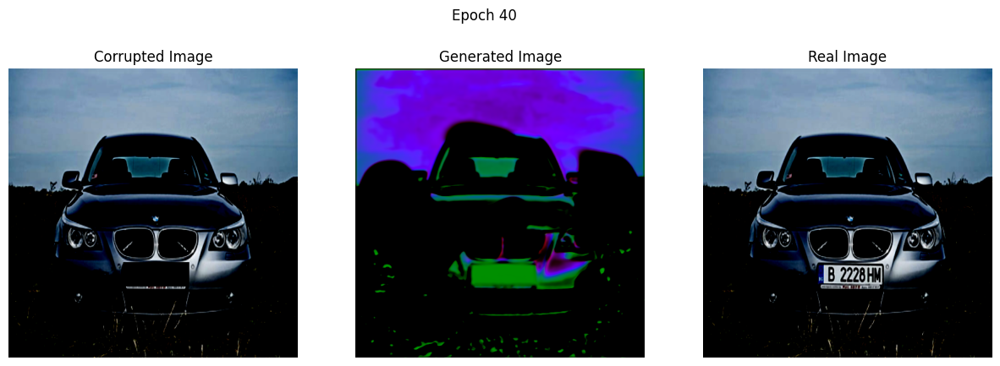

Epoch 41/100, d_loss: 0.06901226192712784, g_loss: 5.499145030975342
Epoch 42/100, d_loss: 0.4512758255004883, g_loss: 4.540543079376221
Epoch 43/100, d_loss: 0.03461501747369766, g_loss: 6.663271903991699
Epoch 44/100, d_loss: 1.1735177040100098, g_loss: 1.7108930349349976


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45/100, d_loss: 2.0617849826812744, g_loss: 2.4487783908843994
Displaying images at epoch 45


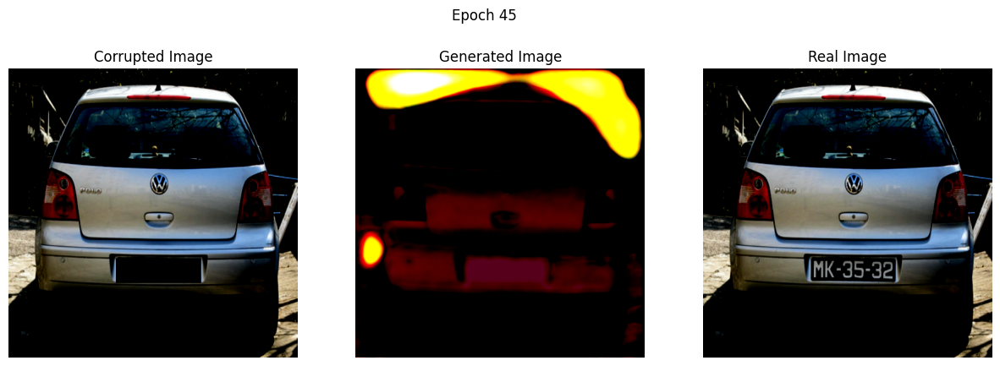

Epoch 46/100, d_loss: 1.1609747409820557, g_loss: 3.39644718170166
Epoch 47/100, d_loss: 1.0652263164520264, g_loss: 1.5075808763504028
Epoch 48/100, d_loss: 0.25881698727607727, g_loss: 2.9655046463012695
Epoch 49/100, d_loss: 0.6168193817138672, g_loss: 3.8966269493103027


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 50/100, d_loss: 1.2721854448318481, g_loss: 10.403350830078125
Displaying images at epoch 50


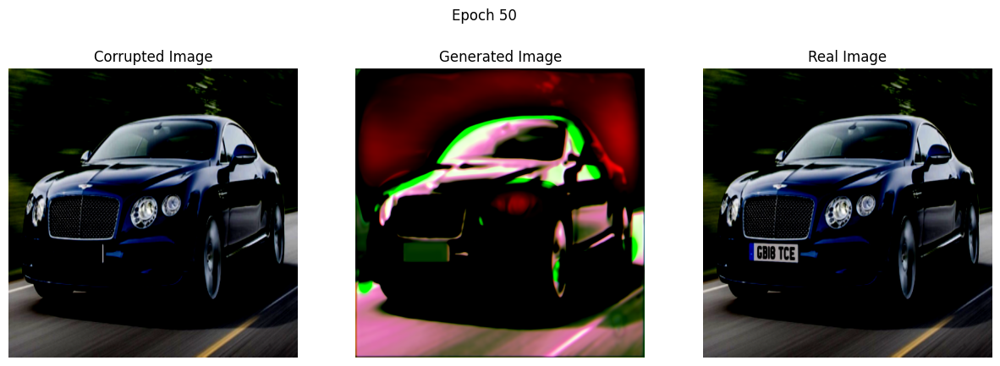

Epoch 51/100, d_loss: 0.8742097020149231, g_loss: 1.8171436786651611
Epoch 52/100, d_loss: 0.7990866899490356, g_loss: 2.553910493850708
Epoch 53/100, d_loss: 0.16582538187503815, g_loss: 5.787648677825928
Epoch 54/100, d_loss: 0.32901889085769653, g_loss: 4.824923515319824


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 55/100, d_loss: 3.4796009063720703, g_loss: 0.7579434514045715
Displaying images at epoch 55


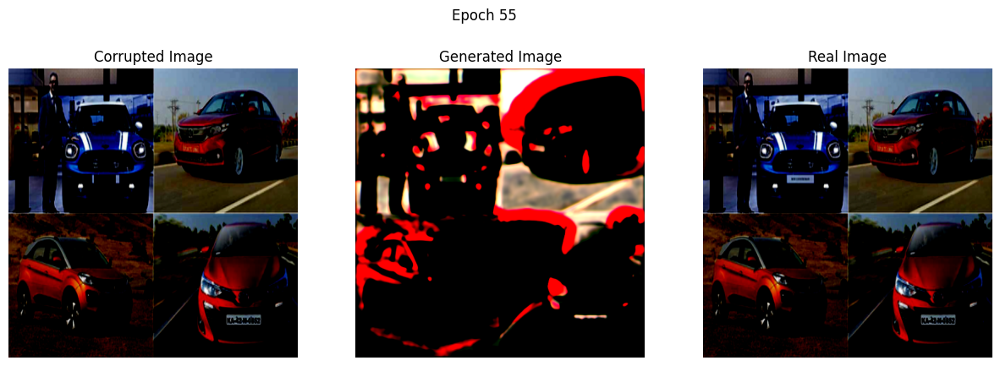

Epoch 56/100, d_loss: 0.20676907896995544, g_loss: 3.8302431106567383
Epoch 57/100, d_loss: 0.23177216947078705, g_loss: 3.2725183963775635
Epoch 58/100, d_loss: 0.819658637046814, g_loss: 3.3618967533111572
Epoch 59/100, d_loss: 0.6254924535751343, g_loss: 8.248581886291504
Epoch 60/100, d_loss: 0.06191594526171684, g_loss: 9.590112686157227
Displaying images at epoch 60


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


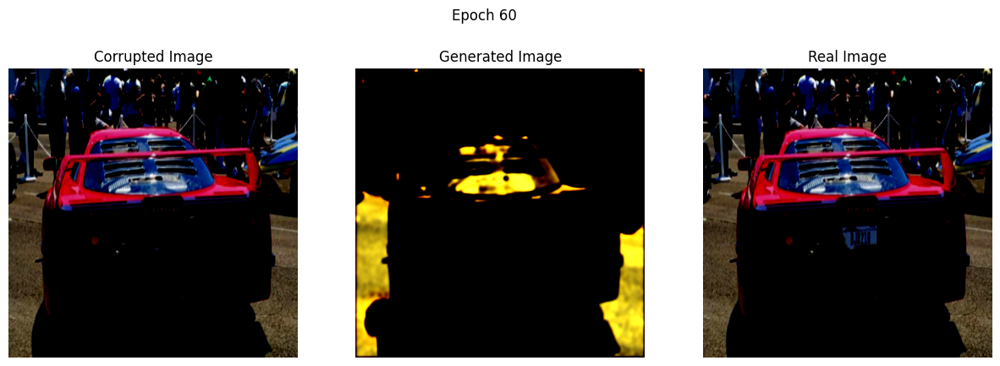

Epoch 61/100, d_loss: 5.283627510070801, g_loss: 1.0550841093063354
Epoch 62/100, d_loss: 1.2273132801055908, g_loss: 8.130377769470215
Epoch 63/100, d_loss: 2.1566827297210693, g_loss: 3.437194347381592
Epoch 64/100, d_loss: 0.7802550196647644, g_loss: 2.367523193359375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 65/100, d_loss: 1.5441120862960815, g_loss: 1.7824461460113525
Displaying images at epoch 65


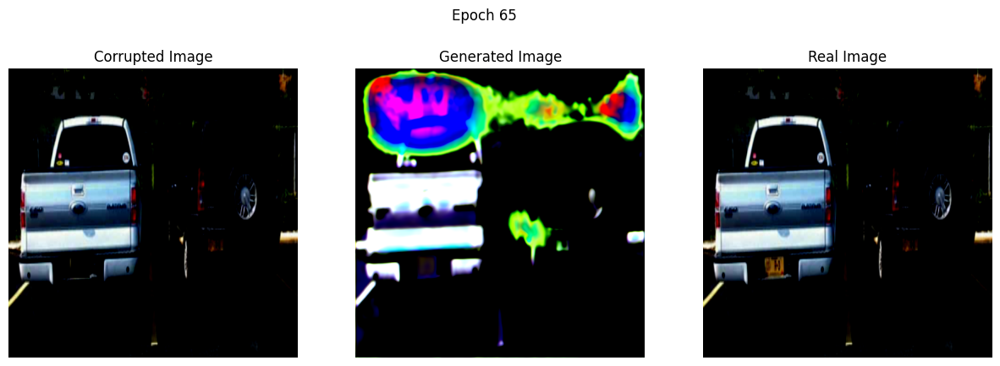

Epoch 66/100, d_loss: 1.0027695894241333, g_loss: 6.178460121154785
Epoch 67/100, d_loss: 0.4431988000869751, g_loss: 3.039875030517578
Epoch 68/100, d_loss: 2.6986539363861084, g_loss: 2.4827094078063965
Epoch 69/100, d_loss: 1.146712303161621, g_loss: 3.8761398792266846


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 70/100, d_loss: 0.8479049205780029, g_loss: 1.8082382678985596
Displaying images at epoch 70


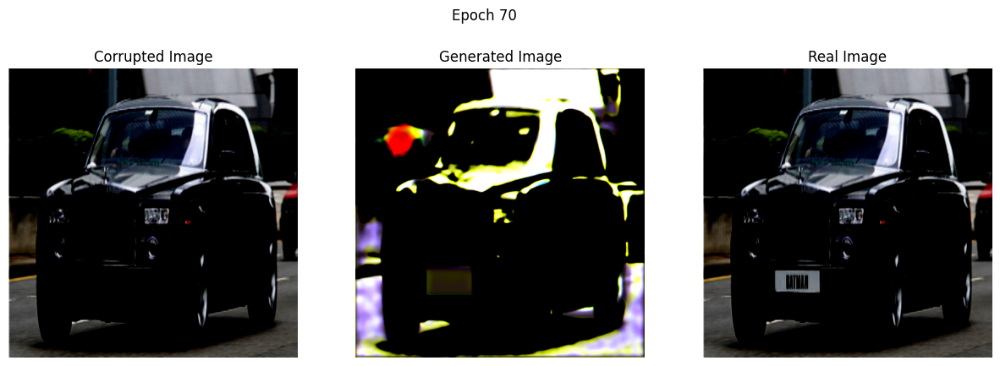

Epoch 71/100, d_loss: 1.5913165807724, g_loss: 5.364748477935791
Epoch 72/100, d_loss: 1.7811180353164673, g_loss: 7.354634761810303
Epoch 73/100, d_loss: 1.2750847339630127, g_loss: 2.5397398471832275
Epoch 74/100, d_loss: 0.660374104976654, g_loss: 3.404085636138916


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 75/100, d_loss: 1.5456960201263428, g_loss: 3.1659483909606934
Displaying images at epoch 75


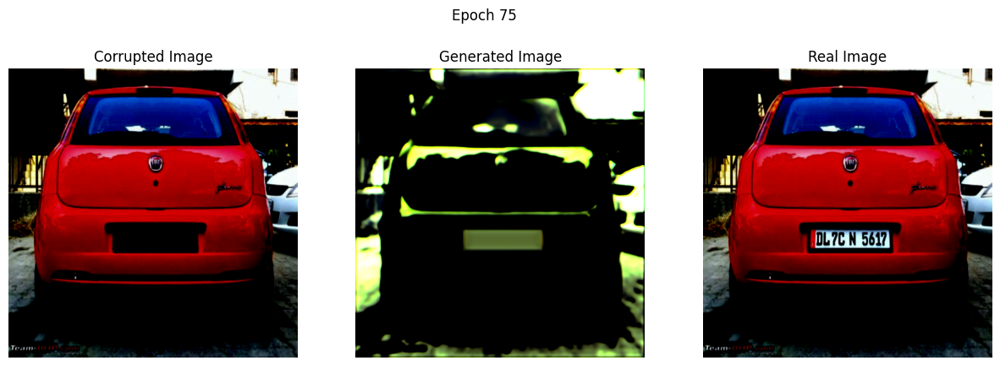

Epoch 76/100, d_loss: 0.11098140478134155, g_loss: 5.126911640167236
Epoch 77/100, d_loss: 2.200678825378418, g_loss: 2.513982057571411
Epoch 78/100, d_loss: 0.5345121026039124, g_loss: 4.189878940582275
Epoch 79/100, d_loss: 0.8930957317352295, g_loss: 7.537663459777832


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 80/100, d_loss: 0.8907326459884644, g_loss: 8.495901107788086
Displaying images at epoch 80


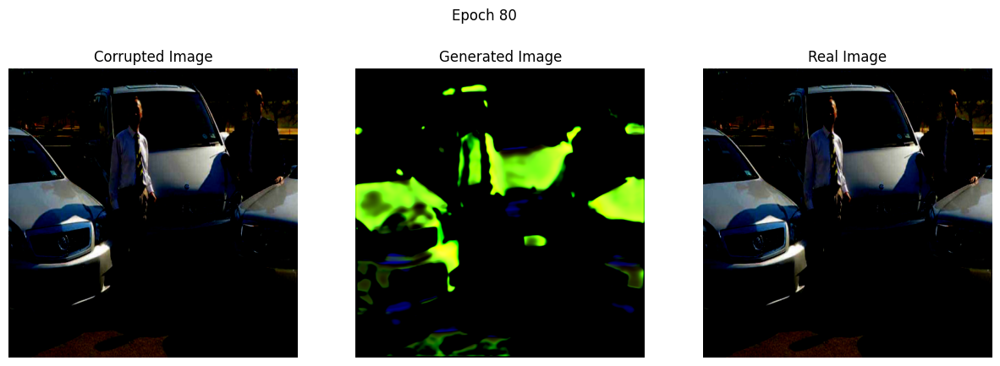

Epoch 81/100, d_loss: 0.5889866352081299, g_loss: 2.220263957977295
Epoch 82/100, d_loss: 1.2011134624481201, g_loss: 3.932499885559082
Epoch 83/100, d_loss: 2.004456043243408, g_loss: 2.671653985977173
Epoch 84/100, d_loss: 0.8688299655914307, g_loss: 2.6660513877868652


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 85/100, d_loss: 0.46524184942245483, g_loss: 4.4763383865356445
Displaying images at epoch 85


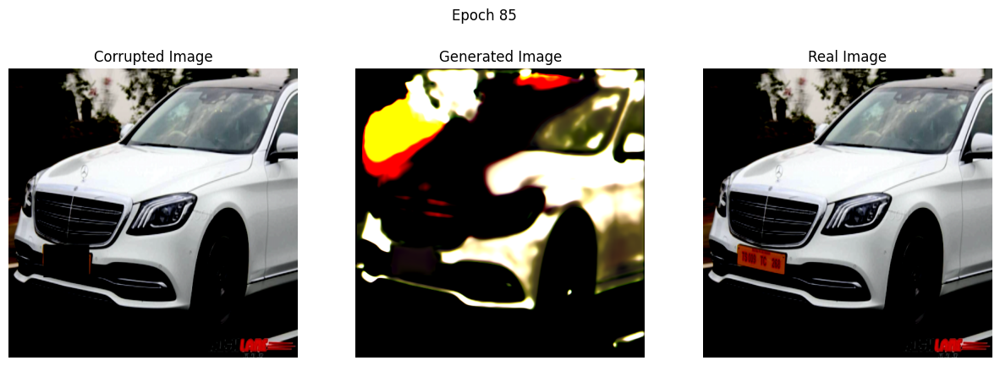

Epoch 86/100, d_loss: 2.0037782192230225, g_loss: 0.8276625275611877
Epoch 87/100, d_loss: 0.156858891248703, g_loss: 5.582287788391113
Epoch 88/100, d_loss: 0.582746148109436, g_loss: 2.4663684368133545
Epoch 89/100, d_loss: 0.12168517708778381, g_loss: 4.694942474365234


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 90/100, d_loss: 0.6286766529083252, g_loss: 6.97324800491333
Displaying images at epoch 90


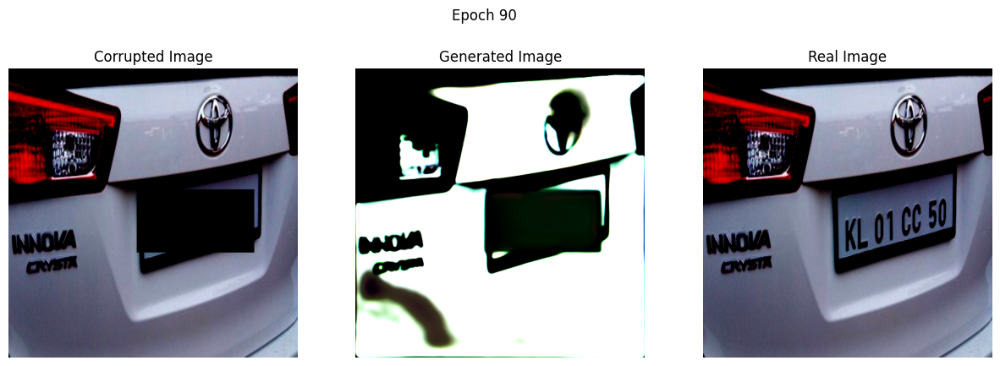

Epoch 91/100, d_loss: 2.0858733654022217, g_loss: 3.422377824783325
Epoch 92/100, d_loss: 0.4344455599784851, g_loss: 3.787609100341797
Epoch 93/100, d_loss: 0.8869739770889282, g_loss: 1.4702167510986328
Epoch 94/100, d_loss: 0.6503731608390808, g_loss: 4.154139518737793


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 95/100, d_loss: 2.0566883087158203, g_loss: 2.143350601196289
Displaying images at epoch 95


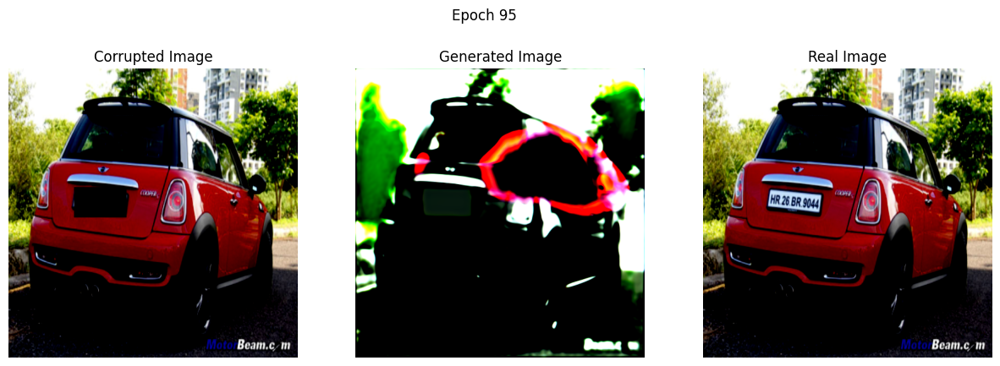

Epoch 96/100, d_loss: 1.481215476989746, g_loss: 3.1831412315368652
Epoch 97/100, d_loss: 0.9741342663764954, g_loss: 4.755181312561035
Epoch 98/100, d_loss: 0.7528905272483826, g_loss: 4.681530475616455
Epoch 99/100, d_loss: 1.178446650505066, g_loss: 2.5424721240997314


In [ ]:
generator = UNet_Generator().cuda()
discriminator = Resnet34_Discriminator().cuda()

train_gan_kaggle(generator, discriminator, train_dataloader, xml_bbox, epochs=100, save_path="GAN_models/Kaggle-Unet-resnet34-frozen/")

In [ ]:
def test_image_kaggle_resnet_freeze(generator_path, image_path, xml_bbox, output_path=None):

    model = UNet_Generator()
    model.load_state_dict(torch.load(generator_path))
    model = model.to('cuda')
    model.eval()

    # Load and transform the image
    image = Image.open(image_path).convert("RGB")
    transform = transforms.Compose([
        transforms.Resize((512, 512)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
    real_image = transform(image).unsqueeze(0).cuda()

    # Create a mask for the license plate region
    xmin, ymin, xmax, ymax, width, height = xml_bbox(os.path.basename(image_path))
    width_scale = 512 / width
    height_scale = 512 / height
    
    # Scale the bounding box coordinates
    xmin = int(xmin * width_scale)
    ymin = int(ymin * height_scale)
    xmax = int(xmax * width_scale)
    ymax = int(ymax * height_scale)
    mask = torch.zeros_like(real_image[0], device='cuda')
    mask[:, ymin:ymax, xmin:xmax] = 1

    # Apply the mask to create a corrupted input image
    input_image = apply_mask(real_image, mask)

    # Generate the inpainted image
    with torch.no_grad():
        output_image = model(input_image).cpu()

    # Convert the output tensor to a PIL image
    output_image = TF.to_pil_image(output_image.squeeze(0) * 0.5 + 0.5)

    if output_path:
        # Save the output image
        output_image.save(output_path)

    # Display the input, corrupted, and output images
    import matplotlib.pyplot as plt

    corrupted_image = TF.to_pil_image(input_image.squeeze(0).cpu() * 0.5 + 0.5)

    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    axs[0].imshow(image)
    axs[0].set_title("Input Image")
    axs[1].imshow(corrupted_image)
    axs[1].set_title("Corrupted Image")
    axs[2].imshow(output_image)
    axs[2].set_title("Output Image")
    plt.show()


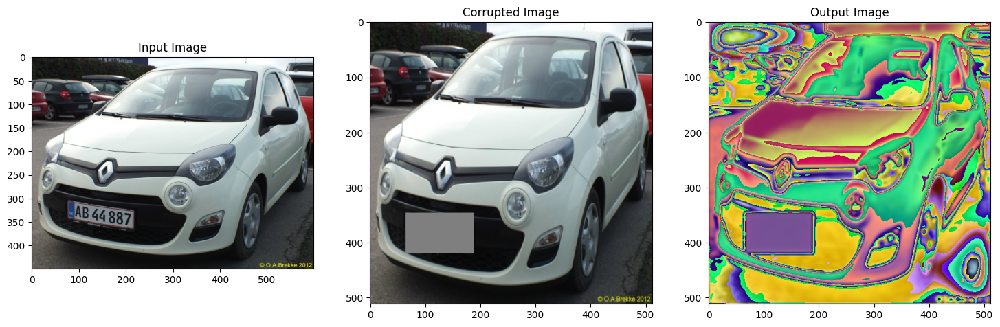

In [ ]:
test_image_kaggle_resnet_freeze("GAN_models/Kaggle-Unet-resnet34-frozen/best_generator.pth", "datasets/dataset1/images/test/Cars389.png", xml_bbox)

In [ ]:
# !pip install --upgrade diffusers[torch]

In [ ]:
import torch
from PIL import Image, ImageDraw
from diffusers import StableDiffusionInpaintPipeline
import numpy as np
import matplotlib.pyplot as plt

def process_image(image_path, model, inpaint_pipeline, prompt="License plate, realistic, car, vehicle", num_inference_steps=30):
    # Load the image
    image = Image.open(image_path)

    height, width = image.height, image.width
    
    image_np = np.array(image)

    # Get the bounding boxes of the license plates
    results = model(image_np)

    # Create a mask image for the license plates
    mask = Image.new("RGB", (image.width, image.height), (0, 0, 0))  # Create a black mask

    for *xyxy, conf, cls in results.xyxy[0]:
        x1, y1, x2, y2 = map(int, (xyxy))
        ImageDraw.Draw(mask).rectangle([x1, y1, x2, y2], fill=(255, 255, 255))  # Fill the license plate area with white

    # Resize 
    image = image.resize((512, 512), resample=Image.LANCZOS)
    mask = mask.resize((512, 512))

    # Apply Stable Diffusion Inpainting technique to inpaint the license plates
    inpainted_image = inpaint_pipeline(prompt=prompt, image=image, mask_image=mask, num_inference_steps=num_inference_steps).images[0]

    return inpainted_image

In [ ]:
# Load the custom YOLOv5 model
model = torch.hub.load('ultralytics/yolov5', 'custom', path='best_100.pt')

# Load the Stable Diffusion Inpainting pipeline
pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16,
)
pipe = pipe.to("cuda")

# Example usage:
# image_path = "test_videos/kitti/0000000320.png"
# inpainted_image = process_image(image_path, model, pipe)
# inpainted_image.save("output_image.jpg")

Using cache found in C:\Users\shiva/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2023-2-19 Python-3.10.4 torch-1.13.1+cu117 CUDA:0 (NVIDIA GeForce RTX 3070 Laptop GPU, 8192MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 
Fetching 16 files: 100%|██████████| 16/16 [00:00<?, ?it/s]
c:\Users\shiva\Desktop\UofT\Term4-winter2023\MIE1517\Project\Testing\yolo_env\lib\site-packages\transformers\models\clip\feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


In [ ]:
import os
import cv2
from IPython.display import clear_output

def process_video(input_folder, output_video_path, model, inpaint_pipeline,fps=30,prompt="Vehicle License plate with emojies", stop_at=None, play=False, num_inference_steps=30):
    # Get a sorted list of image file names in the input folder
    image_files = sorted(os.listdir(input_folder))

    total_frames = len(image_files)

    # frame_size = (512,512)
    frame_size = (512,512)

    # Create the video writer
    fourcc = cv2.VideoWriter_fourcc(*'XVID')
    video_writer = cv2.VideoWriter(output_video_path, fourcc, fps, frame_size)

    # Process each image and write it to the video
    for image_file in image_files:
        clear_output(wait=True)
        
        # Print the progress
        print(f"Processing frame {image_file} ({image_files.index(image_file) + 1}/{total_frames})\r")

        image_path = os.path.join(input_folder, image_file)
        inpainted_image = process_image(image_path, model, inpaint_pipeline, prompt=prompt, num_inference_steps=num_inference_steps)
        inpainted_image_np = np.array(inpainted_image)

        # Convert the image back to BGR color space
        inpainted_image_np = cv2.cvtColor(inpainted_image_np, cv2.COLOR_RGB2BGR)

        if play:
            cv2.imshow("Inpainted image", inpainted_image_np)
            cv2.waitKey(1)

        video_writer.write(inpainted_image_np)

        if stop_at is not None and image_files.index(image_file) + 1 >= stop_at:
            break

    # Release the video writer
    video_writer.release()

    cv2.destroyAllWindows()

    # print done
    print("Done!")


# Example usage:
input_folder = "test_videos/kitti"
output_video_path = "output_video.avi"
process_video(input_folder, output_video_path, model, pipe, num_inference_steps=30, play=True)


Processing frame 0000000372.png (373/373)


100%|██████████| 30/30 [00:04<00:00,  6.77it/s]


Done!


#### Testing the Best GAN Model on Video

In [ ]:
import torch
from PIL import Image, ImageDraw
import torchvision.transforms.functional as TF
import torch.nn as nn
import numpy as np
import cv2
import matplotlib.pyplot as plt
from torchvision import transforms

# import transform
from torchvision import transforms

def apply_mask(images, mask):
    return images * (1 - mask)


def process_image(image_path, detection_model, inpaint_model, generator_path):
    
    # Load the inpaint model
    inpaint_model.load_state_dict(torch.load(generator_path))
    inpaint_model = inpaint_model.to('cuda')

    # Load and transform the image
    image = Image.open(image_path).convert("RGB")
    width, height = image.size
    image_np = np.array(image)
    transform = transforms.Compose([
        transforms.Resize((512, 512)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
    real_image = transform(image).unsqueeze(0).cuda()

    # Get the bounding boxes of the license plates
    results = detection_model(image_np)
    
    width_ratio = 512 / width
    height_ratio = 512 / height

    # Resize the original image to 512x512
    resized_original_image = image.resize((512, 512), Image.ANTIALIAS)

    for *xyxy, conf, cls in results.xyxy[0]:
        xmin, ymin, xmax, ymax = map(int, (xyxy))
 
        xmin = int(xmin * width_ratio)
        xmax = int(xmax * width_ratio)
        ymin = int(ymin * height_ratio)
        ymax = int(ymax * height_ratio)
        mask = torch.zeros_like(real_image[0], device='cuda')
        mask[:, ymin:ymax, xmin:xmax] = 1

        # Apply the mask to create a corrupted input image
        input_image = apply_mask(real_image, mask)

        # Generate the inpainted image
        with torch.no_grad():
            output_image = inpaint_model(input_image).cpu()

        # Convert the output tensor to a PIL image
        output_image = TF.to_pil_image(output_image.squeeze(0) * 0.5 + 0.5)

        # Crop the inpainted license plate from the output image
        inpainted_license_plate = output_image.crop((xmin, ymin, xmax, ymax))

        # Paste the inpainted license plate onto the resized original image
        resized_original_image.paste(inpainted_license_plate, (xmin, ymin, xmax, ymax))

    return resized_original_image


# Load the custom YOLOv5 model
detection_model = torch.hub.load('ultralytics/yolov5', 'custom', path='best_100.pt')

# Load your custom inpaint model
class Generator_Kaggle(nn.Module):
    def __init__(self):
        super(Generator_Kaggle, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
        )
        
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1),
            nn.Tanh(),
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

inpaint_model = Generator_Kaggle()
generator_path = "GAN_models/kaggle/best_generator.pth"

# Example usage:
# image_path = "datasets/dataset1/images/train/Cars1.png"
# inpainted_image = process_image(image_path, detection_model, inpaint_model, generator_path)
# inpainted_image.save("output_image.jpg")


Using cache found in C:\Users\shiva/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2023-2-19 Python-3.10.4 torch-1.13.1+cu117 CUDA:0 (NVIDIA GeForce RTX 3070 Laptop GPU, 8192MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


In [ ]:
import os
import cv2
from IPython.display import clear_output

def process_video(input_folder, output_video_path, detection_model, inpaint_model, generator_path, fps=30):
    # Get a sorted list of image file names in the input folder
    image_files = sorted(os.listdir(input_folder))

    total_frames = len(image_files)

    # frame_size = (512,512)
    frame_size = (512, 512)

    # Create the video writer
    fourcc = cv2.VideoWriter_fourcc(*'XVID')
    video_writer = cv2.VideoWriter(output_video_path, fourcc, fps, frame_size)

    # Load the inpaint model
    inpaint_model.load_state_dict(torch.load(generator_path))
    inpaint_model = inpaint_model.to('cuda')

    # Process each image and write it to the video
    for image_file in image_files:
        clear_output(wait=True)
        
        # Print the progress
        print(f"Processing frame {image_file} ({image_files.index(image_file) + 1}/{total_frames})\r")

        image_path = os.path.join(input_folder, image_file)
        inpainted_image = process_image(image_path, detection_model, inpaint_model, generator_path)
        inpainted_image_np = np.array(inpainted_image)

        # Convert the image back to BGR color space
        inpainted_image_np = cv2.cvtColor(inpainted_image_np, cv2.COLOR_RGB2BGR)

        video_writer.write(inpainted_image_np)

    # Release the video writer
    video_writer.release()

    cv2.destroyAllWindows()

    # print done
    print("Done!")

inpaint_model = Generator_Kaggle()
generator_path = "GAN_models/kaggle/best_generator.pth"

# Example usage:
input_folder = "test_videos/kitti"
output_video_path = "output_video_gan.avi"
process_video(input_folder, output_video_path, detection_model, inpaint_model, generator_path, fps=30)


Processing frame 0000000372.png (373/373)
Done!


C:\Users\shiva\AppData\Local\Temp\ipykernel_19092\1490767887.py:41: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  resized_original_image = image.resize((512, 512), Image.ANTIALIAS)


For all of the generative/inpainting models we tried above, the predicted images either have very low quality or the license plates are simply replaced by a solid color. 

### **Exploring Diffusion for License Plate Generation** <span id='diffusion'></span>

In simple terms Diffusion Models are generative models, which means that they are used to make data that looks like the data they were trained on. Diffusion Models work by destroying training data by adding Gaussian noise to it over and over again, and then learning how to get the data back by reversing this process of adding noise. <br>

#### Function to Crop images to only license plates

In [ ]:
import os
from glob import glob
import xml.etree.ElementTree as xet
from PIL import Image

def crop_images():
    cwd = os.getcwd()
    paths = glob(r'datasets\dataset1\annotations\*.xml')
    
    # Create cropped_images folder if it doesn't exist
    cropped_images_dir = os.path.join(cwd, "datasets", "dataset1", "cropped_images")
    if not os.path.exists(cropped_images_dir):
        os.makedirs(cropped_images_dir)

    for filename in paths:
        info = xet.parse(filename)
        root = info.getroot()
        member_object = root.find('object')
        labels_info = member_object.find('bndbox')
        xmin = int(labels_info.find('xmin').text)
        xmax = int(labels_info.find('xmax').text)
        ymin = int(labels_info.find('ymin').text)
        ymax = int(labels_info.find('ymax').text)

        # Get image path
        img_filename = os.path.splitext(os.path.basename(filename))[0] + ".png"
        subfolders = ["train", "val", "test"]
        img_path = None
        for subfolder in subfolders:
            img_path_candidate = os.path.join(cwd, "datasets", "dataset1", "images", subfolder, img_filename)
            if os.path.exists(img_path_candidate):
                img_path = img_path_candidate
                break

        # Check if the image was found
        if img_path is None:
            print(f"Image not found for {img_filename}")
            continue

        # Crop the image
        img = Image.open(img_path)
        cropped_img = img.crop((xmin, ymin, xmax, ymax))
        
        # Save cropped image to the cropped_images folder
        cropped_img_path = os.path.join(cropped_images_dir, img_filename)
        cropped_img.save(cropped_img_path)

# Run the function
crop_images()


#### Install Diffusers from Hugging Face

In [ ]:
# !pip install diffusers[training]==0.11.1

#### Optional Login to Hugging Face

In [ ]:
from huggingface_hub import notebook_login

notebook_login()

Token is valid.
Your token has been saved to C:\Users\shiva\.cache\huggingface\token
Login successful


#### Configuring the Diffusion Model

For convenience, we define a configuration grouping all the training hyperparameters. This would be similar to the arguments used for a [training script](https://github.com/huggingface/diffusers/tree/main/examples).
Here we choose reasonable defaults for hyperparameters like `num_epochs`, `learning_rate`, `lr_warmup_steps`.

In [ ]:
from dataclasses import dataclass

@dataclass
class TrainingConfig:
    image_size = 128  # the generated image resolution
    train_batch_size = 8
    eval_batch_size = 8  # how many images to sample during evaluation
    num_epochs = 50
    gradient_accumulation_steps = 1
    learning_rate = 1e-4
    lr_warmup_steps = 500
    save_image_epochs = 10
    save_model_epochs = 30
    mixed_precision = 'fp16'  # `no` for float32, `fp16` for automatic mixed precision
    output_dir = 'lic-plates-128'  # the model namy locally and on the HF Hub

    push_to_hub = False  # whether to upload the saved model to the HF Hub
    hub_private_repo = False  
    overwrite_output_dir = True  # overwrite the old model when re-running the notebook
    seed = 0

config = TrainingConfig()

#### Loading and preprocessing the Dataset

In [ ]:
from datasets import load_dataset

config.dataset_name = "datasets/dataset1/cropped_images"
dataset = load_dataset(config.dataset_name, split="train")

C:\Users\shiva\AppData\Local\Temp\ipykernel_34464\3278871621.py:7: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


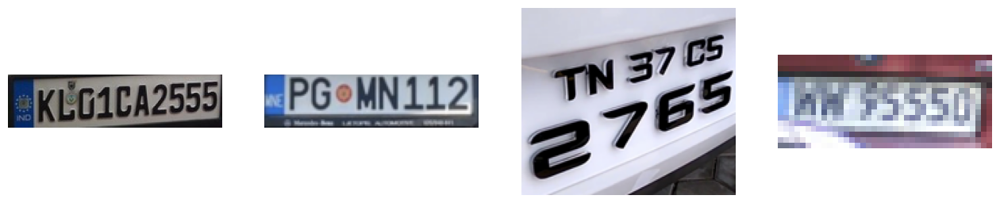

In [ ]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 4, figsize=(16, 4))
for i, image in enumerate(dataset[:4]["image"]):
    axs[i].imshow(image)
    axs[i].set_axis_off()
fig.show()

In [ ]:
from torchvision import transforms

preprocess = transforms.Compose(
    [
        transforms.Resize((config.image_size, config.image_size)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.5], [0.5]),
    ]
)

In [ ]:
def transform(examples):
    images = [preprocess(image.convert("RGB")) for image in examples["image"]]
    return {"images": images}

dataset.set_transform(transform)

C:\Users\shiva\AppData\Local\Temp\ipykernel_34464\948138263.py:5: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


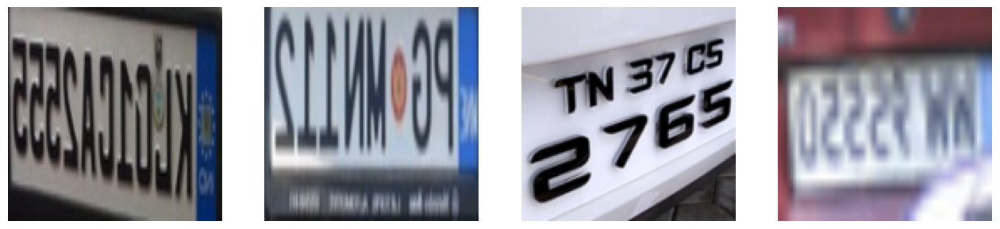

In [ ]:
fig, axs = plt.subplots(1, 4, figsize=(16, 4))
for i, image in enumerate(dataset[:4]["images"]):
    axs[i].imshow(image.permute(1, 2, 0).numpy() / 2 + 0.5)
    axs[i].set_axis_off()
fig.show()

In [ ]:
import torch

train_dataloader = torch.utils.data.DataLoader(dataset, batch_size=config.train_batch_size, shuffle=True)

#### Defining the diffusion model

Most diffusion models use architectures that are some variant of a U-net and that's what we'll use here.

<img src="https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/unet-model.png" width="600">


In [ ]:
from diffusers import UNet2DModel


model = UNet2DModel(
    sample_size=config.image_size,  # the target image resolution
    in_channels=3,  # the number of input channels, 3 for RGB images
    out_channels=3,  # the number of output channels
    layers_per_block=2,  # how many ResNet layers to use per UNet block
    block_out_channels=(128, 128, 256, 256, 512, 512),  # the number of output channes for each UNet block
    down_block_types=( 
        "DownBlock2D",  # a regular ResNet downsampling block
        "DownBlock2D", 
        "DownBlock2D", 
        "DownBlock2D", 
        "AttnDownBlock2D",  # a ResNet downsampling block with spatial self-attention
        "DownBlock2D",
    ), 
    up_block_types=(
        "UpBlock2D",  # a regular ResNet upsampling block
        "AttnUpBlock2D",  # a ResNet upsampling block with spatial self-attention
        "UpBlock2D", 
        "UpBlock2D", 
        "UpBlock2D", 
        "UpBlock2D"  
      ),
)

In [ ]:
sample_image = dataset[0]['images'].unsqueeze(0)
print('Input shape:', sample_image.shape)

Input shape: torch.Size([1, 3, 128, 128])


In [ ]:
print('Output shape:', model(sample_image, timestep=0).sample.shape)

Output shape: torch.Size([1, 3, 128, 128])


#### Defining the noise scheduler

Depending on the diffusion algorithm you want to use, the way images are noised is slightly different. That's why Diffusers contains different scheduler classes which each define the algorithm-specific diffusion steps. Here we are going to use the `DDPMScheduler` which corresponds to the training denoising and training algorithm proposed in [Denoising Diffusion Probabilistic Models](https://arxiv.org/abs/2006.11239).

In [ ]:
from diffusers import DDPMScheduler

noise_scheduler = DDPMScheduler(num_train_timesteps=1000)

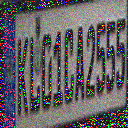

In [ ]:
import torch
from PIL import Image

noise = torch.randn(sample_image.shape)
timesteps = torch.LongTensor([50])
noisy_image = noise_scheduler.add_noise(sample_image, noise, timesteps)

Image.fromarray(((noisy_image.permute(0, 2, 3, 1) + 1.0) * 127.5).type(torch.uint8).numpy()[0])

In [ ]:
import torch.nn.functional as F

noise_pred = model(noisy_image, timesteps).sample
loss = F.mse_loss(noise_pred, noise)

#### Setting up the training

In [ ]:
optimizer = torch.optim.AdamW(model.parameters(), lr=config.learning_rate)

In [ ]:
from diffusers.optimization import get_cosine_schedule_with_warmup

lr_scheduler = get_cosine_schedule_with_warmup(
    optimizer=optimizer,
    num_warmup_steps=config.lr_warmup_steps,
    num_training_steps=(len(train_dataloader) * config.num_epochs),
)

In [ ]:
from diffusers import DDPMPipeline

import math

def make_grid(images, rows, cols):
    w, h = images[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, image in enumerate(images):
        grid.paste(image, box=(i%cols*w, i//cols*h))
    return grid

def evaluate(config, epoch, pipeline):
    # Sample some images from random noise (this is the backward diffusion process).
    # The default pipeline output type is `List[PIL.Image]`
    images = pipeline(
        batch_size = config.eval_batch_size, 
        generator=torch.manual_seed(config.seed),
    ).images

    # Make a grid out of the images
    image_grid = make_grid(images, rows=2, cols=2)

    # Save the images
    test_dir = os.path.join(config.output_dir, "samples")
    os.makedirs(test_dir, exist_ok=True)
    image_grid.save(f"{test_dir}/{epoch:04d}.png")

In [ ]:
from accelerate import Accelerator
from huggingface_hub import HfFolder, Repository, whoami

from tqdm.auto import tqdm
from pathlib import Path
import os

def get_full_repo_name(model_id: str, organization: str = None, token: str = None):
    if token is None:
        token = HfFolder.get_token()
    if organization is None:
        username = whoami(token)["name"]
        return f"{username}/{model_id}"
    else:
        return f"{organization}/{model_id}"

def train_loop(config, model, noise_scheduler, optimizer, train_dataloader, lr_scheduler):
    # Initialize accelerator and tensorboard logging
    accelerator = Accelerator(
        mixed_precision=config.mixed_precision,
        gradient_accumulation_steps=config.gradient_accumulation_steps, 
        log_with="tensorboard",
        logging_dir=os.path.join(config.output_dir, "logs")
    )
    if accelerator.is_main_process:
        if config.push_to_hub:
            repo_name = get_full_repo_name(Path(config.output_dir).name)
            repo = Repository(config.output_dir, clone_from=repo_name)
        elif config.output_dir is not None:
            os.makedirs(config.output_dir, exist_ok=True)
        accelerator.init_trackers("train_example")
    
    # Prepare everything
    # There is no specific order to remember, you just need to unpack the 
    # objects in the same order you gave them to the prepare method.
    model, optimizer, train_dataloader, lr_scheduler = accelerator.prepare(
        model, optimizer, train_dataloader, lr_scheduler
    )
    
    global_step = 0

    # Now you train the model
    for epoch in range(config.num_epochs):
        progress_bar = tqdm(total=len(train_dataloader), disable=not accelerator.is_local_main_process)
        progress_bar.set_description(f"Epoch {epoch}")

        for step, batch in enumerate(train_dataloader):
            clean_images = batch['images']
            # Sample noise to add to the images
            noise = torch.randn(clean_images.shape).to(clean_images.device)
            bs = clean_images.shape[0]

            # Sample a random timestep for each image
            timesteps = torch.randint(0, noise_scheduler.num_train_timesteps, (bs,), device=clean_images.device).long()

            # Add noise to the clean images according to the noise magnitude at each timestep
            # (this is the forward diffusion process)
            noisy_images = noise_scheduler.add_noise(clean_images, noise, timesteps)
            
            with accelerator.accumulate(model):
                # Predict the noise residual
                noise_pred = model(noisy_images, timesteps, return_dict=False)[0]
                loss = F.mse_loss(noise_pred, noise)
                accelerator.backward(loss)

                accelerator.clip_grad_norm_(model.parameters(), 1.0)
                optimizer.step()
                lr_scheduler.step()
                optimizer.zero_grad()
            
            progress_bar.update(1)
            logs = {"loss": loss.detach().item(), "lr": lr_scheduler.get_last_lr()[0], "step": global_step}
            progress_bar.set_postfix(**logs)
            accelerator.log(logs, step=global_step)
            global_step += 1

        # After each epoch you optionally sample some demo images with evaluate() and save the model
        if accelerator.is_main_process:
            pipeline = DDPMPipeline(unet=accelerator.unwrap_model(model), scheduler=noise_scheduler)

            if (epoch + 1) % config.save_image_epochs == 0 or epoch == config.num_epochs - 1:
                evaluate(config, epoch, pipeline)

            if (epoch + 1) % config.save_model_epochs == 0 or epoch == config.num_epochs - 1:
                if config.push_to_hub:
                    repo.push_to_hub(commit_message=f"Epoch {epoch}", blocking=True)
                else:
                    pipeline.save_pretrained(config.output_dir) 

#### Training the model

In [ ]:
from accelerate import notebook_launcher
args = (config, model, noise_scheduler, optimizer, train_dataloader, lr_scheduler)

notebook_launcher(train_loop, args, num_processes=1)

#### Results

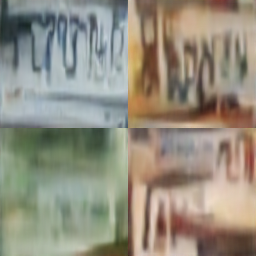

In [ ]:
import glob

sample_images = sorted(glob.glob(f"{config.output_dir}/samples/*.png"))
Image.open(sample_images[-1])

#### Observations

- The model is able to generate license plates (kind-off) but text is not readable.
- Training the model for more epochs would result in better results.
- Hyper-parameters like learning rate, batch size, etc. can be tuned to get better results.
- More tuning isn't possible due to the limited resources available.